<a href="https://colab.research.google.com/github/Nilesh-Singhal/Force_2020_Classification/blob/main/FORCE_2020_Final_Code_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install pycaret==2.0
!pip install shap

     |████████████████████████████████| 256kB 5.7MB/s 
     |████████████████████████████████| 266kB 33.6MB/s 
     |████████████████████████████████| 1.6MB 17.3MB/s 
     |████████████████████████████████| 66.3MB 52kB/s 
     |████████████████████████████████| 61kB 10.0MB/s 
     |████████████████████████████████| 6.8MB 53.1MB/s 
     |████████████████████████████████| 1.8MB 52.7MB/s 
     |████████████████████████████████| 276kB 55.2MB/s 
     |████████████████████████████████| 13.9MB 357kB/s 
     |████████████████████████████████| 102kB 14.2MB/s 
     |████████████████████████████████| 71kB 10.2MB/s 
     |████████████████████████████████| 71kB 11.3MB/s 
     |████████████████████████████████| 604kB 45.6MB/s 
     |████████████████████████████████| 3.1MB 44.7MB/s 
     |████████████████████████████████| 245kB 59.5MB/s 
     |████████████████████████████████| 1.1MB 55.7MB/s 
     |████████████████████████████████| 153kB 55.8MB/s 
     |████████████████████████████████| 163kB 59.9MB/

In [ ]:
import os.path
import plotly.express as px
import numpy as np
import pandas as pd
import pickle
import missingno as msno
import seaborn as sns
import matplotlib.colors as colors
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples, calinski_harabasz_score
from sklearn.preprocessing import OneHotEncoder
from sklearn import mixture
import matplotlib.cm as cm
from matplotlib.patches import Ellipse
from mpl_toolkits.axes_grid1 import make_axes_locatable
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.utils import shuffle
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt

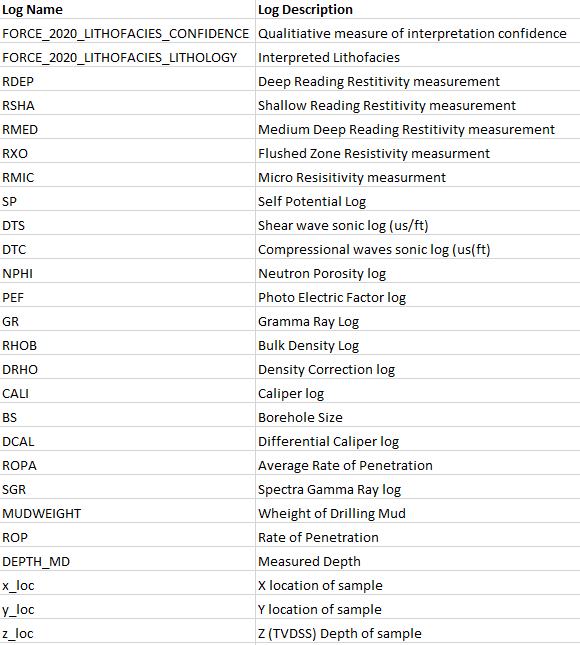

# **Training Data**

In [ ]:
data = pd.read_csv('/content/drive/My Drive/Colab Notebooks/force2020_train.csv', sep=';')
wells = data['WELL'].unique()

In [ ]:
data.head()

,WELL,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,GROUP,FORMATION,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,PEF,DTC,SP,BS,ROP,DTS,DCAL,DRHO,MUDWEIGHT,RMIC,ROPA,RXO,FORCE_2020_LITHOFACIES_LITHOLOGY,FORCE_2020_LITHOFACIES_CONFIDENCE
0,15/9-13,494.528,437641.96875,6470972.5,-469.501831,NORDLAND GP.,NaN,19.480835,NaN,1.611410,1.798681,1.884186,80.200851,NaN,NaN,20.915468,161.131180,24.612379,NaN,34.636410,NaN,NaN,-0.574928,NaN,NaN,NaN,NaN,65000,1.0
1,15/9-13,494.680,437641.96875,6470972.5,-469.653809,NORDLAND GP.,NaN,19.468800,NaN,1.618070,1.795641,1.889794,79.262886,NaN,NaN,19.383013,160.603470,23.895531,NaN,34.636410,NaN,NaN,-0.570188,NaN,NaN,NaN,NaN,65000,1.0
2,15/9-13,494.832,437641.96875,6470972.5,-469.805786,NORDLAND GP.,NaN,19.468800,NaN,1.626459,1.800733,1.896523,74.821999,NaN,NaN,22.591518,160.173615,23.916357,NaN,34.779556,NaN,NaN,-0.574245,NaN,NaN,NaN,NaN,65000,1.0
3,15/9-13,494.984,437641.96875,6470972.5,-469.957794,NORDLAND GP.,NaN,19.459282,NaN,1.621594,1.801517,1.891913,72.878922,NaN,NaN,32.191910,160.149429,23.793688,NaN,39.965164,NaN,NaN,-0.586315,NaN,NaN,NaN,NaN,65000,1.0
4,15/9-13,495.136,437641.96875,6470972.5,-470.109772,NORDLAND GP.,NaN,19.453100,NaN,1.602679,1.795299,1.880034,71.729141,NaN,NaN,38.495632,160.128342,24.104078,NaN,57.483765,NaN,NaN,-0.597914,NaN,NaN,NaN,NaN,65000,1.0


In [ ]:
data.isna().sum()

WELL                                       0
DEPTH_MD                                   0
X_LOC                                  10775
Y_LOC                                  10775
Z_LOC                                  10775
GROUP                                   1278
FORMATION                             136994
CALI                                   87877
RSHA                                  539861
RMED                                   38993
RDEP                                   11015
RHOB                                  161269
GR                                         0
SGR                                  1101158
NPHI                                  405102
PEF                                   498819
DTC                                    80863
SP                                    306264
BS                                    487854
ROP                                   635440
DTS                                   995898
DCAL                                  871678
DRHO      

# **Test Data**

In [ ]:
test_data = pd.read_csv('/content/drive/My Drive/Colab Notebooks/force2020_test.csv', sep=';')
test_well_names = test_data['WELL'].unique()

In [ ]:
test_data.isna().sum()

WELL              0
DEPTH_MD          0
X_LOC            59
Y_LOC            59
Z_LOC            59
GROUP             0
FORMATION      7074
CALI           5645
RSHA          97689
RMED            587
RDEP             59
RHOB          16960
GR                0
SGR          136786
NPHI          32743
PEF           23283
DTC             823
SP            70159
BS            69822
ROP           68470
DTS           93566
DCAL         123271
DRHO          25230
MUDWEIGHT    116517
RMIC         125470
ROPA          80996
RXO          106938
dtype: int64

In [ ]:
all_well_names = np.concatenate((wells, test_well_names))
# need this array in a DataFrame for a merge operation below
well_names_df = pd.DataFrame({'WELL':all_well_names})
well_names_df

,WELL
0,15/9-13
1,15/9-15
2,15/9-17
3,16/1-2
4,16/1-6 A
...,...
103,34/10-16 R
104,34/3-3 A
105,34/6-1 S
106,35/6-2 S


# **Loading metadata for the dataset**

In [ ]:
# location of the meta data csv on your machine 
well_meta_csv = '/content/drive/My Drive/Colab Notebooks/wellbore_exploration_all.csv'
well_meta_df = pd.read_csv(well_meta_csv)
well_meta_df.head()

,wlbWellboreName,wlbWell,wlbDrillingOperator,wlbProductionLicence,wlbPurpose,wlbStatus,wlbContent,wlbWellType,wlbSubSea,wlbEntryDate,wlbCompletionDate,wlbField,wlbDrillPermit,wlbDiscovery,wlbDiscoveryWellbore,wlbBottomHoleTemperature,wlbSiteSurvey,wlbSeismicLocation,wlbMaxInclation,wlbKellyBushElevation,wlbFinalVerticalDepth,wlbTotalDepth,wlbWaterDepth,wlbKickOffPoint,wlbAgeAtTd,wlbFormationAtTd,wlbMainArea,wlbDrillingFacility,wlbFacilityTypeDrilling,wlbDrillingFacilityFixedOrMoveable,wlbLicensingActivity,wlbMultilateral,wlbPurposePlanned,wlbEntryYear,wlbCompletionYear,wlbReclassFromWellbore,wlbReentryExplorationActivity,wlbPlotSymbol,wlbFormationWithHc1,wlbAgeWithHc1,wlbFormationWithHc2,wlbAgeWithHc2,wlbFormationWithHc3,wlbAgeWithHc3,wlbDrillingDays,wlbReentry,wlbLicenceTargetName,wlbPluggedAbandonDate,wlbPluggedDate,wlbGeodeticDatum,wlbNsDeg,wlbNsMin,wlbNsSec,wlbNsCode,wlbEwDeg,wlbEwMin,wlbEwSec,wlbEwCode,wlbNsDecDeg,wlbEwDesDeg,wlbNsUtm,wlbEwUtm,wlbUtmZone,wlbNamePart1,wlbNamePart2,wlbNamePart3,wlbNamePart4,wlbNamePart5,wlbNamePart6,wlbPressReleaseUrl,wlbFactPageUrl,wlbFactMapUrl,wlbDiskosWellboreType,wlbDiskosWellboreParent,wlbWdssQcDate,wlbReleasedDate,wlbDateReclass,wlbNpdidWellbore,dscNpdidDiscovery,fldNpdidField,fclNpdidFacilityDrilling,wlbNpdidWellboreReclass,prlNpdidProductionLicence,wlbNpdidSiteSurvey,wlbDateUpdated,wlbDateUpdatedMax,datesyncNPD
0,1/2-1,1/2-1,Phillips Petroleum Norsk AS,143,WILDCAT,P&A,OIL,EXPLORATION,NO,20.03.1989,04.06.1989,BLANE,604-L,1/2-1 Blane,YES,147.0,NaN,PW 8303A - 10 SP. 290,2.0,22.0,NaN,3574.0,72.0,NaN,CAMPANIAN,TOR FM,NORTH SEA,ROSS ISLE,SEMISUB STEEL,MOVEABLE,12,NO,WILDCAT,1989,1989,NaN,NaN,5,FORTIES FM,PALEOCENE,NaN,NaN,,,77,NO,NaN,NaN,NaN,ED50,56,53,15.07,N,2,28,35.70,E,56.887519,2.476583,6305128.26,468106.29,31,1,2,,1,NaN,NaN,,https://factpages.npd.no/factpages/default.asp...,https://factmaps.npd.no/factmaps/3_0/?run=Well...,initial,,19.12.2007,04.06.1991,NaN,1382,43814.0,3437650.0,296245.0,0,21956.0,NaN,03.10.2019,10.03.2020,15.09.2020
1,1/2-2,1/2-2,Paladin Resources Norge AS,143 CS,WILDCAT,P&A,OIL SHOWS,EXPLORATION,NO,14.12.2005,02.02.2006,NaN,1103-L,NaN,NO,138.0,NaN,inline 7429-trace 4824 Survey PGS CGMNOR,4.9,40.0,3432.0,3434.0,74.0,NaN,PALEOCENE,EKOFISK FM,NORTH SEA,MÆRSK GIANT,JACK-UP 3 LEGS,MOVEABLE,12,NO,WILDCAT,2005,2006,NaN,NaN,12,NaN,NaN,NaN,NaN,,,51,NO,NaN,NaN,NaN,ED50,56,59,32.00,N,2,29,47.66,E,56.992222,2.496572,6316774.33,469410.10,31,1,2,,2,NaN,NaN,https://www.npd.no/fakta/nyheter/Resultat-av-l...,https://factpages.npd.no/factpages/default.asp...,https://factmaps.npd.no/factmaps/3_0/?run=Well...,initial,,15.08.2008,02.02.2008,NaN,5192,NaN,NaN,278245.0,0,2424919.0,NaN,03.10.2019,03.10.2019,15.09.2020
2,1/3-1,1/3-1,A/S Norske Shell,011,WILDCAT,P&A,GAS,EXPLORATION,NO,06.07.1968,11.11.1968,NaN,15-L,1/3-1,YES,182.0,NaN,LINE 5651 SP. E165,18.0,26.0,NaN,4877.0,71.0,NaN,LATE PERMIAN,ZECHSTEIN GP,NORTH SEA,ORION,JACK-UP 3 LEGS,MOVEABLE,1-A,NO,WILDCAT,1968,1968,NaN,NaN,9,TOR FM,LATE CRETACEOUS,CROMER KNOLL GP,EARLY CRETACEOUS,,,129,NO,NaN,NaN,NaN,ED50,56,51,21.00,N,2,51,5.00,E,56.855833,2.851389,6301488.86,490936.87,31,1,3,,1,NaN,NaN,,https://factpages.npd.no/factpages/default.asp...,https://factmaps.npd.no/factmaps/3_0/?run=Well...,initial,,30.04.2010,11.11.1970,NaN,154,43820.0,NaN,288604.0,0,20844.0,NaN,03.10.2019,10.03.2020,15.09.2020
3,1/3-2,1/3-2,A/S Norske Shell,011,WILDCAT,P&A,DRY,EXPLORATION,NO,14.05.1969,27.07.1969,NaN,26-L,NaN,NO,143.0,NaN,LINE 5656 SP.5125,0.0,26.0,NaN,4297.0,73.0,NaN,EARLY CRETACEOUS,SOLA FM,NORTH SEA,SEDNETH I,SEMISUB STEEL,MOVEABLE,1-A,NO,WILDCAT,1969,1969,NaN,NaN,1,NaN,NaN,NaN,NaN,,,75,NO,NaN,NaN,NaN,ED50,56,56,10.00,N,2,45,0.00,E,56.936111,2.750000,6310443.20,484786.28,31,1,3,,2,NaN,NaN,,https://factpages.npd.no/factpages/default.asp...,https://factmaps.npd.no/factmaps/3_0/?run=Well...,initial,,30.04.2010,27.07.1971,NaN,165,NaN,NaN,288847.0,0,20844.0,NaN,03.10.2019,10.03.2020,15.09.2020
4,1/3-3,1/3-3,Elf Petroleum Norge AS,065,WILDCAT,P&A,OIL,EX

In [ ]:
# rename the columns so they are more readable
well_meta_df.rename(columns={'wlbWellboreName': 'WELL',
                             'wlbWell': 'WELL_HEAD',
                            'wlbNsDecDeg': 'lat',
                            'wlbEwDesDeg': 'lon',
                            'wlbDrillingOperator': 'Drilling Operator',
                            'wlbPurposePlanned': 'Purpose',
                            'wlbCompletionYear': 'Completion Year',
                            'wlbFormationAtTd': 'Formation'}, inplace=True)

# get df of WELL_HEAD and the lat long
well_locations_df = well_meta_df[['WELL_HEAD', 'lat', 'lon']].drop_duplicates(subset=['WELL_HEAD'])

# we only need a few of the columns for the map plot
well_meta_df = well_meta_df[['WELL','Drilling Operator',
                            'Purpose','Completion Year', 'Formation']]

well_locations_df

,WELL_HEAD,lat,lon
0,1/2-1,56.887519,2.476583
1,1/2-2,56.992222,2.496572
2,1/3-1,56.855833,2.851389
3,1/3-2,56.936111,2.750000
4,1/3-3,56.952378,2.981681
...,...,...,...
1948,7324/10-1,73.163736,24.313228
1949,7325/1-1,73.913528,25.116714
1950,7325/4-1,73.649319,25.178261
1951,7335/3-1,73.997183,35.837147


In [ ]:
def base_well_name(row):
    
    well_name = row['WELL']
    
    return well_name.split()[0]

# apply the function to extract the WELL_HEAD base name from the well
well_names_df['WELL_HEAD'] = well_names_df.apply(lambda row: base_well_name(row), axis=1)

# merge with location data to get lat/lon
locations_df = well_names_df.merge(well_locations_df, how='inner', on='WELL_HEAD')
# merge with the meta data to get other data
locations_df = locations_df.merge(well_meta_df, how='left', on='WELL')
locations_df

,WELL,WELL_HEAD,lat,lon,Drilling Operator,Purpose,Completion Year,Formation
0,15/9-13,15/9-13,58.373878,1.934128,Den norske stats oljeselskap a.s,APPRAISAL,1982.0,ZECHSTEIN GP
1,15/9-15,15/9-15,58.302069,1.922131,Den norske stats oljeselskap a.s,WILDCAT,1982.0,SKAGERRAK FM
2,15/9-17,15/9-17,58.445608,1.948217,Den norske stats oljeselskap a.s,WILDCAT,1983.0,SMITH BANK FM
3,16/1-2,16/1-2,58.935894,2.222239,Esso Exploration and Production Norway A/S,APPRAISAL,1976.0,BASEMENT
4,16/1-6 A,16/1-6,58.991097,2.295297,Statoil ASA (old),WILDCAT,2003.0,TOR FM
...,...,...,...,...,...,...,...,...
103,34/10-16 R,34/10-16,61.093228,2.179628,Den norske stats oljeselskap a.s,APPRAISAL,1983.0,LUNDE FM
104,34/3-3 A,34/3-3,61.795136,2.717883,BG Norge AS,APPRAISAL,2012.0,BURTON FM
105,34/6-1 S,34/6-1,61.582317,2.685472,Norske Conoco A/S,WILDCAT,2002.0,LUNDE FM
106,35/6-2 S,35/6-2,61.533606,3.911311,StatoilHydro Petroleum AS,WILDCAT,2009.0,NO FORMAL NAME


In [ ]:
locations_df.loc[locations_df['WELL'].isin(wells), 'Dataset'] = 'Train'
locations_df.loc[locations_df['WELL'].isin(test_well_names), 'Dataset'] = 'Test'

# save the location and meta data for future use.
#locations_df.to_csv('/content/drive/My Drive/Colab Notebooks/force_2020_meta.csv', index=False)

In [ ]:
locations_df

,WELL,WELL_HEAD,lat,lon,Drilling Operator,Purpose,Completion Year,Formation,Dataset
0,15/9-13,15/9-13,58.373878,1.934128,Den norske stats oljeselskap a.s,APPRAISAL,1982.0,ZECHSTEIN GP,Train
1,15/9-15,15/9-15,58.302069,1.922131,Den norske stats oljeselskap a.s,WILDCAT,1982.0,SKAGERRAK FM,Train
2,15/9-17,15/9-17,58.445608,1.948217,Den norske stats oljeselskap a.s,WILDCAT,1983.0,SMITH BANK FM,Train
3,16/1-2,16/1-2,58.935894,2.222239,Esso Exploration and Production Norway A/S,APPRAISAL,1976.0,BASEMENT,Train
4,16/1-6 A,16/1-6,58.991097,2.295297,Statoil ASA (old),WILDCAT,2003.0,TOR FM,Train
...,...,...,...,...,...,...,...,...,...
103,34/10-16 R,34/10-16,61.093228,2.179628,Den norske stats oljeselskap a.s,APPRAISAL,1983.0,LUNDE FM,Test
104,34/3-3 A,34/3-3,61.795136,2.717883,BG Norge AS,APPRAISAL,2012.0,BURTON FM,Test
105,34/6-1 S,34/6-1,61.582317,2.685472,Norske Conoco A/S,WILDCAT,2002.0,LUNDE FM,Test
106,35/6-2 S,35/6-2,61.533606,3.911311,StatoilHydro Petroleum AS,WILDCAT,2009.0,NO FORMAL NAME,Test


In [ ]:
fig = px.scatter_mapbox(locations_df, lat="lat", lon="lon",
                        color='Dataset', 
                        zoom=5, height=600)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":200,"t":20,"l":200,"b":0})
fig.show()

# **Inspecting available logs and interpretations**

The data contains the metadata columns
* WELL: well name
* DEPTH_MD: measured depth
* X_LOC: UTM X coordinate 
* Y_LOC: UTM Y coordinate
* Z_LOC: DEPTH
* GROUP: NPD lithostratigraphy group
* FORMATION: NPD lithostratgraphy formation

The data contains the well log curves. For example the following:
* BS: Bit Size
* CALI: Caliper
* RDEP: Deep Resistivity
* RHOB: Bulk Density
* GR: Raw gamma data
* SGR: Spectral Gamma Ray
* RMED: Medium Resistivity
* ROP: Rate of Penetration
* NPHI: Neutron Porosity
* PEF: Photoelectric Absorption Factor
* RSHA: Shallow Resistivity
* DTS: Sonic (Sheer Slowness)
* DTC: Sonic (Compressional Slowness)

See contest page for full list.

as well as the interpretation

* FORCE_2020_LITHOFACIES_LITHOLOGY: lithology class label
* FORCE_2020_LITHOFACIES_CONFIDENCE: confidence in lithology interpretation (1: high, 2: medium, 3: low)

In [ ]:
wells = data['WELL'].unique()

In [ ]:
wells

array(['15/9-13', '15/9-15', '15/9-17', '16/1-2', '16/1-6 A', '16/10-1',
       '16/10-2', '16/10-3', '16/10-5', '16/11-1 ST3', '16/2-11 A',
       '16/2-16', '16/2-6', '16/4-1', '16/5-3', '16/7-4', '16/7-5',
       '16/8-1', '17/11-1', '25/11-15', '25/11-19 S', '25/11-5',
       '25/2-13 T4', '25/2-14', '25/2-7', '25/3-1', '25/4-5', '25/5-1',
       '25/5-4', '25/6-1', '25/6-2', '25/6-3', '25/7-2', '25/8-5 S',
       '25/8-7', '25/9-1', '26/4-1', '29/6-1', '30/3-3', '30/3-5 S',
       '30/6-5', '31/2-1', '31/2-19 S', '31/2-7', '31/2-8', '31/2-9',
       '31/3-1', '31/3-2', '31/3-3', '31/3-4', '31/4-10', '31/4-5',
       '31/5-4 S', '31/6-5', '31/6-8', '32/2-1', '33/5-2', '33/6-3 S',
       '33/9-1', '33/9-17', '34/10-19', '34/10-21', '34/10-33',
       '34/10-35', '34/11-1', '34/11-2 S', '34/12-1', '34/2-4',
       '34/3-1 A', '34/4-10 R', '34/5-1 A', '34/5-1 S', '34/7-13',
       '34/7-20', '34/7-21', '34/8-1', '34/8-3', '34/8-7 R', '35/11-1',
       '35/11-10', '35/11-11', '35/11-12

In [ ]:
len(wells)

98

In [ ]:
lithology_keys = {30000: 'Sandstone',
                 65030: 'Sandstone/Shale',
                 65000: 'Shale',
                 80000: 'Marl',
                 74000: 'Dolomite',
                 70000: 'Limestone',
                 70032: 'Chalk',
                 88000: 'Halite',
                 86000: 'Anhydrite',
                 99000: 'Tuff',
                 90000: 'Coal',
                 93000: 'Basement'}

In [ ]:
data['FORCE_2020_LITHOFACIES_LITHOLOGY'].unique()

array([65000, 30000, 65030, 70000, 99000, 80000, 86000, 74000, 70032,
       90000, 88000, 93000])

Text(0, 0.5, 'Lithology presence (\\%)')

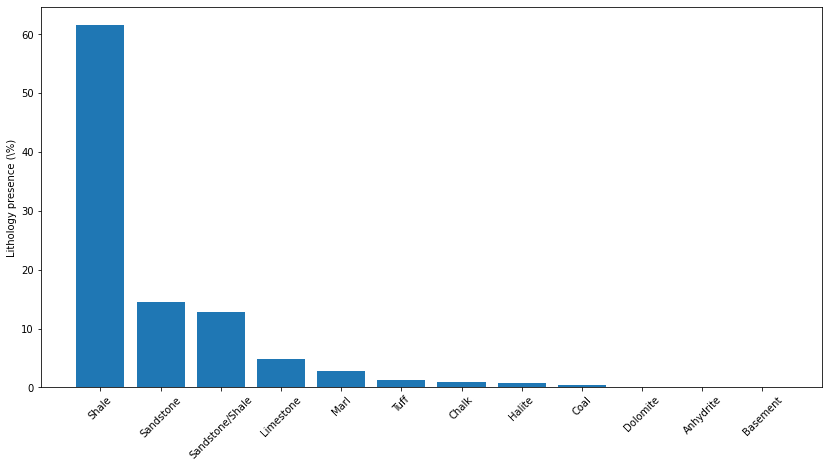

In [ ]:
counts = data['FORCE_2020_LITHOFACIES_LITHOLOGY'].value_counts()
names = []
percentage = []
N = data['FORCE_2020_LITHOFACIES_LITHOLOGY'].shape[0]
for item in counts.iteritems():
    names.append(lithology_keys[item[0]])
    percentage.append(float(item[1])/N*100)
fig, ax = plt.subplots(1, 1, figsize=(14, 7))
ax.bar(x=np.arange(len(names)), height=percentage)
ax.set_xticklabels(names, rotation=45)
ax.set_xticks(np.arange(len(names)))
ax.set_ylabel('Lithology presence (\%)')

In [ ]:
data.isna().sum()

WELL                                       0
DEPTH_MD                                   0
X_LOC                                  10775
Y_LOC                                  10775
Z_LOC                                  10775
GROUP                                   1278
FORMATION                             136994
CALI                                   87877
RSHA                                  539861
RMED                                   38993
RDEP                                   11015
RHOB                                  161269
GR                                         0
SGR                                  1101158
NPHI                                  405102
PEF                                   498819
DTC                                    80863
SP                                    306264
BS                                    487854
ROP                                   635440
DTS                                   995898
DCAL                                  871678
DRHO      

# **NaN Values**

## **Visual 1** **(whole dataset)**

Text(0, 0.5, 'Well presence (\\%)')

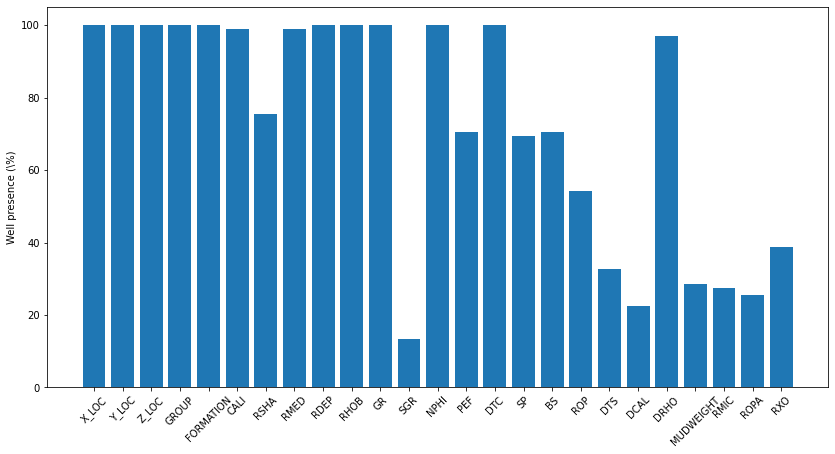

In [ ]:
occurences = np.zeros(25)
for well in data['WELL'].unique():
    occurences += data[data['WELL'] == well].isna().all().astype(int).values[2:-2]
fig, ax = plt.subplots(1, 1, figsize=(14, 7))
ax.bar(x=np.arange(occurences.shape[0]), height=(data.WELL.unique().shape[0]-occurences)/data.WELL.unique().shape[0]*100.0)
ax.set_xticklabels(data.columns[2:-2], rotation=45)
ax.set_xticks(np.arange(occurences.shape[0]))
ax.set_ylabel('Well presence (\%)')

## **Visual 2** **(Whole Dataset)**

**Visual summary plot of the dataset completion, log by log (all wells together)**

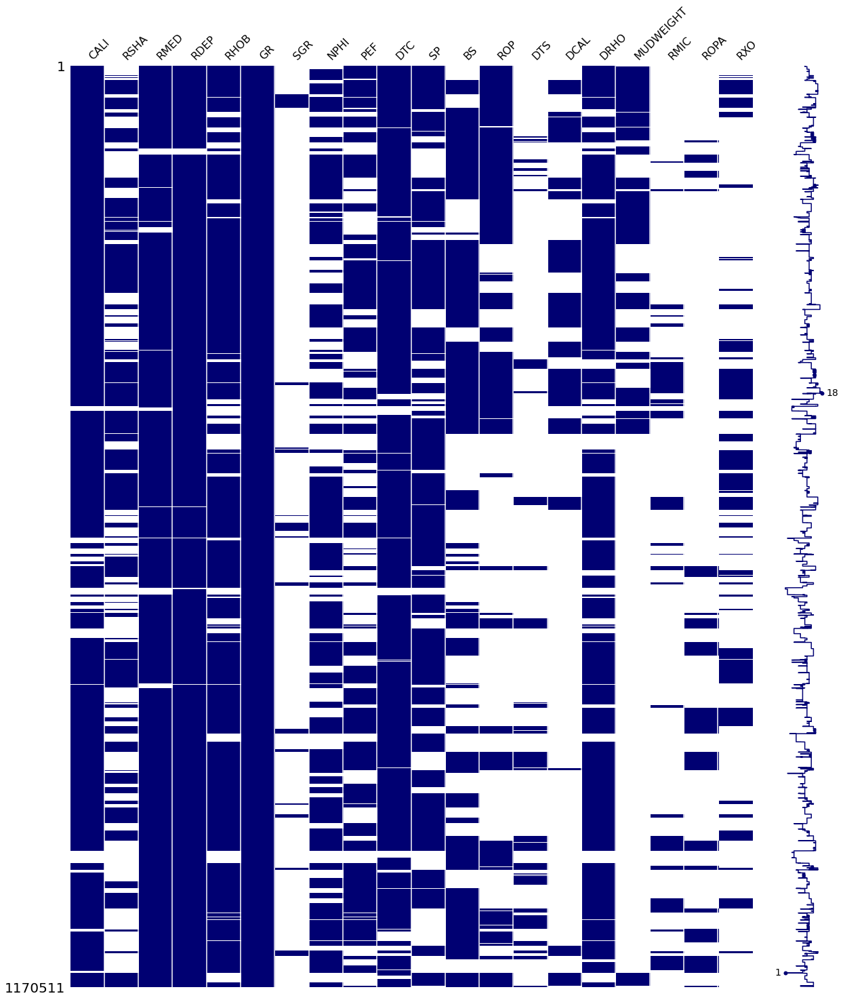

In [ ]:
w = data.drop(['WELL', 'DEPTH_MD','X_LOC','Y_LOC','Z_LOC','GROUP','FORMATION',
                       'FORCE_2020_LITHOFACIES_LITHOLOGY','FORCE_2020_LITHOFACIES_CONFIDENCE'], 
                      axis=1)
msno.matrix(w, color=(0., 0., 0.45))   
fig = plt.gcf()
fig.set_size_inches(20, 25)
plt.show()

## **Visual 3 (Dendrogram whole dataset)**

**To explore in more depth the data completion, below I am also adding below missingno 's dendrogram plot.**

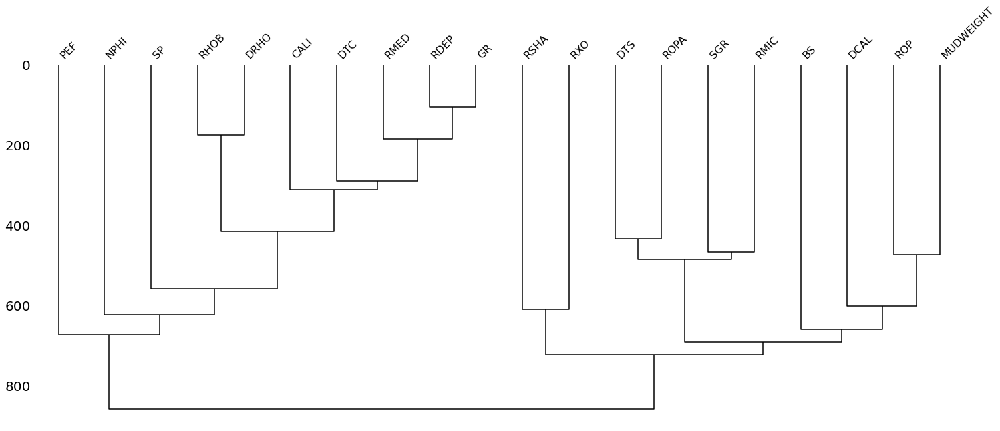

In [ ]:
msno.dendrogram(data.drop(['WELL', 'DEPTH_MD','X_LOC','Y_LOC','Z_LOC','GROUP','FORMATION',
                         'FORCE_2020_LITHOFACIES_LITHOLOGY','FORCE_2020_LITHOFACIES_CONFIDENCE'], axis=1));

## **Visual 4 (Interactive Visualization (Well Wise)**

https://github.com/brendonhall/FORCE-2020-Lithology/blob/master/notebooks/01-Log-Plot-MPL.ipynb


In [ ]:
# map of lithology codes to integer label for ML
lithology_numbers = {30000: 0,
             65030: 1,
             65000: 2,
             80000: 3,
             74000: 4,
             70000: 5,
             70032: 6,
             88000: 7,
             86000: 8,
             99000: 9,
             90000: 10,
             93000: 11}
    
def map_lith_key(lith_map, row):
    
    lith_key = row['FORCE_2020_LITHOFACIES_LITHOLOGY']
    
    if lith_key in lith_map:
        return lith_map[lith_key]
    else:
        print('Warning: Key {} not found in map'.format(lith_key))
        return np.nan

data['LITHOLOGY'] = data.apply (lambda row: map_lith_key(lithology_keys, row), axis=1)
data['LITH_LABEL'] = data.apply (lambda row: map_lith_key(lithology_numbers, row), axis=1)

In [ ]:
data[['FORCE_2020_LITHOFACIES_LITHOLOGY', 'LITHOLOGY', 'LITH_LABEL']]

,FORCE_2020_LITHOFACIES_LITHOLOGY,LITHOLOGY,LITH_LABEL
0,65000,Shale,2
1,65000,Shale,2
2,65000,Shale,2
3,65000,Shale,2
4,65000,Shale,2
...,...,...,...
1170506,30000,Sandstone,0
1170507,65030,Sandstone/Shale,1
1170508,65030,Sandstone/Shale,1
1170509,65030,Sandstone/Shale,1


In [ ]:
facies_color_map = { 'Sandstone': '#F4D03F',
                     'Sandstone/Shale': '#7ccc19',
                     'Shale': '#196F3D',
                     'Marl': '#160599',
                     'Dolomite': '#2756c4',
                     'Limestone': '#3891f0',
                     'Chalk': '#80d4ff',
                     'Halite': '#87039e',
                     'Anhydrite': '#ec90fc',
                     'Tuff': '#FF4500',
                     'Coal': '#000000',
                     'Basement': '#DC7633'}

# get a list of the color codes.
facies_colors = [facies_color_map[mykey] for mykey in facies_color_map.keys()]

In [ ]:
def make_facies_log_plot(log_df, curves, facies_colors):
    
    #make sure logs are sorted by depth
    logs = log_df.sort_values(by='DEPTH_MD')
    cmap_facies = colors.ListedColormap(
            facies_colors[0:len(facies_colors)], 'indexed')
    
    ztop=logs.DEPTH_MD.min(); zbot=logs.DEPTH_MD.max()
    
    cluster=np.repeat(np.expand_dims(logs['LITH_LABEL'].values,1), 100, 1)
    
    num_curves = len(curves)
    f, ax = plt.subplots(nrows=1, ncols=num_curves+1, figsize=(num_curves*2, 12))
    
    for ic, col in enumerate(curves):
        
        # if the curve doesn't exist, make it zeros
        if np.all(np.isnan(logs[col])):
            curve = np.empty(logs[col].values.shape)
            curve[:] = np.nan
            
        else:
            curve = logs[col]
            
        ax[ic].plot(curve, logs['DEPTH_MD'])
        ax[ic].set_xlabel(col)
        ax[ic].set_yticklabels([]);

    # make the lithfacies column
    im=ax[num_curves].imshow(cluster, interpolation='none', aspect='auto',
                    cmap=cmap_facies,vmin=0,vmax=11)
    
    divider = make_axes_locatable(ax[num_curves])
    cax = divider.append_axes("right", size="20%", pad=0.05)
    cbar=plt.colorbar(im, cax=cax)
    cbar.set_label((12*' ').join(['  SS', 'SS-Sh', 'Sh', 
                                ' Ml', 'Dm', 'LS', 'Chk ', 
                                '  Hl', 'Ann', 'Tuf', 'Coal', 'Bsmt']))
    cbar.set_ticks(range(0,1)); cbar.set_ticklabels('')
    
    for i in range(len(ax)-1):
        ax[i].set_ylim(ztop,zbot)
        ax[i].invert_yaxis()
        ax[i].grid()
        ax[i].locator_params(axis='x', nbins=3)

    ax[num_curves].set_xlabel('Facies')
    ax[num_curves].set_yticklabels([])
    ax[num_curves].set_xticklabels([])
    
    f.suptitle('Well: %s'%logs.iloc[0]['WELL'], fontsize=14,y=0.94)
    
    plt.show()

In [ ]:
import ipywidgets as widgets
from ipywidgets import interactive, interact

columns = ['CALI', 'RSHA', 'RMED', 'RDEP', 'RHOB', 'GR', 'SGR',
           'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP', 'DTS', 'DCAL', 'DRHO',
           'MUDWEIGHT', 'RMIC', 'ROPA', 'RXO']

plot_output = widgets.Output()

dropdown_well = widgets.Dropdown(options = data['WELL'].unique(), description='Well:', value='15/9-13')

select_curves = widgets.SelectMultiple(
    options=columns,
    value=columns,
    #rows=10,
    description='Curves:',
    disabled=False
)

plot_button = widgets.Button(
    description='Show well plot',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='Click to plot well.'
)
        
def on_button_clicked(b):
    plot_output.clear_output()
    with plot_output:
        make_facies_log_plot(
            data[data['WELL'] == dropdown_well.value],
            select_curves.value,
            facies_colors)
        
plot_button.on_click(on_button_clicked)

display(dropdown_well)
display(select_curves)
display(plot_button)
display(plot_output)



Dropdown(description='Well:', options=('15/9-13', '15/9-15', '15/9-17', '16/1-2', '16/1-6 A', '16/10-1', '16/1…

SelectMultiple(description='Curves:', index=(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18,…

Button(description='Show well plot', style=ButtonStyle(), tooltip='Click to plot well.')

Output()

In [ ]:
well_items = data['WELL'].unique()

In [ ]:
def plot_missingno(w):  
    msno.matrix(w, color=(0., 0., 0.45))   
    fig = plt.gcf()
    fig.set_size_inches(20, np.round(len(w)/750)) # plot heigth proportional to selected well's length (in rows)
    plt.show()
    
def data_missingno_view(WELL=''):
    return plot_missingno(data.loc[data['WELL']==WELL])

well_select = widgets.Select(options=well_items)
interactive(data_missingno_view, WELL=well_select)

interactive(children=(Select(description='WELL', options=('15/9-13', '15/9-15', '15/9-17', '16/1-2', '16/1-6 A…

# **Interpolated Data (Scatter Plot) (Don't run)**

## **Visual 1**

In [ ]:
X = data.copy()
X['LITH_LABEL1'] = X.LITH_LABEL

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distribu

CPU times: user 45min 23s, sys: 23.9 s, total: 45min 47s
Wall time: 45min 23s


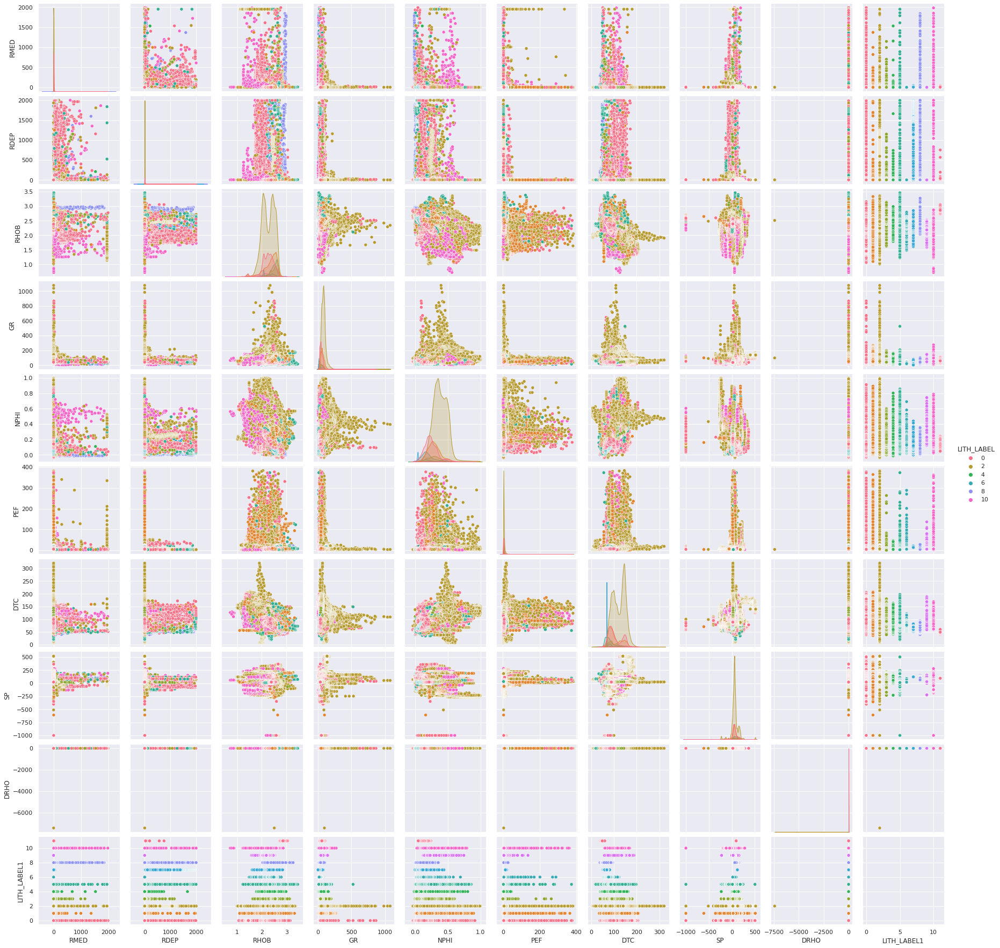

In [ ]:
# Dropping all the features which are on right side of the dendrogram
# Paired plot using seaborn
%%time
sns.set()
sns.pairplot(X[[ 'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF','DTC', 'SP', 'DRHO','LITH_LABEL1','LITH_LABEL']],
             hue="LITH_LABEL", palette='husl')

# **Despiking most of the logs**

## **Visual Inspection (Before)**

In [ ]:
import ipywidgets as widgets
from ipywidgets import interactive, interact

columns = ['CALI', 'RSHA', 'RMED', 'RDEP', 'RHOB', 'GR', 'SGR',
           'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP', 'DTS', 'DCAL', 'DRHO',
           'MUDWEIGHT', 'RMIC', 'ROPA', 'RXO']

plot_output = widgets.Output()

dropdown_well = widgets.Dropdown(options = data['WELL'].unique(), description='Well:', value='15/9-13')

select_curves = widgets.SelectMultiple(
    options=columns,
    value=columns,
    #rows=10,
    description='Curves:',
    disabled=False
)

plot_button = widgets.Button(
    description='Show well plot',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='Click to plot well.'
)
        
def on_button_clicked(b):
    plot_output.clear_output()
    with plot_output:
        make_facies_log_plot(
            data[data['WELL'] == dropdown_well.value],
            select_curves.value,
            facies_colors)
        
plot_button.on_click(on_button_clicked)

display(dropdown_well)
display(select_curves)
display(plot_button)
display(plot_output)

Dropdown(description='Well:', options=('15/9-13', '15/9-15', '15/9-17', '16/1-2', '16/1-6 A', '16/10-1', '16/1…

SelectMultiple(description='Curves:', index=(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18,…

Button(description='Show well plot', style=ButtonStyle(), tooltip='Click to plot well.')

Output()

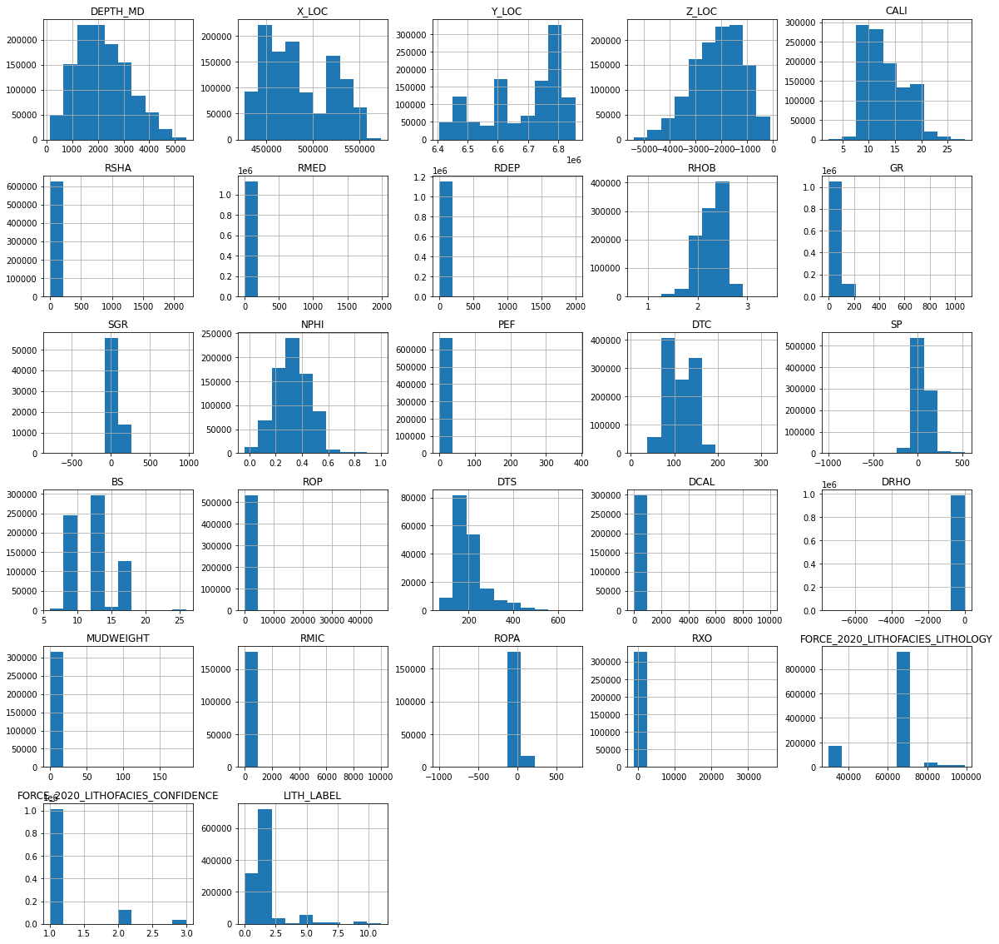

In [ ]:
ax = data.hist(figsize=(20,20))

##**Glimps**

In [ ]:
data.describe()

,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,PEF,DTC,SP,BS,ROP,DTS,DCAL,DRHO,MUDWEIGHT,RMIC,ROPA,RXO,FORCE_2020_LITHOFACIES_LITHOLOGY,FORCE_2020_LITHOFACIES_CONFIDENCE,LITH_LABEL
count,1.170511e+06,1.159736e+06,1.159736e+06,1.159736e+06,1.082634e+06,630650.000000,1.131518e+06,1.159496e+06,1.009242e+06,1.170511e+06,69353.000000,765409.000000,671692.000000,1.089648e+06,864247.000000,682657.000000,535071.000000,174613.000000,298833.000000,987857.000000,316151.000000,176160.000000,192325.000000,327427.000000,1.170511e+06,1.170332e+06,1.170511e+06
mean,2.184087e+03,4.856310e+05,6.681276e+06,-2.138527e+03,1.318568e+01,10.694664,4.986978e+00,1.069103e+01,2.284987e+00,7.091370e+01,64.895910,0.331966,6.319719,1.133581e+02,60.033980,11.931432,137.367965,204.655019,1.223849,0.012196,1.216329,7.796809,23.505069,-95.779496,6.138598e+04,1.164258e+00,1.953153e+00
std,9.971821e+02,3.455641e+04,1.281524e+05,9.709426e+02,3.798907e+00,100.642597,5.467269e+01,1.139480e+02,2.532835e-01,3.423149e+01,38.435818,0.130483,10.955360,2.999050e+01,76.574359,3.330242,1539.383558,71.068461,54.372859,7.477798,10.180834,89.741807,22.632800,348.980030,1.389170e+04,4.451180e-01,1.541950e+00
min,1.360860e+02,4.268988e+05,6.406641e+06,-5.395563e+03,2.344000e+00,0.000100,-8.418695e-03,3.170056e-02,7.209712e-01,1.092843e-01,-777.985962,-0.035822,0.099718,7.415132e+00,-999.000000,6.000000,-0.117977,69.163177,-12.215459,-7429.338867,0.125818,0.056586,-999.250122,-999.900024,3.000000e+04,1.000000e+00,0.000000e+00
25%,1.418597e+03,4.547996e+05,6.591327e+06,-2.811502e+03,9.429712e+00,0.854120,9.140862e-01,9.102396e-01,2.092203e+00,4.762722e+01,42.962429,0.241365,3.414440,8.782584e+01,32.402981,8.500000,5.628000,155.936707,0.148438,-0.009253,0.143792,0.891272,11.281895,0.687681,6.500000e+04,1.000000e+00,1.000000e+00
50%,2.076605e+03,4.769203e+05,6.737311e+06,-2.042785e+03,1.255575e+01,1.399020,1.443584e+00,1.439000e+00,2.321228e+00,6.836763e+01,69.562714,0.326800,4.313530,1.095852e+02,55.390942,12.250001,17.799999,188.200653,0.557320,0.001752,0.155774,1.967156,20.131153,1.366672,6.500000e+04,1.000000e+00,2.000000e+00
75%,2.864393e+03,5.201532e+05,6.784886e+06,-1.391866e+03,1.671075e+01,3.099348,2.680930e+00,2.557220e+00,2.488580e+00,8.903551e+01,87.910156,0.422951,5.968794,1.407745e+02,83.393299,12.250001,34.812794,224.645081,1.299655,0.021702,1.168307,5.084564,31.138481,3.420790,6.500000e+04,1.000000e+00,2.000000e+00
max,5.436632e+03,5.726328e+05,6.856661e+06,-1.110860e+02,2.827900e+01,2193.904541,1.988616e+03,1.999887e+03,3.457820e+00,1.076964e+03,963.608582,0.999570,383.129974,3.204789e+02,526.547302,26.000002,47015.125000,676.578125,10011.422852,2.836938,185.730927,10000.000000,742.797852,35930.671875,9.900000e+04,3.000000e+00,1.100000e+01


In [ ]:
test_data.describe()

,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,PEF,DTC,SP,BS,ROP,DTS,DCAL,DRHO,MUDWEIGHT,RMIC,ROPA,RXO
count,136786.000000,136727.000000,1.367270e+05,136727.000000,131141.000000,39097.000000,136199.000000,136727.000000,119826.000000,136786.000000,0.0,104043.000000,113503.000000,135963.000000,66627.000000,66964.000000,68316.000000,43220.000000,13515.000000,111556.000000,20269.000000,11316.000000,55790.000000,29848.000000
mean,2501.136889,467884.598172,6.708199e+06,-2397.835918,12.613567,3.137817,3.844914,3.662074,2.324925,65.223264,NaN,0.313442,6.113697,108.979172,43.528467,10.963364,26.406939,185.389543,0.160979,0.014441,6.028683,4.906861,22.669058,5.280645
std,1043.245788,35865.313917,1.352924e+05,937.001116,3.218969,17.293036,24.170949,23.242750,0.243602,31.146538,NaN,0.119559,9.910591,27.258608,25.530487,1.839420,31.913763,63.173605,0.536332,0.054151,49.607255,22.963156,13.436052,55.475790
min,227.296008,423237.531250,6.461833e+06,-4362.296387,6.682522,0.255146,0.148474,0.152317,1.289989,6.342400,NaN,-0.008744,0.609550,45.682781,-24.132233,8.500000,0.004297,79.327354,-6.402187,-1.213720,0.129413,0.063258,0.572329,0.262056
25%,1707.948917,442441.406250,6.605454e+06,-3171.749634,9.049458,0.850029,0.933067,0.902655,2.116576,44.557275,NaN,0.225725,3.191888,87.004333,31.179566,8.500000,12.240131,146.022373,0.027619,-0.001835,0.134206,0.543010,12.753529,1.081298
50%,2471.823595,455904.187500,6.759398e+06,-2442.877197,12.428942,1.416000,1.669926,1.657664,2.376285,60.110472,NaN,0.303587,4.336953,102.932892,48.967999,12.250001,20.878899,175.515274,0.124714,0.009203,0.143792,1.435970,19.927827,1.587683
75%,3294.643006,485144.859375,6.822772e+06,-1681.509216,14.177558,2.578526,3.088695,2.894494,2.531131,82.757637,NaN,0.398275,6.216157,135.565437,62.133951,12.250001,31.232986,204.037148,0.247048,0.026884,0.149783,4.425004,29.882400,3.274492
max,5007.417976,548460.437500,6.853315e+06,-205.295288,27.344881,1566.168457,1901.766602,1582.094482,3.073430,500.878357,NaN,0.850443,382.121826,183.480774,125.522781,17.500000,621.078247,494.096802,7.362912,0.404614,426.921356,957.984436,131.990906,2000.000000


## **Train Data**

In [ ]:
X = data.copy()
X['LITH_LABEL1'] = X.LITH_LABEL

In [ ]:
X['LITHOLOGY'].unique()

array(['Shale', 'Sandstone', 'Sandstone/Shale', 'Limestone', 'Tuff',
       'Marl', 'Anhydrite', 'Dolomite', 'Chalk', 'Coal', 'Halite',
       'Basement'], dtype=object)

### **GR**

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distribu

CPU times: user 1min 43s, sys: 2.06 s, total: 1min 45s
Wall time: 1min 43s


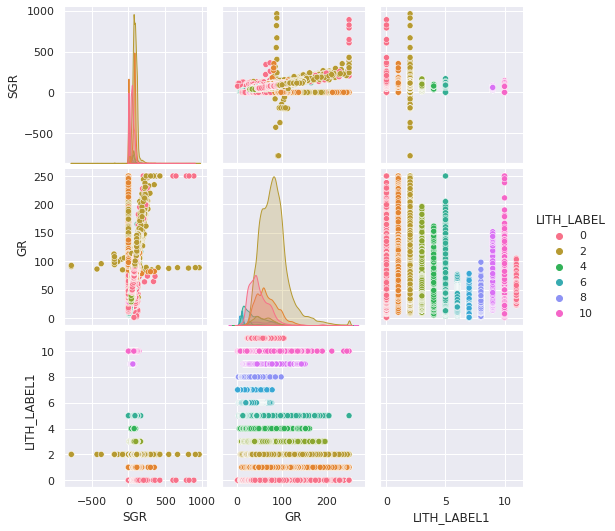

In [ ]:
%%time
sns.set()
sns.pairplot(X[[ 'SGR','GR','LITH_LABEL1','LITH_LABEL']],
             hue="LITH_LABEL", palette='husl')

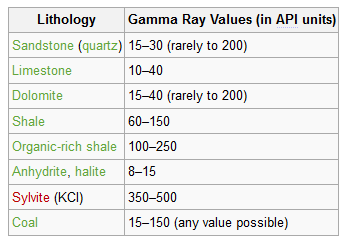

In [ ]:
X['GR'][X['GR']>250] = 250 #SGR can also be used to find CGR
X['GR'][X['GR']<8] = 8

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distribu

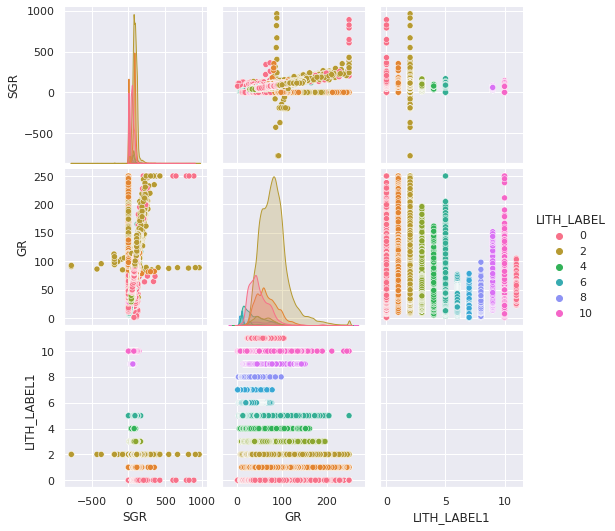

In [ ]:
sns.set()
sns.pairplot(X[[ 'SGR','GR','LITH_LABEL1','LITH_LABEL']],
             hue="LITH_LABEL", palette='husl')

### **NPHI**

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distribu

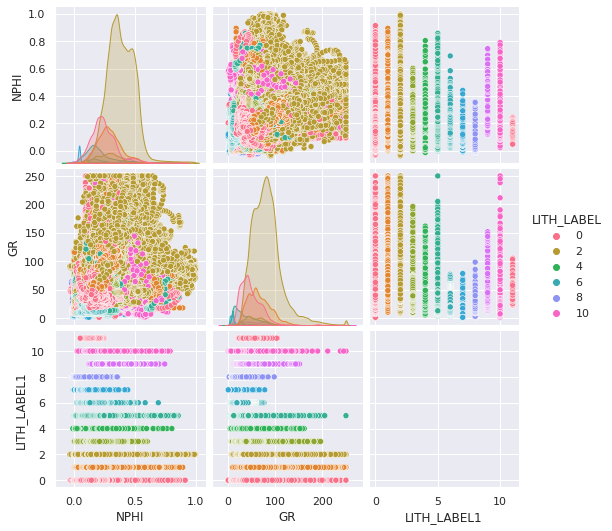

In [ ]:
sns.pairplot(X[[ 'NPHI','GR','LITH_LABEL1','LITH_LABEL']],
             hue="LITH_LABEL", palette='husl')

In [ ]:
X['NPHI'][X['NPHI']>0.60]=np.nan
X['NPHI'][X['NPHI']<0]=np.nan

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distribu

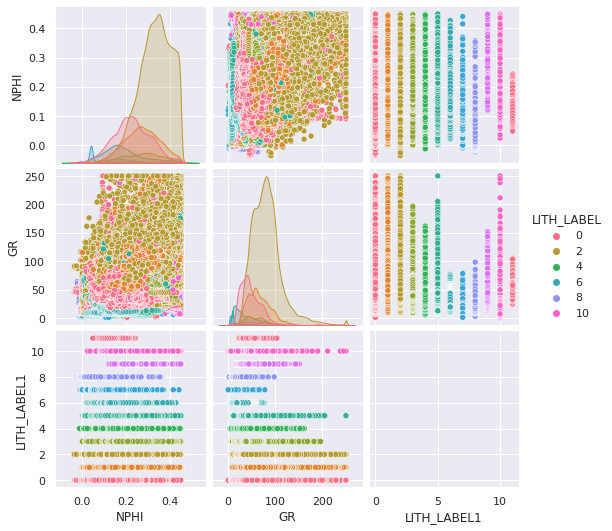

In [ ]:
sns.pairplot(X[[ 'NPHI','GR','LITH_LABEL1','LITH_LABEL']],
             hue="LITH_LABEL", palette='husl')

### **RHOB**

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distribu

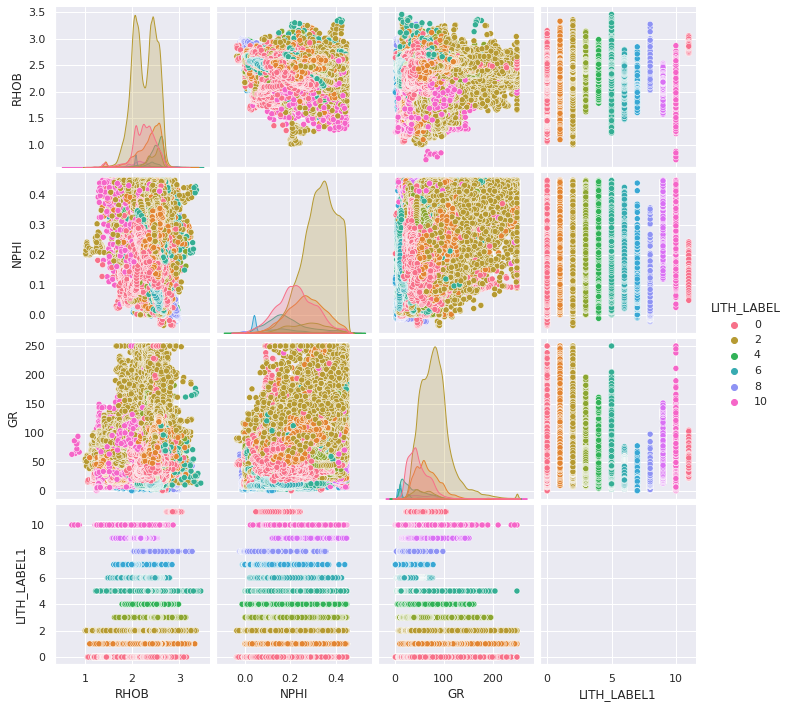

In [ ]:
sns.pairplot(X[['RHOB','NPHI','GR','LITH_LABEL1','LITH_LABEL']],
             hue="LITH_LABEL", palette='husl')

In [ ]:
X['RHOB'][X['RHOB']<1.9]=np.nan
X['RHOB'][X['RHOB']>2.9]=np.nan

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distribu

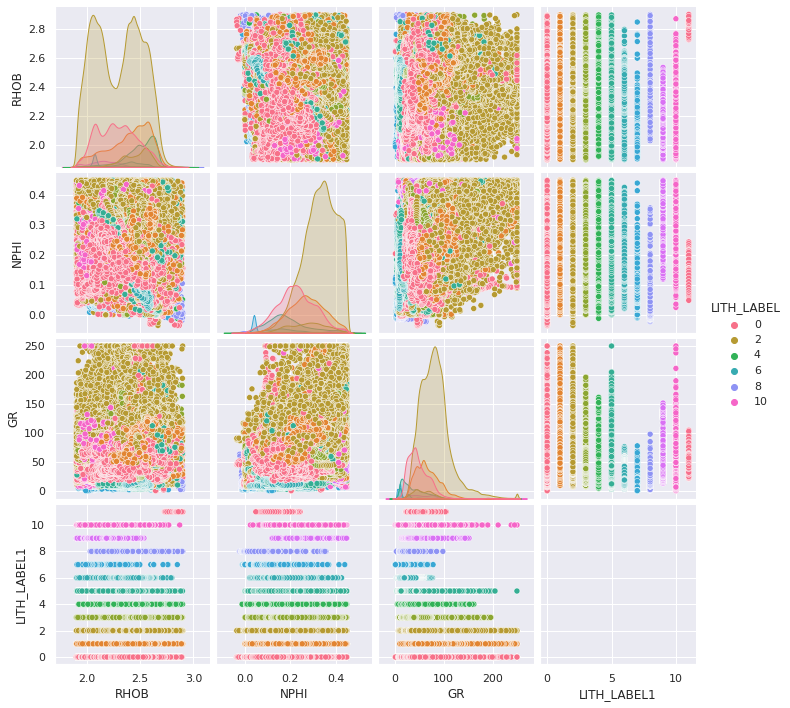

In [ ]:
sns.pairplot(X[['RHOB','NPHI','GR','LITH_LABEL1','LITH_LABEL']],
             hue="LITH_LABEL", palette='husl')

###**PEF**

In [ ]:
X = X.drop(X[X['PEF']>10].index)

###**SP and DTC**

In [ ]:
X = X.drop(X[X['SP']>126].index) #based on test data
X = X.drop(X[X['SP']<-25].index) #based on test data
X = X.drop(X[X['DTC']>184].index) #based on test data

###**DRHO**
DRHO values in excess of 0.1 g/cm3 indicate unreliable density data

In [ ]:
X = X.drop(X[X['DRHO']>0.1].index)
X = X.drop(X[X['DRHO']<-1.3].index) #from test data

###**RMED, RDEP**

In certain bedded zones where, certain logs are bound to show spikes (such as resistivity in coal), that spikes will not be removed. 

In [ ]:
X = X.drop(X[X['RMED']>1902].index) #from test data
X = X.drop(X[X['RDEP']>1583].index) #from test data
X = X.drop(X[X['RMED']<0].index) #from literature
X = X.drop(X[X['RDEP']<0].index) #from literature

###**RMIC, RXO, RSHA**

In [ ]:
X['RMIC'][X['RMIC']>2000] = np.nan
X['RXO'][X['RXO']>2000] = np.nan
X['RSHA'][X['RSHA']>2000] = np.nan
X['RXO'][X['RXO']<0] = np.nan
X['RSHA'][X['RSHA']<0] = np.nan

###**DCAL**

In [ ]:
X = X.drop(X[X['DCAL']>1].index) #from literature (considered breakout above 1)
X = X.drop(X[X['DCAL']<-7].index) #from test data

##**Visual Inspection (After)**

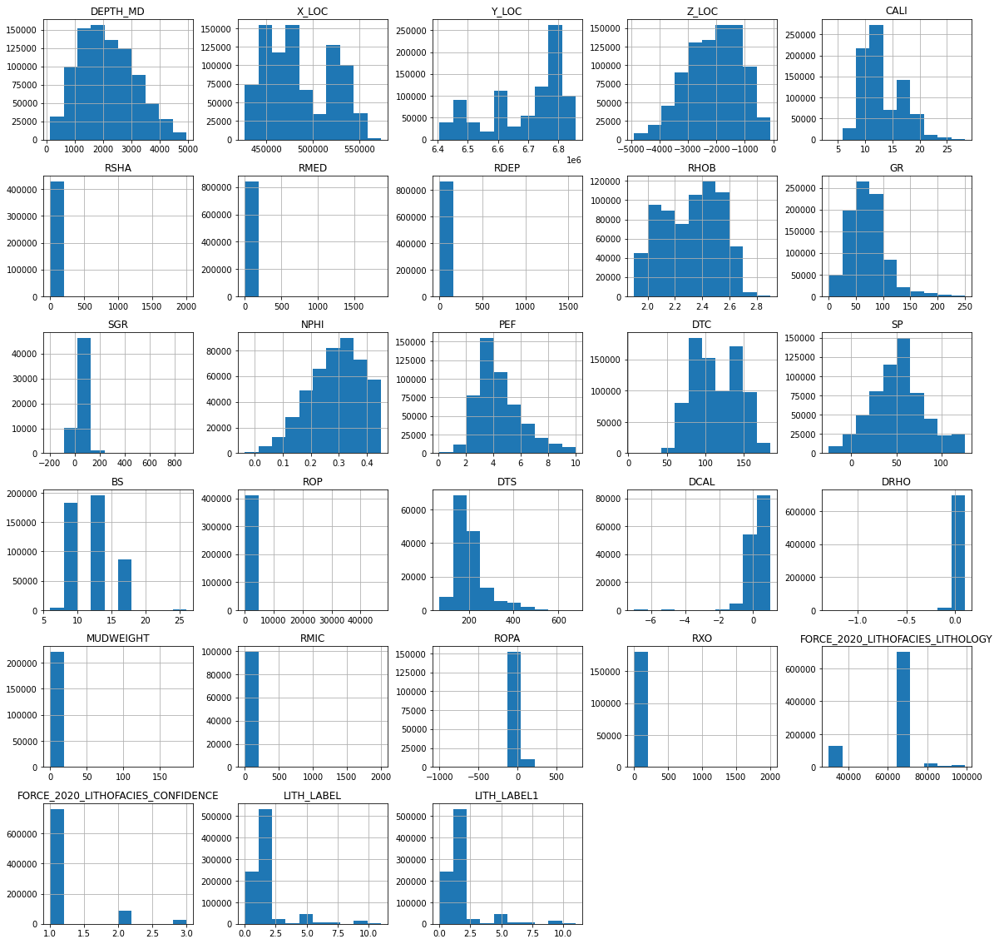

In [ ]:
ax = X.hist(figsize=(20,20))

In [ ]:
X.describe()

,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,PEF,DTC,SP,BS,ROP,DTS,DCAL,DRHO,MUDWEIGHT,RMIC,ROPA,RXO,FORCE_2020_LITHOFACIES_LITHOLOGY,FORCE_2020_LITHOFACIES_CONFIDENCE,LITH_LABEL,LITH_LABEL1
count,875373.000000,865836.000000,8.658360e+05,865836.000000,805726.000000,430266.000000,841674.000000,865689.000000,693088.000000,875373.000000,57469.000000,462634.000000,500247.000000,810313.000000,600357.000000,469181.000000,414002.000000,149899.000000,143124.000000,716607.000000,220910.000000,99456.000000,162261.000000,180538.000000,875373.000000,875257.000000,875373.000000,875373.000000
mean,2144.501220,485865.558899,6.687723e+06,-2095.723280,13.062938,6.783754,3.414012,4.816736,2.319883,70.689224,63.012299,0.288693,4.439424,113.964179,52.254269,11.745973,167.892752,204.789811,0.208415,0.003941,1.054244,7.896478,21.844439,9.179145,61248.789284,1.163309,1.957399,1.957399
std,974.430988,34195.049244,1.291351e+05,945.991779,3.781952,69.455246,18.309029,43.792686,0.208090,33.303855,38.628842,0.094407,1.647302,29.255214,29.416508,3.286095,1721.655671,71.200600,0.694286,0.052761,8.835721,77.194803,20.679536,91.595417,14060.476137,0.449836,1.570176,1.570176
min,136.086000,426898.781250,6.406641e+06,-4894.877930,3.289219,0.000100,0.069191,0.031701,1.900007,0.109284,-196.869995,-0.035822,0.099718,7.415132,-24.999676,6.000000,-0.117977,69.163177,-7.000000,-1.299817,0.125818,0.056586,-999.250122,0.002298,30000.000000,1.000000,0.000000,0.000000
25%,1384.121084,454469.531250,6.603730e+06,-2784.658081,9.144190,0.874402,0.932180,0.920140,2.134923,47.433651,40.413395,0.223241,3.311095,89.191727,33.532612,8.500000,6.533596,155.936081,-0.009234,-0.009047,0.141395,1.062951,11.546526,0.963026,65000.000000,1.000000,1.000000,1.000000
50%,2049.670000,478825.625000,6.737678e+06,-2013.379760,12.489283,1.406144,1.444480,1.427276,2.345847,68.438858,68.641968,0.298000,4.090159,110.562096,52.359848,12.250001,19.781977,189.097382,0.282310,0.001004,0.159369,2.034821,19.576260,1.641448,65000.000000,1.000000,2.000000,2.000000
75%,2836.465123,520153.187500,6.788188e+06,-1355.181732,16.806279,2.826400,2.491938,2.436202,2.491743,88.523689,86.173996,0.361365,5.312670,140.827499,69.313942,12.250001,36.852695,224.156502,0.590378,0.017761,1.162316,4.469450,29.805218,3.628859,65000.000000,1.000000,2.000000,2.000000
max,4932.596000,572632.750000,6.856661e+06,-111.085991,28.278999,1999.800049,1863.185425,1581.230225,2.899970,250.000000,891.335815,0.450000,10.000000,183.997375,126.000000,26.000002,47015.125000,676.578125,1.000000,0.100000,185.730927,2000.000000,742.797852,2000.000000,99000.000000,3.000000,11.000000,11.000000


In [ ]:
#X.to_csv('/content/drive/My Drive/Colab Notebooks/Despiked_Dataset.csv')

# **Clustering Based on Spatial Location**

https://github.com/mycarta/Force-2020-Machine-Learning-competition_predict-lithology-EDA/blob/master/GMM_clustering_of_spatial_location.ipynb

In [ ]:
data_location = pd.read_csv('/content/drive/My Drive/Colab Notebooks/force_2020_meta.csv')

In [ ]:
data_location.head(10)

,WELL,WELL_HEAD,lat,lon,Drilling Operator,Purpose,Completion Year,Formation,Dataset
0,15/9-13,15/9-13,58.373878,1.934128,Den norske stats oljeselskap a.s,APPRAISAL,1982.0,ZECHSTEIN GP,Train
1,15/9-15,15/9-15,58.302069,1.922131,Den norske stats oljeselskap a.s,WILDCAT,1982.0,SKAGERRAK FM,Train
2,15/9-17,15/9-17,58.445608,1.948217,Den norske stats oljeselskap a.s,WILDCAT,1983.0,SMITH BANK FM,Train
3,16/1-2,16/1-2,58.935894,2.222239,Esso Exploration and Production Norway A/S,APPRAISAL,1976.0,BASEMENT,Train
4,16/1-6 A,16/1-6,58.991097,2.295297,Statoil ASA (old),WILDCAT,2003.0,TOR FM,Train
5,16/10-1,16/10-1,58.056578,2.053903,Norsk Agip AS,WILDCAT,1986.0,ZECHSTEIN GP,Train
6,16/10-2,16/10-2,58.140717,2.037475,Norsk Agip AS,WILDCAT,1991.0,SKAGERRAK FM,Train
7,16/10-3,16/10-3,58.221817,2.326194,Norsk Agip AS,WILDCAT,1996.0,SMITH BANK FM,Train
8,16/10-5,16/10-5,58.000994,2.132100,Talisman Energy Norge AS,WILDCAT,2012.0,BRYNE FM,Train
9,16/11-1 ST3,16/11-1,58.067778,2.568889,NaN,NaN,NaN,NaN,Train


In [ ]:
LonLat_df =  data_location.drop(['WELL', 'WELL_HEAD', 'Drilling Operator', 'Purpose', 'Completion Year', 'Formation', 'Dataset'], axis=1)
X_location = LonLat_df[['lon', 'lat']].values

In [ ]:
kmeans = KMeans(n_clusters=3, init='k-means++', random_state=3425)

In [ ]:
def plot_kmeans(kmeans, X, ax=None):
    
    labels = kmeans.fit_predict(X_location)

    # plot the input data
    ax = ax or plt.gca()
    ax.axis('equal')
    ax.scatter(X[:, 0], X[:, 1], c = labels, s=60, cmap='viridis', zorder=1, alpha = 0.7)

    # plot the representation of the KMeans model
    centers = kmeans.cluster_centers_
    ax.scatter(centers[:, 0], centers[:, 1], c = 'g', s = 300, zorder=1)
    ax.scatter(centers[:, 0], centers[:, 1], c = 'k', s = 100, zorder=2)
    radii = [cdist(X[labels == i], [center]).max()
             for i, center in enumerate(centers)]
    for c, r in zip(centers, radii):
        ax.add_patch(plt.Circle(c, r, fc='lightgray', lw=2, alpha=0.4, zorder=0))

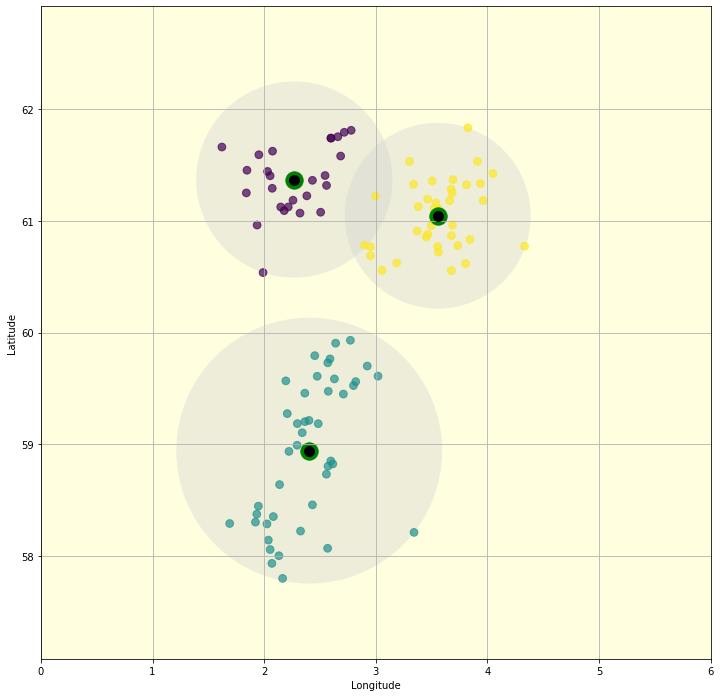

In [ ]:
fig = plt.figure(figsize=((12,12)))
plot_kmeans(kmeans, X_location)
ax = plt.gca()
ax.set_facecolor('lightyellow')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_xlim(0,6)
ax.set_ylim(57,63)
plt.grid();

In [ ]:
gmm = mixture.GaussianMixture(n_components=3, covariance_type='full', random_state=2698).fit(X_location)

In [ ]:
gmm.predict(X_location)+1

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 1, 1])

In [ ]:
np.set_printoptions(formatter={'float': lambda x: "{0:0.3f}".format(x)})

In [ ]:
probs = gmm.predict_proba(X_location)

In [ ]:
probs[np.where((probs.max(axis=1)<0.995 )&(probs.max(axis=1)>0.9))]

array([[0.000, 0.016, 0.984],
       [0.951, 0.049, 0.000],
       [0.006, 0.003, 0.992],
       [0.969, 0.002, 0.029]])

In [ ]:
probs[np.where(probs.max(axis=1)<0.9)]

array([[0.895, 0.098, 0.007],
       [0.857, 0.125, 0.018],
       [0.851, 0.146, 0.003],
       [0.832, 0.167, 0.000],
       [0.810, 0.014, 0.175]])

In [ ]:
labels = gmm.predict(X_location)+1

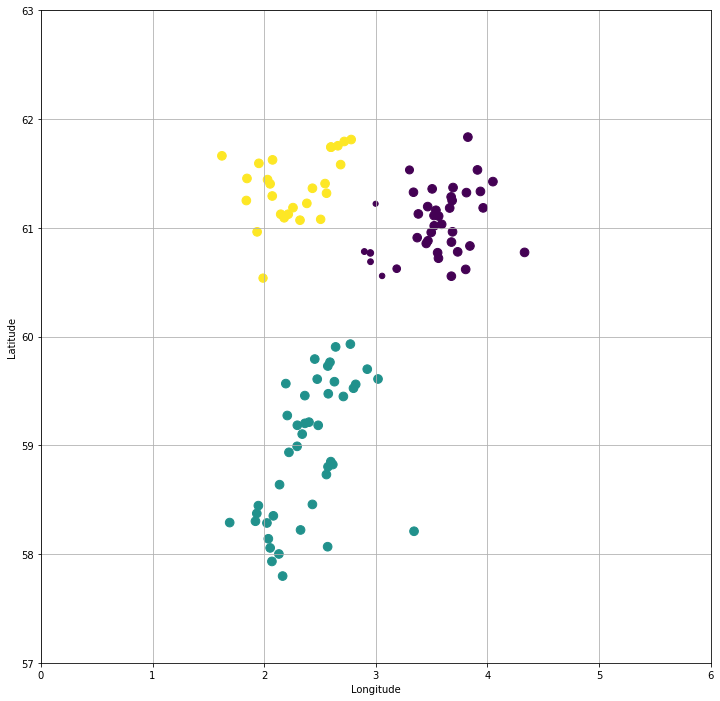

In [ ]:
fig = plt.figure(figsize=(12,12))
sizes = 75 * probs.max(1) ** 5 
plt.scatter(X_location[:, 0], X_location[:, 1], c=labels, cmap='viridis', s=sizes)
ax = plt.gca()
ax.set_facecolor('white')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_xlim(0,6)
ax.set_ylim(57,63)
plt.grid();

In [ ]:
def draw_ellipse(position, covariance, ax=None, **kwargs):
    """Draw an ellipse with a given position and covariance"""
    ax = ax or plt.gca()
    
    # Convert covariance to principal axes
    if covariance.shape == (2, 2):
        U, s, Vt = np.linalg.svd(covariance)
        angle = np.degrees(np.arctan2(U[1, 0], U[0, 0]))
        width, height = 2 * np.sqrt(s)
    else:
        angle = 0
        width, height = 2 * np.sqrt(covariance)
    
    # Draw the Ellipse
    for nsig in range(1, 4):
        ax.add_patch(Ellipse(position, nsig * width, nsig * height,
                             angle, **kwargs))
        
def plot_gmm(gmm, X, label=True, ax=None):
    fig = plt.figure(figsize=((12,12)))
    ax = ax or plt.gca()
    labels = gmm.fit(X).predict(X)

    if label:
        ax.scatter(X[:, 0], X[:, 1], c=labels, s=40, cmap='viridis', zorder=2)
    else:
        ax.scatter(X[:, 0], X[:, 1], s=40, zorder=2)
    ax.axis('equal')
    
    w_factor = 0.2 / gmm.weights_.max()
    for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
        draw_ellipse(pos, covar, alpha=w * w_factor, facecolor = 'darkgreen', edgecolor ='darkslategray')

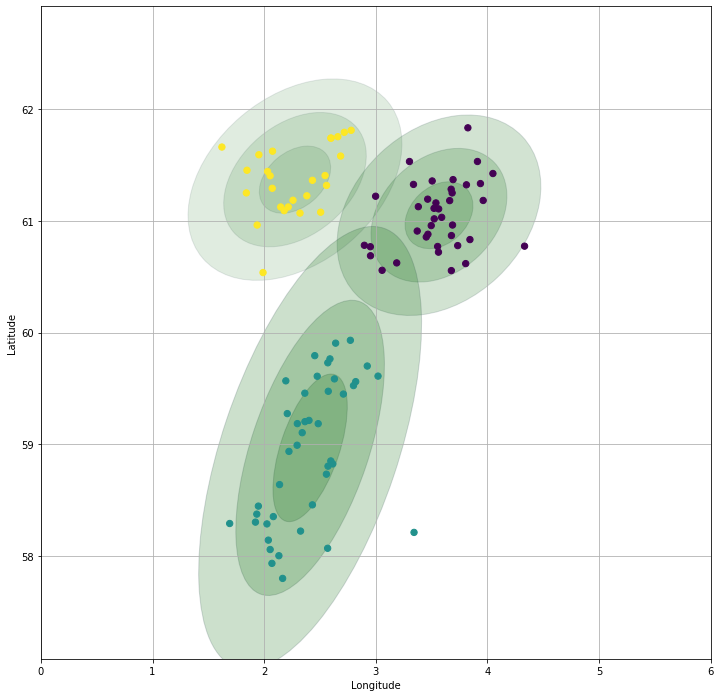

In [ ]:
plot_gmm(gmm, X_location)
ax = plt.gca()
ax.set_facecolor('white')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_xlim(0,6)
ax.set_ylim(57,63)
plt.grid();

In [ ]:
probs_str=[]
for i in probs:
    probs_str.append([str(j) for j in np.round(i, 3)])

In [ ]:
data_gmm = data_location.copy()

In [ ]:
data_gmm['probs_str'] = probs_str
data_gmm['cluster'] = labels
data_gmm['plot_size']= sizes
data_gmm['cluster1_prob'], data_gmm['cluster2_prob'], data_gmm['cluster3_prob'] = np.round(probs.T, 3)

In [ ]:
columns = list(data)+[ 'cluster', 'color', 'plot_size', 'probs_str',
                      'cluster1_prob', 'cluster1_prob', 'cluster1_prob']

In [ ]:
data_gmm

,WELL,WELL_HEAD,lat,lon,Drilling Operator,Purpose,Completion Year,Formation,Dataset,probs_str,cluster,plot_size,cluster1_prob,cluster2_prob,cluster3_prob
0,15/9-13,15/9-13,58.373878,1.934128,Den norske stats oljeselskap a.s,APPRAISAL,1982.0,ZECHSTEIN GP,Train,"[0.0, 1.0, 0.0]",2,75.000000,0.000,1.0,0.000
1,15/9-15,15/9-15,58.302069,1.922131,Den norske stats oljeselskap a.s,WILDCAT,1982.0,SKAGERRAK FM,Train,"[0.0, 1.0, 0.0]",2,75.000000,0.000,1.0,0.000
2,15/9-17,15/9-17,58.445608,1.948217,Den norske stats oljeselskap a.s,WILDCAT,1983.0,SMITH BANK FM,Train,"[0.0, 1.0, 0.0]",2,75.000000,0.000,1.0,0.000
3,16/1-2,16/1-2,58.935894,2.222239,Esso Exploration and Production Norway A/S,APPRAISAL,1976.0,BASEMENT,Train,"[0.0, 1.0, 0.0]",2,75.000000,0.000,1.0,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,34/3-3 A,34/3-3,61.795136,2.717883,BG Norge AS,APPRAISAL,2012.0,BURTON FM,Test,"[0.0, 0.0, 1.0]",3,74.834538,0.000,0.0,1.000
105,34/6-1 S,34/6-1,61.582317,2.685472,Norske Conoco A/S,WILDCAT,2002.0,LUNDE FM,Test,"[0.001, 0.0, 0.998]",3,74.430037,0.001,0.0,0.998
106,35/6-2 S,35/6-2,61.533606,3.911311,StatoilHydro Petroleum AS,WILDCAT,2009.0,NO FORMAL NAME,Test,"[1.0, 0.0, 0.0]",1,74.989192,1.000,0.0,0.000
107,35/9-8,35/9-8,61.285269,3.675594,Wintershall Norge AS,APPRAISAL,2013.0,RANNOCH FM,Test,"[1.0, 0.0, 0.0]",1,74.944270,1.000,0.0,0.000


In [ ]:
#data_gmm.to_csv('/content/drive/My Drive/Colab Notebooks/clusters_gaussian-mixture-model_3components.csv', sep=',')

## **Well Data after clustering based on longitude and latitude data**

In [ ]:
data_gmm = pd.read_csv('/content/drive/My Drive/Colab Notebooks/clusters_gaussian-mixture-model_3components.csv')

##**Adding new features based on clustering**

In [ ]:
X = pd.read_csv('/content/drive/My Drive/Colab Notebooks/Despiked_Dataset.csv')

In [ ]:
data_gmm = data_gmm.set_index('WELL')

In [ ]:
X["plot_size"] = np.nan
X["cluster1_prob"] = np.nan
X["cluster2_prob"] = np.nan
X["cluster3_prob"] = np.nan
test_data["plot_size"] = np.nan
test_data["cluster1_prob"] = np.nan
test_data["cluster2_prob"] = np.nan
test_data["cluster3_prob"] = np.nan

In [ ]:
for i in range(0,len(X)):
  X.FORMATION[i] = data_gmm.Formation[str(X.WELL[i])]
  X.plot_size[i] = data_gmm.plot_size[str(X.WELL[i])]
  X.cluster1_prob[i] = data_gmm.cluster1_prob[str(X.WELL[i])]
  X.cluster2_prob[i] = data_gmm.cluster2_prob[str(X.WELL[i])]
  X.cluster3_prob[i] = data_gmm.cluster3_prob[str(X.WELL[i])]

In [ ]:
for i in range(0,len(test_data)):
  test_data.FORMATION[i] = data_gmm.Formation[str(test_data.WELL[i])]
  test_data.plot_size[i] = data_gmm.plot_size[str(test_data.WELL[i])]
  test_data.cluster1_prob[i] = data_gmm.cluster1_prob[str(test_data.WELL[i])]
  test_data.cluster2_prob[i] = data_gmm.cluster2_prob[str(test_data.WELL[i])]
  test_data.cluster3_prob[i] = data_gmm.cluster3_prob[str(test_data.WELL[i])]

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying t

In [ ]:
#X.to_csv('/content/drive/My Drive/Colab Notebooks/Despiked_Spatially_Clustered_Dataset.csv')

In [ ]:
#test_data.to_csv('/content/drive/My Drive/Colab Notebooks/new_test_data.csv')

# **Flagging Bad Hole**

I have already flagged the zones on the basis of DCAL and DRHO. Two methods to be used:-
1.	Using Caliper log, Borehole Size (BS) to identify rugosity and washout and flag bad hole
2.	Using ensemble model for DTC, RHOB and compare the predicted RHOB, DTC with actual log values to flag bad hole. (If the difference between predicted and actual is large, that zone will be flagged)


In [ ]:
X = pd.read_csv('/content/drive/My Drive/Colab Notebooks/Despiked_Spatially_Clustered_Dataset.csv')

In [ ]:
import ipywidgets as widgets
from ipywidgets import interactive, interact

columns = ['CALI', 'BS', 'DCAL', 'RSHA', 'RMED', 'RDEP', 'RHOB', 'GR', 'SGR',
           'NPHI', 'PEF', 'DTC', 'SP', 'ROP', 'DTS', 'DRHO',
           'MUDWEIGHT', 'RMIC', 'ROPA', 'RXO']

plot_output = widgets.Output()

dropdown_well = widgets.Dropdown(options = X['WELL'].unique(), description='Well:', value='15/9-13')

select_curves = widgets.SelectMultiple(
    options=columns,
    value=columns,
    #rows=10,
    description='Curves:',
    disabled=False
)

plot_button = widgets.Button(
    description='Show well plot',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='Click to plot well.'
)
        
def on_button_clicked(b):
    plot_output.clear_output()
    with plot_output:
        make_facies_log_plot(
            X[X['WELL'] == dropdown_well.value],
            select_curves.value,
            facies_colors)
        
plot_button.on_click(on_button_clicked)

display(dropdown_well)
display(select_curves)
display(plot_button)
display(plot_output)

Dropdown(description='Well:', options=('15/9-13', '15/9-15', '15/9-17', '16/1-2', '16/1-6 A', '16/10-1', '16/1…

SelectMultiple(description='Curves:', index=(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18,…

Button(description='Show well plot', style=ButtonStyle(), tooltip='Click to plot well.')

Output()

## **Using Caliper, BS**

In [ ]:
X = X.drop(X[X['CALI']<0.98*X['BS']].index) #for rugosity
X = X.drop(X[X['CALI']>1.02*X['BS']].index) #for breakout

In [ ]:
X.describe()

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,PEF,DTC,SP,BS,ROP,DTS,DCAL,DRHO,MUDWEIGHT,RMIC,ROPA,RXO,FORCE_2020_LITHOFACIES_LITHOLOGY,FORCE_2020_LITHOFACIES_CONFIDENCE,LITH_LABEL,LITH_LABEL1,plot_size,cluster1_prob,cluster2_prob,cluster3_prob
count,627651.000000,627651.000000,6.276510e+05,627651.000000,622525.000000,6.225250e+05,622525.000000,558004.000000,228493.000000,430964.000000,445122.000000,485021.000000,627651.000000,51911.000000,317543.000000,354134.000000,575217.000000,441713.000000,221459.000000,269699.000000,93268.000000,49804.000000,511995.000000,135950.000000,57862.000000,126032.000000,122794.000000,627651.000000,627573.000000,627651.000000,627651.000000,627651.000000,627651.000000,627651.000000,627651.000000
mean,454922.288858,454922.288858,6.240569e+05,2087.543644,488160.374418,6.702136e+06,-2034.864556,13.399834,8.222986,3.053038,3.600992,2.308174,70.561704,61.706421,0.291115,4.436335,115.374686,51.330370,11.695577,132.347855,196.393269,0.022052,0.002790,0.996870,10.573295,22.279036,6.920431,61314.082144,1.171956,1.927944,1.927944,70.492447,0.399156,0.306816,0.293970
std,244212.158780,244212.158780,3.280334e+05,971.212839,34992.431475,1.249301e+05,931.562712,3.829945,86.172432,20.631157,34.575569,0.207296,32.446303,37.151892,0.093909,1.642407,28.950345,29.486115,3.111197,1245.590611,61.882222,0.161420,0.055616,8.181222,100.174281,18.451235,71.359392,14048.923176,0.473007,1.575524,1.575524,12.185717,0.476307,0.449120,0.451945
min,0.000000,0.000000,4.500000e+01,136.086000,426898.781250,6.406641e+06,-4894.877930,3.289219,0.000100,0.069191,0.031701,1.900007,0.109284,-196.869995,-0.007200,0.100000,7.415132,-24.999676,6.000000,0.018832,69.163177,-4.185811,-1.299817,0.125818,0.110637,-999.250122,0.100000,30000.000000,1.000000,0.000000,0.000000,26.178633,0.000000,0.000000,0.000000
25%,259644.500000,259644.500000,3.643915e+05,1316.882108,454138.781250,6.621550e+06,-2728.650635,9.931531,0.925992,0.893645,0.884335,2.121425,47.902727,40.307159,0.225199,3.306969,90.778183,32.274822,8.500000,9.172791,154.471996,-0.095373,-0.009329,0.137800,1.182325,12.911808,0.990926,65000.000000,1.000000,1.000000,1.000000,74.366643,0.000000,0.000000,0.000000
50%,464583.000000,464583.000000,6.622090e+05,1998.707705,482074.968750,6.747134e+06,-1965.085815,12.445024,1.480058,1.384420,1.381620,2.333031,68.558037,67.362648,0.300908,4.101161,112.878944,52.077854,12.250001,23.400743,185.596626,0.042250,0.000615,0.156973,2.340559,20.560558,1.641954,65000.000000,1.000000,2.000000,2.000000,74.934196,0.000000,0.002000,0.000000
75%,653968.500000,653968.500000,8.870155e+05,2782.424617,524585.250000,6.788237e+06,-1291.589355,17.334502,2.942012,2.292170,2.249369,2.477850,87.080109,84.352345,0.363772,5.282458,142.168243,67.504036,12.250001,41.015991,218.860508,0.143289,0.016538,1.150334,4.947462,30.116611,3.070454,65000.000000,1.000000,2.000000,2.000000,74.999875,0.998000,1.000000,0.999000
max,875377.000000,875377.000000,1.170508e+06,4932.596000,572632.750000,6.856661e+06,-111.085991,28.278999,1999.800049,1855.329956,1581.230225,2.899970,250.000000,891.335815,0.450000,10.000000,183.992783,125.999916,26.000002,35228.093750,627.135681,0.996400,0.100000,155.774323,2000.000000,631.396057,2000.000000,99000.000000,3.000000,11.000000,11.000000,75.000000,1.000000,1.000000,1.000000


In [ ]:
import ipywidgets as widgets
from ipywidgets import interactive, interact

columns = ['CALI', 'BS', 'DCAL', 'RSHA', 'RMED', 'RDEP', 'RHOB', 'GR', 'SGR',
           'NPHI', 'PEF', 'DTC', 'SP', 'ROP', 'DTS', 'DRHO',
           'MUDWEIGHT', 'RMIC', 'ROPA', 'RXO']

plot_output = widgets.Output()

dropdown_well = widgets.Dropdown(options = X['WELL'].unique(), description='Well:', value='15/9-13')

select_curves = widgets.SelectMultiple(
    options=columns,
    value=columns,
    #rows=10,
    description='Curves:',
    disabled=False
)

plot_button = widgets.Button(
    description='Show well plot',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='Click to plot well.'
)
        
def on_button_clicked(b):
    plot_output.clear_output()
    with plot_output:
        make_facies_log_plot(
            X[X['WELL'] == dropdown_well.value],
            select_curves.value,
            facies_colors)
        
plot_button.on_click(on_button_clicked)

display(dropdown_well)
display(select_curves)
display(plot_button)
display(plot_output)

Dropdown(description='Well:', options=('15/9-13', '15/9-15', '15/9-17', '16/1-2', '16/1-6 A', '16/10-1', '16/1…

SelectMultiple(description='Curves:', index=(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18,…

Button(description='Show well plot', style=ButtonStyle(), tooltip='Click to plot well.')

Output()

## **Using Ensemble Modeling (for DTC)**

First using GR to RDEP, then both to model RMED and then to model DTC (NaN values will also be predicted). For RDEP and RMED, only NaN values will be filled using trained model. For DTC, both NaN values and flagged zones will be reconstructed using the predicted values. 

### **RDEP Model**

In [ ]:
X = X.dropna(subset = ['GROUP']) #Test dataset has no NaN values for GROUP
X = X.dropna(subset = ['FORMATION'])
X = X.dropna(subset = ['FORCE_2020_LITHOFACIES_CONFIDENCE'])

In [ ]:
data1 = X.copy()

In [ ]:
X1 = X[['DEPTH_MD','GROUP','FORCE_2020_LITHOFACIES_CONFIDENCE','GR','RDEP',
        'plot_size','cluster1_prob','cluster2_prob','cluster3_prob']]

In [ ]:
confidence_keys = {1: 'high', 2:'medium',3:'low'}

In [ ]:
X1 = X1.replace({"FORCE_2020_LITHOFACIES_CONFIDENCE": confidence_keys})

In [ ]:
data1 = data1.replace({"FORCE_2020_LITHOFACIES_CONFIDENCE": confidence_keys})

In [ ]:
#Keeping only non NaN values of RDEP 
from pycaret.regression import *
exp_reg = setup(data = X1.dropna(subset = ['RDEP']),ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] },target = 'RDEP')

 
Setup Succesfully Completed.


,Description,Value
0,session_id,1132
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(434960, 9)"
4,Missing Values,False
5,Numeric Features,6
6,Categorical Features,2
7,Ordinal Features,True
8,High Cardinality Features,False
9,High Cardinality Method,None


In [ ]:
 rf = [create_model('rf',fold =14)]

In [ ]:
lgbm = create_model('lightgbm',fold = 14, learning_rate = .8,num_leaves = 20)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,2.4967,625.9822,25.0196,0.6645,0.4687,0.9422
1,2.6140,601.0445,24.5162,0.6286,0.4849,0.9848
2,2.3853,498.2061,22.3205,0.5990,0.4825,0.9584
3,2.3581,397.5490,19.9386,0.4826,0.4813,0.9758
4,2.3996,505.3783,22.4806,0.4081,0.4756,0.9433
5,2.6376,611.7980,24.7345,0.5934,0.4938,1.0446
6,2.4171,494.2151,22.2309,0.6288,0.4780,1.0051
7,2.2077,273.8310,16.5478,0.6662,0.4823,1.0180
8,2.3607,444.1465,21.0748,0.6607,0.4768,0.9582
9,2.5295,595.5328,24.4035,0.6454,0.4804,0.9548


In [ ]:
import numpy as np
lgbm_params = {'num_leaves': np.arange(10,300,10),
                        'max_depth': [int(x) for x in np.linspace(10, 220, num = 11)],
                        'learning_rate': np.arange(0.1,2,0.1)
                        }

In [ ]:
tuned_lgbm = tune_model(lgbm,custom_grid = lgbm_params)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,2.6944,634.5264,25.1898,0.6432,0.5075,1.0854
1,2.4167,485.2416,22.0282,0.6314,0.4849,0.9842
2,2.4291,399.7245,19.9931,0.5647,0.4951,1.0201
3,2.5160,548.2346,23.4144,0.4582,0.4961,1.0196
4,2.6787,618.9962,24.8796,0.5970,0.5006,1.0671
5,2.2605,345.3870,18.5846,0.6308,0.4904,1.0548
6,2.4813,477.7352,21.8572,0.6317,0.4890,1.0196
7,2.6469,531.3121,23.0502,0.6620,0.5009,1.0538
8,2.5379,525.2240,22.9178,0.5819,0.4951,0.9831
9,2.4865,428.5996,20.7026,0.5453,0.5040,1.1184


In [ ]:
# ensemble decision tree model with 'Boosting'
boosted_lgbm = ensemble_model(tuned_lgbm, method = 'Boosting')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,2.5152,485.5741,22.0357,0.7269,0.5382,1.1173
1,2.4748,420.2156,20.4992,0.6808,0.5340,1.1197
2,2.3573,275.0575,16.5849,0.7004,0.5362,1.1264
3,2.5927,482.7406,21.9714,0.5230,0.5410,1.1614
4,2.6634,521.9955,22.8472,0.6602,0.5451,1.1844
5,2.3289,279.0355,16.7044,0.7017,0.5433,1.1660
6,2.4206,408.1946,20.2038,0.6853,0.5396,1.1340
7,2.5567,426.9429,20.6626,0.7284,0.5387,1.1194
8,2.5713,491.5001,22.1698,0.6087,0.5464,1.1562
9,2.3371,334.3368,18.2849,0.6453,0.5415,1.1468


In [ ]:
#save_model(rf,'/content/drive/My Drive/Colab Notebooks/RDEP_Badholeflag_rfmodel')

Transformation Pipeline and Model Succesfully Saved


In [ ]:
#save_model(boosted_lgbm,'/content/drive/My Drive/Colab Notebooks/RDEP_Badholeflag_lgbmmodel')

Transformation Pipeline and Model Succesfully Saved


####**Prediciting RDEP NaN values**

In [ ]:
lgbm = load_model('/content/drive/My Drive/Colab Notebooks/RDEP_Badholeflag_lgbmmodel')

In [ ]:
rdep_null_data = data1[data1['RDEP'].isnull()]

In [ ]:
Predicted_RDEP = predict_model(lgbm, data = X1)

In [ ]:
Predicted_RDEP.index = X1.index

In [ ]:
data1.RDEP[rdep_null_data.index] = Predicted_RDEP.Label[rdep_null_data.index]

In [ ]:
#data1.to_csv('/content/drive/My Drive/Colab Notebooks/RDEP_badholeflag_nan_removed')

In [ ]:
data1.isna().any()

Unnamed: 0                           False
Unnamed: 0.1                         False
WELL                                 False
DEPTH_MD                             False
X_LOC                                 True
Y_LOC                                 True
Z_LOC                                 True
GROUP                                False
FORMATION                            False
CALI                                  True
RSHA                                  True
RMED                                  True
RDEP                                 False
RHOB                                  True
GR                                   False
SGR                                   True
NPHI                                  True
PEF                                   True
DTC                                   True
SP                                    True
BS                                    True
ROP                                   True
DTS                                   True
DCAL       

### **RMED Model**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/RDEP_badholeflag_nan_removed')

In [ ]:
X1 = data1[['DEPTH_MD','GROUP','FORMATION','FORCE_2020_LITHOFACIES_CONFIDENCE','GR','RDEP','RMED'
,'plot_size','cluster1_prob','cluster2_prob','cluster3_prob']]

In [ ]:
#Keeping only non NaN values of RDEP 
from pycaret.regression import *
exp_reg = setup(data = X1.dropna(subset = ['RMED']),ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] },target = 'RDEP')

 
Setup Succesfully Completed.


,Description,Value
0,session_id,2075
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(597237, 11)"
4,Missing Values,False
5,Numeric Features,7
6,Categorical Features,3
7,Ordinal Features,True
8,High Cardinality Features,False
9,High Cardinality Method,None


In [ ]:
models()

,Name,Reference,Turbo
ID,,,
lr,Linear Regression,sklearn.linear_model.LinearRegression,True
lasso,Lasso Regression,sklearn.linear_model.Lasso,True
ridge,Ridge Regression,sklearn.linear_model.Ridge,True
en,Elastic Net,sklearn.linear_model.ElasticNet,True
lar,Least Angle Regression,sklearn.linear_model.Lars,True
llar,Lasso Least Angle Regression,sklearn.linear_model.LassoLars,True
omp,Orthogonal Matching Pursuit,sklearn.linear_model.OMP,True
br,Bayesian Ridge,sklearn.linear_model.BayesianRidge,True
ard,Automatic Relevance Determination,sklearn.linear_model.ARDRegression,False


In [ ]:
best = compare_models(blacklist = ['ransac','tr','svm'])

IntProgress(value=0, description='Processing: ', max=221)

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,15:37:42
Status,. . . . . . . . . . . . . . . . . .,Compiling Final Model
Estimator,. . . . . . . . . . . . . . . . . .,Extra Trees Regressor
ETC,. . . . . . . . . . . . . . . . . .,Almost Finished


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
0,Extra Trees Regressor,0.3758,5.352490e+01,7.0697,8.386000e-01,0.0868,0.0565,362.8425
1,Random Forest,0.4086,5.935850e+01,7.3869,8.215000e-01,0.0969,0.0657,444.7754
2,CatBoost Regressor,0.6990,1.010424e+02,9.9297,7.000000e-01,0.1366,0.1442,54.4809
3,Gradient Boosting Regressor,0.8933,1.019449e+02,9.8654,6.993000e-01,0.1900,0.2629,167.4684
4,Extreme Gradient Boosting,0.9032,1.038931e+02,9.9386,6.943000e-01,0.1922,0.2634,42.3901
5,Decision Tree,0.4969,1.039568e+02,9.9644,6.817000e-01,0.1110,0.0722,8.6317
6,K Neighbors Regressor,0.6303,1.090265e+02,10.3052,6.764000e-01,0.1381,0.1264,5.4434
7,Light Gradient Boosting Machine,0.7771,1.166974e+02,10.6839,6.530000e-01,0.1556,0.1715,1.9810
8,Linear Regression,1.7868,2.493832e+02,15.6049,2.734000e-01,0.4479,0.8394,0.9648
9,Ridge Regression,1.7604,2.494292e+02,15.6063,2.732000e-01,0.4397,0.8104,0.2003


In [ ]:
rf = create_model('rf', fold = 7)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.3898,45.3830,6.7367,0.8433,0.0975,0.0592
1,0.4188,70.3100,8.3851,0.6444,0.0999,0.0657
2,0.4257,52.4182,7.2400,0.8835,0.1001,0.0574
3,0.4257,93.6954,9.6796,0.7672,0.0946,0.0590
4,0.4186,44.4711,6.6687,0.8862,0.0957,0.0596
5,0.4317,81.7414,9.0411,0.7752,0.0980,0.0605
6,0.4074,48.4047,6.9573,0.8810,0.0962,0.0605
Mean,0.4168,62.3463,7.8155,0.8115,0.0974,0.0603
SD,0.0131,18.2153,1.1243,0.0827,0.0019,0.0024


In [ ]:
etr = create_model('et', fold = 7)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.4281,99.8278,9.9914,0.7596,0.0865,0.0527
1,0.4411,89.8129,9.4770,0.7704,0.0897,0.0539
2,0.3678,45.9556,6.7791,0.8711,0.0875,0.0552
3,0.3823,79.5072,8.9167,0.7938,0.0841,0.0529
4,0.3562,47.7405,6.9094,0.7904,0.0865,0.0556
5,0.3736,35.8770,5.9897,0.9151,0.0907,0.0846
6,0.4217,70.6864,8.4075,0.8259,0.0850,0.0571
Mean,0.3958,67.0582,8.0673,0.8181,0.0871,0.0589
SD,0.0311,22.5215,1.4063,0.0526,0.0022,0.0106


In [ ]:
#save_model(etr,'/content/drive/My Drive/Colab Notebooks/etr_RMED_badholeflag_model')

Transformation Pipeline and Model Succesfully Saved


In [ ]:
#save_model(rf,'/content/drive/My Drive/Colab Notebooks/rf_RMED_badholeflag_model')

Transformation Pipeline and Model Succesfully Saved


####**Predicting RMED NaN values**

In [ ]:
#etr = load_model('/content/drive/My Drive/Colab Notebooks/etr_RMED_badholeflag_model')

Transformation Pipeline and Model Sucessfully Loaded


In [ ]:
rf = load_model('/content/drive/My Drive/Colab Notebooks/rf_RMED_badholeflag_model')

Transformation Pipeline and Model Sucessfully Loaded


In [ ]:
rmed_null_data = data1[data1['RMED'].isnull()]

In [ ]:
Predicted_RMED = predict_model(rf, data = X1)

In [ ]:
Predicted_RMED.index = X1.index

In [ ]:
data1.RMED[rmed_null_data.index] = Predicted_RMED.Label[rmed_null_data.index]

In [ ]:
#data1.to_csv('/content/drive/My Drive/Colab Notebooks/RMED_badholeflag_nan_removed')

In [ ]:
data1.isna().any()

Unnamed: 0                           False
Unnamed: 0.1                         False
Unnamed: 0.1.1                       False
WELL                                 False
DEPTH_MD                             False
X_LOC                                 True
Y_LOC                                 True
Z_LOC                                 True
GROUP                                False
FORMATION                            False
CALI                                  True
RSHA                                  True
RMED                                 False
RDEP                                 False
RHOB                                  True
GR                                   False
SGR                                   True
NPHI                                  True
PEF                                   True
DTC                                   True
SP                                    True
BS                                    True
ROP                                   True
DTS        

### **DTC Model**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/RMED_badholeflag_nan_removed')

In [ ]:
X1 = data1[['DEPTH_MD','GROUP','FORMATION','FORCE_2020_LITHOFACIES_CONFIDENCE','GR','RDEP','RMED','DTC','plot_size','cluster1_prob','cluster2_prob','cluster3_prob']]

In [ ]:
#Keeping only non NaN values of RDEP 
from pycaret.regression import *
exp_reg = setup(data = X1.dropna(subset = ['DTC']),ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] },target = 'DTC')

 
Setup Succesfully Completed.


,Description,Value
0,session_id,1308
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(564629, 12)"
4,Missing Values,False
5,Numeric Features,8
6,Categorical Features,3
7,Ordinal Features,True
8,High Cardinality Features,False
9,High Cardinality Method,None


In [ ]:
lgbm = create_model('lightgbm', fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,4.4472,43.3055,6.5807,0.9476,0.0640,0.0416
1,4.4516,42.4958,6.5189,0.9488,0.0612,0.0412
2,4.4643,43.8469,6.6217,0.9472,0.0634,0.0419
3,4.4832,44.9824,6.7069,0.9456,0.0658,0.0424
4,4.4237,42.3164,6.5051,0.9489,0.0657,0.0422
5,4.5106,44.9015,6.7009,0.9462,0.0635,0.0420
6,4.4943,44.3515,6.6597,0.9460,0.0633,0.0418
7,4.4320,44.2808,6.6544,0.9462,0.0702,0.0433
8,4.4715,44.9230,6.7025,0.9458,0.0668,0.0426
9,4.4327,43.2828,6.5790,0.9481,0.0640,0.0418


In [ ]:
import numpy as np
lgbm_params = {'num_leaves': np.arange(10,300,10),
                        'max_depth': [int(x) for x in np.linspace(10, 220, num = 11)],
                        'learning_rate': np.arange(0.1,2,0.1)
                        }

In [ ]:
tuned_lgbm = tune_model(lgbm,custom_grid = lgbm_params)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,2.8627,20.4552,4.5227,0.9752,0.0438,0.0266
1,2.8543,20.4369,4.5207,0.9755,0.0424,0.0264
2,2.8945,21.0892,4.5923,0.9745,0.0439,0.0270
3,2.8972,20.5228,4.5302,0.9752,0.0438,0.0270
4,2.8931,20.9384,4.5758,0.9748,0.0435,0.0269
5,2.8563,20.2130,4.4959,0.9754,0.0433,0.0266
6,2.9078,21.3949,4.6255,0.9744,0.0458,0.0273
7,2.8481,20.4370,4.5207,0.9753,0.0452,0.0268
8,2.9114,21.4005,4.6261,0.9742,0.0439,0.0270
9,2.8882,20.7992,4.5606,0.9749,0.0442,0.0268


In [ ]:
boosted_lgbm = ensemble_model(tuned_lgbm, method = 'Boosting', fold=14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,2.7446,17.1150,4.1370,0.9793,0.0404,0.0254
1,2.7640,16.9851,4.1213,0.9795,0.0387,0.0255
2,2.7463,17.1128,4.1368,0.9794,0.0390,0.0254
3,2.7944,18.0043,4.2432,0.9782,0.0406,0.0259
4,2.7271,16.5240,4.0650,0.9801,0.0396,0.0254
5,2.7717,17.6271,4.1985,0.9789,0.0396,0.0256
6,2.7407,17.1788,4.1447,0.9791,0.0392,0.0253
7,2.7657,17.3596,4.1665,0.9789,0.0402,0.0257
8,2.7725,17.6884,4.2058,0.9787,0.0412,0.0259
9,2.7582,17.2768,4.1565,0.9793,0.0400,0.0256


In [ ]:
#save_model(boosted_lgbm,'/content/drive/My Drive/Colab Notebooks/lgbm_DTC_badholeflag_model')

Transformation Pipeline and Model Succesfully Saved


In [ ]:
rf = create_model('rf',fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,1.8273,11.1550,3.3399,0.9865,0.0319,0.0171
1,1.8186,10.9165,3.3040,0.9867,0.0316,0.0169
2,1.8221,11.0426,3.3230,0.9867,0.0322,0.0171
3,1.8631,11.9149,3.4518,0.9856,0.0337,0.0175
4,1.8615,11.9538,3.4574,0.9856,0.0338,0.0175
5,1.8633,11.7887,3.4335,0.9858,0.0325,0.0173
6,1.8603,12.1253,3.4821,0.9854,0.0361,0.0177
7,1.8335,11.4357,3.3817,0.9863,0.0324,0.0171
8,1.8530,11.7644,3.4299,0.9859,0.0333,0.0173
9,1.8751,12.0283,3.4682,0.9854,0.0339,0.0176





```

####**Predicting DTC NaN values**

In [ ]:
dtc_null_data = data1[data1['DTC'].isnull()]

In [ ]:
Predicted_DTC = predict_model(rf, data = X1)

In [ ]:
Predicted_DTC.index = X1.index

In [ ]:
data1.DTC[dtc_null_data.index] = Predicted_DTC.Label[dtc_null_data.index]

In [ ]:
#data1.to_csv('/content/drive/My Drive/Colab Notebooks/DTC_badholeflag_nan_removed')

In [ ]:
data1.isna().any()

Unnamed: 0                           False
Unnamed: 0.1                         False
Unnamed: 0.1.1                       False
Unnamed: 0.1.1.1                     False
WELL                                 False
DEPTH_MD                             False
X_LOC                                 True
Y_LOC                                 True
Z_LOC                                 True
GROUP                                False
FORMATION                            False
CALI                                  True
RSHA                                  True
RMED                                 False
RDEP                                 False
RHOB                                  True
GR                                   False
SGR                                   True
NPHI                                  True
PEF                                   True
DTC                                  False
SP                                    True
BS                                    True
ROP        

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/DTC_badholeflag_nan_removed')

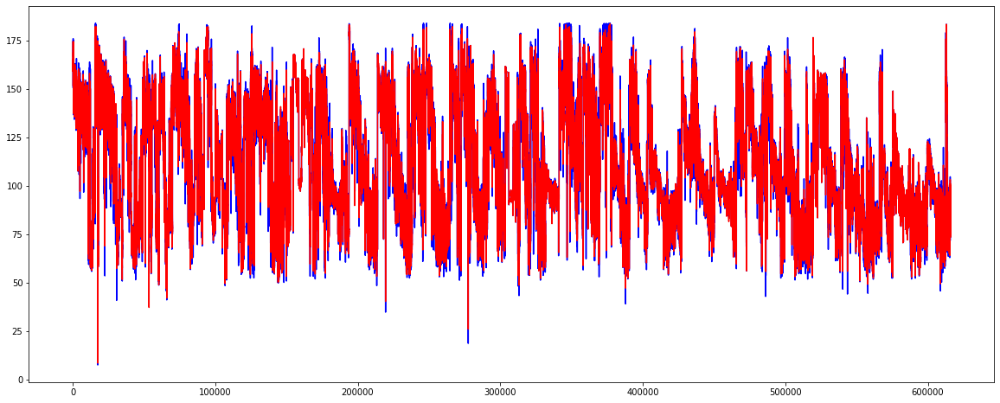

In [ ]:
%matplotlib inline

import matplotlib.pyplot as plt
# plt.xkcd()
# plt.style.use('ggplot')
%matplotlib inline

import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (20, 8)

plt.plot(data1.DTC, 'b')
plt.plot(Predicted_DTC.Label,'r')

####**Reconstructing Actual DTC using Predicting DTC**

In [ ]:
data1.DTC[data1[data1['DTC']<0.90*Predicted_DTC['Label']].index] = Predicted_DTC.Label[data1[data1['DTC']<0.90*Predicted_DTC['Label']].index]
data1.DTC[data1[data1['DTC']>1.10*Predicted_DTC['Label']].index] = Predicted_DTC.Label[data1[data1['DTC']>1.10*Predicted_DTC['Label']].index]

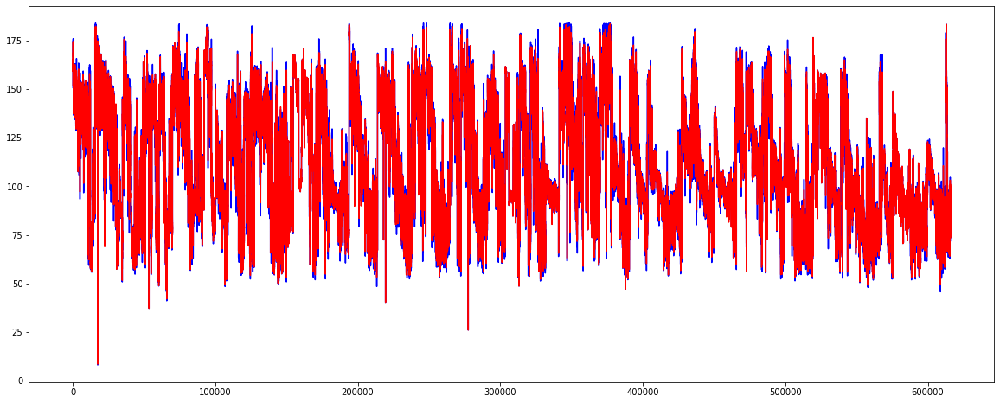

In [ ]:
%matplotlib inline

import matplotlib.pyplot as plt
# plt.xkcd()
# plt.style.use('ggplot')
%matplotlib inline

import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (20, 8)

plt.plot(data1.DTC, 'b')
plt.plot(Predicted_DTC.Label,'r')

# **Filling NaN values**

## **RHOB Model**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/DTC_badholeflag_nan_removed')

In [ ]:
X1 = data1[['DEPTH_MD','GROUP','FORMATION','FORCE_2020_LITHOFACIES_CONFIDENCE','GR','RDEP','RMED','DTC','RHOB','plot_size','cluster1_prob','cluster2_prob','cluster3_prob']]

In [ ]:
#Keeping only non NaN values of RDEP 
from pycaret.regression import *
exp_reg = setup(data = X1.dropna(subset = ['RHOB']),ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] },target = 'RHOB')

 
Setup Succesfully Completed.


,Description,Value
0,session_id,1339
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(478775, 13)"
4,Missing Values,False
5,Numeric Features,9
6,Categorical Features,3
7,Ordinal Features,True
8,High Cardinality Features,False
9,High Cardinality Method,None


In [ ]:
lgbm = create_model('lightgbm', fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0383,0.0031,0.0560,0.9268,0.0171,0.0169
1,0.0389,0.0032,0.0569,0.9249,0.0173,0.0171
2,0.0380,0.0031,0.0555,0.9287,0.0169,0.0167
3,0.0385,0.0032,0.0563,0.9258,0.0172,0.0169
4,0.0382,0.0032,0.0569,0.9243,0.0174,0.0168
5,0.0385,0.0032,0.0567,0.9238,0.0173,0.0169
6,0.0381,0.0031,0.0559,0.9270,0.0170,0.0167
7,0.0385,0.0032,0.0570,0.9245,0.0174,0.0169
8,0.0386,0.0032,0.0569,0.9244,0.0173,0.0170
9,0.0384,0.0031,0.0560,0.9272,0.0170,0.0169


In [ ]:
import numpy as np
lgbm_params = {'num_leaves': np.arange(10,300,10),
                        'max_depth': [int(x) for x in np.linspace(10, 220, num = 11)],
                        'learning_rate': np.arange(0.1,2,0.1)
                        }

In [ ]:
tuned_lgbm = tune_model(lgbm,custom_grid = lgbm_params, fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0283,0.0019,0.0432,0.9564,0.0131,0.0124
1,0.0283,0.0020,0.0442,0.9548,0.0134,0.0124
2,0.0280,0.0019,0.0431,0.9570,0.0131,0.0122
3,0.0281,0.0019,0.0433,0.9561,0.0131,0.0123
4,0.0279,0.0019,0.0438,0.9551,0.0133,0.0122
5,0.0279,0.0019,0.0434,0.9553,0.0132,0.0122
6,0.0280,0.0019,0.0430,0.9568,0.0131,0.0122
7,0.0279,0.0018,0.0430,0.9571,0.0131,0.0122
8,0.0282,0.0019,0.0440,0.9549,0.0134,0.0123
9,0.0276,0.0018,0.0425,0.9579,0.0129,0.0121


In [ ]:
boosted_lgbm = ensemble_model(tuned_lgbm, method = 'Boosting', fold=14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0254,0.0015,0.0383,0.9657,0.0116,0.0111
1,0.0257,0.0016,0.0396,0.9636,0.0120,0.0113
2,0.0252,0.0015,0.0383,0.9661,0.0116,0.0110
3,0.0256,0.0015,0.0386,0.9651,0.0117,0.0112
4,0.0254,0.0015,0.0392,0.9641,0.0119,0.0111
5,0.0255,0.0015,0.0392,0.9636,0.0119,0.0112
6,0.0252,0.0015,0.0381,0.9660,0.0116,0.0110
7,0.0254,0.0015,0.0383,0.9659,0.0116,0.0111
8,0.0257,0.0016,0.0395,0.9635,0.0120,0.0112
9,0.0254,0.0015,0.0389,0.9647,0.0118,0.0111


In [ ]:
#save_model(boosted_lgbm,'/content/drive/My Drive/Colab Notebooks/lgbm_RHOB_nan_model')

Transformation Pipeline and Model Succesfully Saved


In [ ]:
rf = create_model('rf',fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0205,0.0013,0.0364,0.9689,0.0111,0.0090
1,0.0201,0.0012,0.0347,0.9718,0.0105,0.0088
2,0.0205,0.0013,0.0356,0.9707,0.0108,0.0089
3,0.0203,0.0012,0.0353,0.9709,0.0107,0.0089
4,0.0205,0.0013,0.0356,0.9704,0.0108,0.0090
5,0.0204,0.0013,0.0366,0.9689,0.0111,0.0089
6,0.0205,0.0013,0.0359,0.9699,0.0109,0.0090
7,0.0211,0.0015,0.0385,0.9652,0.0117,0.0092
8,0.0208,0.0014,0.0369,0.9683,0.0112,0.0091
9,0.0205,0.0012,0.0351,0.9713,0.0107,0.0090


###**Predicting RHOB NaN values**

In [ ]:
lgbm = load_model('/content/drive/My Drive/Colab Notebooks/lgbm_RHOB_nan_model')

Transformation Pipeline and Model Sucessfully Loaded


In [ ]:
rhob_null_data = data1[data1['RHOB'].isnull()]

In [ ]:
Predicted_RHOB = predict_model(lgbm, data = X1)

In [ ]:
Predicted_RHOB.index = X1.index

In [ ]:
data1.RHOB[rhob_null_data.index] = Predicted_RHOB.Label[rhob_null_data.index]

In [ ]:
#data1.to_csv('/content/drive/My Drive/Colab Notebooks/RHOB_nan_removed')

In [ ]:
data1.isna().any()

Unnamed: 0                           False
Unnamed: 0.1                         False
Unnamed: 0.1.1                       False
Unnamed: 0.1.1.1                     False
Unnamed: 0.1.1.1.1                   False
WELL                                 False
DEPTH_MD                             False
X_LOC                                 True
Y_LOC                                 True
Z_LOC                                 True
GROUP                                False
FORMATION                            False
CALI                                  True
RSHA                                  True
RMED                                 False
RDEP                                 False
RHOB                                 False
GR                                   False
SGR                                   True
NPHI                                  True
PEF                                   True
DTC                                  False
SP                                    True
BS         

## **SP Model**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/RHOB_nan_removed')

In [ ]:
X1 = data1[['DEPTH_MD','GROUP','FORMATION','FORCE_2020_LITHOFACIES_CONFIDENCE','GR','RDEP','RMED','DTC','RHOB','SP','plot_size','cluster1_prob','cluster2_prob','cluster3_prob']]

In [ ]:
#Keeping only non NaN values of RDEP 
from pycaret.regression import *
exp_reg = setup(data = X1.dropna(subset = ['SP']),ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] },target = 'SP')

 
Setup Succesfully Completed.


,Description,Value
0,session_id,5322
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(434383, 14)"
4,Missing Values,False
5,Numeric Features,10
6,Categorical Features,3
7,Ordinal Features,True
8,High Cardinality Features,False
9,High Cardinality Method,None


In [ ]:
lgbm = create_model('lightgbm', fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,5.3344,56.5128,7.5175,0.9356,0.2882,0.1167
1,5.3208,54.5127,7.3833,0.9374,0.2867,0.2343
2,5.3558,58.2544,7.6325,0.9336,0.2872,0.1013
3,5.3037,56.4561,7.5137,0.9351,0.2888,0.1112
4,5.3395,55.7753,7.4683,0.9349,0.2813,-0.2084
5,5.1627,52.9429,7.2762,0.9391,0.2830,0.2217
6,5.2055,54.7817,7.4015,0.9371,0.2862,0.2451
7,5.1841,53.5408,7.3172,0.9379,0.2794,0.1494
8,5.2703,55.9258,7.4784,0.9355,0.2849,0.1477
9,5.2836,55.5684,7.4544,0.9348,0.2998,0.0844


In [ ]:
import numpy as np
lgbm_params = {'num_leaves': np.arange(10,300,10),
                        'max_depth': [int(x) for x in np.linspace(10, 220, num = 11)],
                        'learning_rate': np.arange(0.1,2,0.1)
                        }

In [ ]:
tuned_lgbm = tune_model(lgbm,custom_grid = lgbm_params, fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,1.9891,11.5712,3.4016,0.9868,0.1389,0.0336
1,1.9582,10.9139,3.3036,0.9875,0.1395,0.0701
2,1.9539,11.1726,3.3425,0.9873,0.1291,0.0423
3,1.9544,10.9835,3.3141,0.9874,0.1327,0.0247
4,1.9627,10.6457,3.2628,0.9876,0.1371,0.0117
5,1.9361,10.6146,3.2580,0.9878,0.1410,0.0690
6,2.0005,11.6532,3.4137,0.9866,0.1385,0.0839
7,1.9277,10.2621,3.2035,0.9881,0.1364,0.0477
8,1.9585,11.5831,3.4034,0.9866,0.1355,0.0331
9,1.9989,11.0262,3.3206,0.9871,0.1379,0.0172


In [ ]:
boosted_lgbm = ensemble_model(tuned_lgbm, method = 'Boosting', fold=14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,1.7231,7.5641,2.7503,0.9914,0.1174,0.0298
1,1.7380,7.6704,2.7695,0.9912,0.1232,0.0708
2,1.7295,7.7125,2.7771,0.9912,0.1152,0.0334
3,1.7201,7.5453,2.7469,0.9913,0.1160,0.0347
4,1.7101,7.5342,2.7448,0.9912,0.1235,0.0393
5,1.6974,7.3095,2.7036,0.9916,0.1220,0.0468
6,1.7210,7.7670,2.7869,0.9911,0.1197,0.0464
7,1.7015,7.1276,2.6698,0.9917,0.1249,0.0394
8,1.7512,8.0111,2.8304,0.9908,0.1206,0.0226
9,1.7199,7.2876,2.6996,0.9915,0.1192,0.0153


In [ ]:
#save_model(boosted_lgbm,'/content/drive/My Drive/Colab Notebooks/lgbm_SP_nan_model')

Transformation Pipeline and Model Succesfully Saved


###**Predicting SP NaN values**

In [ ]:
lgbm = load_model('/content/drive/My Drive/Colab Notebooks/lgbm_SP_nan_model')

Transformation Pipeline and Model Sucessfully Loaded


In [ ]:
sp_null_data = data1[data1['SP'].isnull()]

In [ ]:
Predicted_SP = predict_model(lgbm, data = X1)

In [ ]:
Predicted_SP.index = X1.index

In [ ]:
data1.SP[sp_null_data.index] = Predicted_SP.Label[sp_null_data.index]

In [ ]:
#data1.to_csv('/content/drive/My Drive/Colab Notebooks/SP_nan_removed')

In [ ]:
data1 = data1.iloc[:,6:]
data1.isna().any()

WELL                                 False
DEPTH_MD                             False
X_LOC                                 True
Y_LOC                                 True
Z_LOC                                 True
GROUP                                False
FORMATION                            False
CALI                                  True
RSHA                                  True
RMED                                 False
RDEP                                 False
RHOB                                 False
GR                                   False
SGR                                   True
NPHI                                  True
PEF                                   True
DTC                                  False
SP                                   False
BS                                    True
ROP                                   True
DTS                                   True
DCAL                                  True
DRHO                                  True
MUDWEIGHT  

## **NPHI Model**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/SP_nan_removed')

In [ ]:
data1 = data1.iloc[:,6:]

In [ ]:
X1 = data1[['DEPTH_MD','GROUP','FORMATION','FORCE_2020_LITHOFACIES_CONFIDENCE','GR','RDEP','RMED','DTC','RHOB','SP','NPHI','plot_size','cluster1_prob','cluster2_prob','cluster3_prob']]

In [ ]:
#Keeping only non NaN values of RDEP 
from pycaret.regression import *
exp_reg = setup(data = X1.dropna(subset = ['NPHI']),ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] },target = 'NPHI')

 
Setup Succesfully Completed.


,Description,Value
0,session_id,7627
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(317348, 15)"
4,Missing Values,False
5,Numeric Features,11
6,Categorical Features,3
7,Ordinal Features,True
8,High Cardinality Features,False
9,High Cardinality Method,None


In [ ]:
lgbm = create_model('lightgbm', fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0228,0.0010,0.0315,0.8875,0.0249,0.1184
1,0.0229,0.0010,0.0314,0.8913,0.0247,0.0999
2,0.0229,0.0010,0.0315,0.8883,0.0248,0.1000
3,0.0229,0.0010,0.0315,0.8866,0.0248,0.1041
4,0.0228,0.0010,0.0312,0.8899,0.0246,0.0838
5,0.0230,0.0010,0.0317,0.8874,0.0249,0.1039
6,0.0227,0.0010,0.0317,0.8856,0.0250,26.6020
7,0.0230,0.0010,0.0316,0.8851,0.0249,0.0997
8,0.0230,0.0010,0.0319,0.8836,0.0252,0.0950
9,0.0228,0.0010,0.0315,0.8864,0.0248,25.9099


In [ ]:
import numpy as np
lgbm_params = {'num_leaves': np.arange(10,300,10),
                        'max_depth': [int(x) for x in np.linspace(10, 220, num = 11)],
                        'learning_rate': np.arange(0.1,2,0.1)
                        }

In [ ]:
tuned_lgbm = tune_model(lgbm,custom_grid = lgbm_params, fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0171,0.0006,0.0243,0.9331,0.0191,0.0864
1,0.0173,0.0006,0.0244,0.9343,0.0192,0.0877
2,0.0175,0.0006,0.0246,0.9317,0.0193,0.0738
3,0.0172,0.0006,0.0243,0.9324,0.0191,0.0737
4,0.0170,0.0006,0.0241,0.9345,0.0189,0.0716
5,0.0173,0.0006,0.0244,0.9330,0.0192,0.0744
6,0.0171,0.0006,0.0244,0.9320,0.0193,22.8379
7,0.0172,0.0006,0.0241,0.9334,0.0189,0.0734
8,0.0172,0.0006,0.0243,0.9326,0.0191,0.0720
9,0.0171,0.0006,0.0241,0.9334,0.0189,17.7331


In [ ]:
boosted_lgbm = ensemble_model(tuned_lgbm, method = 'Boosting', fold=14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0166,0.0005,0.0225,0.9425,0.0177,0.0837
1,0.0168,0.0005,0.0230,0.9416,0.0181,0.0851
2,0.0169,0.0005,0.0233,0.9390,0.0183,0.0714
3,0.0166,0.0005,0.0228,0.9404,0.0179,0.0717
4,0.0166,0.0005,0.0229,0.9407,0.0180,0.0675
5,0.0168,0.0005,0.0231,0.9403,0.0181,0.0719
6,0.0165,0.0005,0.0227,0.9414,0.0178,1.2804
7,0.0167,0.0005,0.0227,0.9407,0.0178,0.0716
8,0.0166,0.0005,0.0228,0.9407,0.0179,0.0669
9,0.0166,0.0005,0.0225,0.9419,0.0176,4.0892


In [ ]:
etr = create_model('et', fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0125,0.0004,0.0193,0.9580,0.0152,0.0762
1,0.0128,0.0004,0.0196,0.9567,0.0155,0.0579
2,0.0128,0.0004,0.0199,0.9556,0.0156,0.0738
3,0.0124,0.0004,0.0189,0.9591,0.0148,0.0583
4,0.0125,0.0004,0.0195,0.9569,0.0154,0.0776
5,0.0126,0.0004,0.0194,0.9578,0.0153,0.0591
6,0.0126,0.0004,0.0191,0.9582,0.0150,0.0545
7,0.0128,0.0004,0.0197,0.9559,0.0155,0.0662
8,0.0127,0.0004,0.0194,0.9575,0.0152,0.0644
9,0.0126,0.0004,0.0194,0.9570,0.0153,0.0510


In [ ]:
save_model(boosted_lgbm,'/content/drive/My Drive/Colab Notebooks/lgbm_NPHI_nan_model')

Transformation Pipeline and Model Succesfully Saved


###**Predicting NPHI NaN values**

In [ ]:
lgbm = load_model('/content/drive/My Drive/Colab Notebooks/lgbm_NPHI_nan_model')

Transformation Pipeline and Model Sucessfully Loaded


In [ ]:
nphi_null_data = data1[data1['NPHI'].isnull()]

In [ ]:
Predicted_NPHI = predict_model(lgbm, data = X1)

In [ ]:
Predicted_NPHI.index = X1.index

In [ ]:
data1.NPHI[nphi_null_data.index] = Predicted_NPHI.Label[nphi_null_data.index]

In [ ]:
#data1.to_csv('/content/drive/My Drive/Colab Notebooks/NPHI_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]
data1.isna().any()

WELL                                 False
DEPTH_MD                             False
X_LOC                                 True
Y_LOC                                 True
Z_LOC                                 True
GROUP                                False
FORMATION                            False
CALI                                  True
RSHA                                  True
RMED                                 False
RDEP                                 False
RHOB                                 False
GR                                   False
SGR                                   True
NPHI                                 False
PEF                                   True
DTC                                  False
SP                                   False
BS                                    True
ROP                                   True
DTS                                   True
DCAL                                  True
DRHO                                  True
MUDWEIGHT  

## **PEF Model**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/NPHI_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]

In [ ]:
X1 = data1[['DEPTH_MD','GROUP','FORMATION','FORCE_2020_LITHOFACIES_CONFIDENCE','GR','RDEP','RMED','DTC','RHOB','SP','NPHI','PEF','plot_size','cluster1_prob','cluster2_prob','cluster3_prob']]

In [ ]:
#Keeping only non NaN values of RDEP 
from pycaret.regression import *
exp_reg = setup(data = X1.dropna(subset = ['PEF']),ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] },target = 'PEF')

 
Setup Succesfully Completed.


,Description,Value
0,session_id,2638
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(347844, 16)"
4,Missing Values,False
5,Numeric Features,12
6,Categorical Features,3
7,Ordinal Features,True
8,High Cardinality Features,False
9,High Cardinality Method,None


In [ ]:
lgbm = create_model('lightgbm', fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.5927,0.7455,0.8634,0.7255,0.1450,0.1420
1,0.5774,0.7006,0.8370,0.7289,0.1426,0.1380
2,0.5921,0.7431,0.8620,0.7250,0.1458,0.1412
3,0.5946,0.7402,0.8603,0.7292,0.1463,0.1442
4,0.5953,0.7505,0.8663,0.7224,0.1449,0.1387
5,0.5954,0.7335,0.8564,0.7309,0.1448,0.1413
6,0.5806,0.7085,0.8417,0.7276,0.1432,0.1395
7,0.6043,0.7535,0.8680,0.7303,0.1472,0.1427
8,0.5907,0.7222,0.8498,0.7308,0.1441,0.1409
9,0.5878,0.7154,0.8458,0.7361,0.1437,0.1426


In [ ]:
import numpy as np
lgbm_params = {'num_leaves': np.arange(10,300,10),
                        'max_depth': [int(x) for x in np.linspace(10, 220, num = 11)],
                        'learning_rate': np.arange(0.1,2,0.1)
                        }

In [ ]:
tuned_lgbm = tune_model(lgbm,custom_grid = lgbm_params, fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.3985,0.3832,0.6191,0.8589,0.1031,0.0904
1,0.3907,0.3693,0.6077,0.8571,0.1030,0.0898
2,0.3974,0.3787,0.6154,0.8598,0.1038,0.0910
3,0.3980,0.3766,0.6137,0.8622,0.1033,0.0930
4,0.4046,0.3895,0.6241,0.8559,0.1039,0.0910
5,0.4039,0.3857,0.6211,0.8585,0.1032,0.0907
6,0.3913,0.3633,0.6027,0.8604,0.1017,0.0898
7,0.3996,0.3786,0.6153,0.8645,0.1028,0.0904
8,0.3966,0.3808,0.6171,0.8581,0.1023,0.0899
9,0.3920,0.3622,0.6018,0.8664,0.1021,0.0910


In [ ]:
boosted_lgbm = ensemble_model(tuned_lgbm, method = 'Boosting', fold=14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.3686,0.3160,0.5621,0.8837,0.0933,0.0839
1,0.3626,0.3095,0.5563,0.8802,0.0940,0.0838
2,0.3707,0.3192,0.5650,0.8819,0.0949,0.0852
3,0.3668,0.3110,0.5577,0.8862,0.0941,0.0862
4,0.3735,0.3218,0.5673,0.8810,0.0944,0.0847
5,0.3728,0.3231,0.5684,0.8815,0.0943,0.0844
6,0.3656,0.3042,0.5515,0.8831,0.0930,0.0842
7,0.3693,0.3143,0.5606,0.8875,0.0942,0.0845
8,0.3703,0.3204,0.5661,0.8806,0.0944,0.0851
9,0.3637,0.2999,0.5476,0.8894,0.0921,0.0840


In [ ]:
rf = create_model('rf', fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.2899,0.2450,0.4950,0.9098,0.0799,0.0635
1,0.2865,0.2391,0.4890,0.9075,0.0803,0.0640
2,0.2938,0.2478,0.4978,0.9083,0.0816,0.0658
3,0.2900,0.2418,0.4917,0.9116,0.0803,0.0659
4,0.2979,0.2530,0.5030,0.9064,0.0813,0.0656
5,0.2992,0.2522,0.5022,0.9075,0.0808,0.0652
6,0.2871,0.2327,0.4824,0.9106,0.0785,0.0636
7,0.2944,0.2437,0.4937,0.9128,0.0797,0.0646
8,0.2924,0.2488,0.4988,0.9073,0.0803,0.0642
9,0.2872,0.2323,0.4819,0.9143,0.0790,0.0646


In [ ]:
etr = create_model('et', fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.2656,0.2114,0.4598,0.9222,0.0738,0.0579
1,0.2632,0.2067,0.4546,0.9200,0.0746,0.0587
2,0.2684,0.2143,0.4630,0.9207,0.0757,0.0601
3,0.2685,0.2169,0.4657,0.9207,0.0761,0.0613
4,0.2713,0.2157,0.4644,0.9202,0.0743,0.0591
5,0.2720,0.2180,0.4669,0.9200,0.0755,0.0593
6,0.2649,0.2053,0.4531,0.9211,0.0733,0.0581
7,0.2680,0.2087,0.4568,0.9253,0.0737,0.0587
8,0.2657,0.2160,0.4648,0.9195,0.0745,0.0585
9,0.2636,0.2013,0.4486,0.9258,0.0727,0.0586


In [ ]:
 save_model(boosted_lgbm,'/content/drive/My Drive/Colab Notebooks/lgbm_PEF_nan_model')

Transformation Pipeline and Model Succesfully Saved


###**Predicting PEF NaN values**

In [ ]:
lgbm = load_model('/content/drive/My Drive/Colab Notebooks/lgbm_NPHI_nan_model')

Transformation Pipeline and Model Sucessfully Loaded


In [ ]:
pef_null_data = data1[data1['PEF'].isnull()]

In [ ]:
Predicted_PEF = predict_model(etr, data = X1)

In [ ]:
Predicted_PEF.index = X1.index

In [ ]:
data1.PEF[pef_null_data.index] = Predicted_PEF.Label[pef_null_data.index]

In [ ]:
#data1.to_csv('/content/drive/My Drive/Colab Notebooks/PEF_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]
data1.isna().any()

WELL                                 False
DEPTH_MD                             False
X_LOC                                 True
Y_LOC                                 True
Z_LOC                                 True
GROUP                                False
FORMATION                            False
CALI                                  True
RSHA                                  True
RMED                                 False
RDEP                                 False
RHOB                                 False
GR                                   False
SGR                                   True
NPHI                                 False
PEF                                  False
DTC                                  False
SP                                   False
BS                                    True
ROP                                   True
DTS                                   True
DCAL                                  True
DRHO                                  True
MUDWEIGHT  

## **ROP Model**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/PEF_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]

In [ ]:
X1 = data1[['DEPTH_MD','GROUP','FORMATION','FORCE_2020_LITHOFACIES_CONFIDENCE','GR','RDEP','RMED','DTC','RHOB','SP','NPHI','PEF','ROP','plot_size','cluster1_prob','cluster2_prob','cluster3_prob']]

In [ ]:
#Keeping only non NaN values of RDEP 
from pycaret.regression import *
exp_reg = setup(data = X1.dropna(subset = ['ROP']),ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] },target = 'ROP')

 
Setup Succesfully Completed.


,Description,Value
0,session_id,5904
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(265393, 17)"
4,Missing Values,False
5,Numeric Features,13
6,Categorical Features,3
7,Ordinal Features,True
8,High Cardinality Features,False
9,High Cardinality Method,None


In [ ]:
lgbm = create_model('lightgbm', fold = 14, n_iter = 100)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,29.1564,50836.5225,225.4696,0.9679,0.8529,2.0679
1,31.9055,100904.6978,317.6550,0.9227,0.8734,2.4286
2,32.5550,55417.5107,235.4092,0.9610,0.8795,2.2520
3,35.5062,84757.3284,291.1311,0.9601,0.8862,2.2799
4,32.1632,86194.5396,293.5891,0.9408,0.8773,2.6042
5,35.6160,113887.3568,337.4720,0.9380,0.8668,2.2031
6,32.1088,71864.6309,268.0758,0.9505,0.8690,2.1771
7,32.4400,51577.9727,227.1078,0.9689,0.8742,2.1503
8,36.0999,106216.4799,325.9087,0.9411,0.8367,1.9685
9,37.0056,110684.9552,332.6935,0.9359,0.8921,2.4299


In [ ]:
import numpy as np
lgbm_params = {'num_leaves': np.arange(10,300,10),
                        'max_depth': [int(x) for x in np.linspace(10, 220, num = 11)],
                        'learning_rate': np.arange(0.1,2,0.1)
                        }

In [ ]:
tuned_lgbm = tune_model(lgbm,custom_grid = lgbm_params, fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,23.1271,41143.1668,202.8378,0.9740,0.5199,0.8252
1,25.3708,94605.8222,307.5806,0.9275,0.5183,1.0978
2,25.0552,48865.1609,221.0547,0.9656,0.5069,0.7550
3,27.3305,66816.9843,258.4898,0.9685,0.5194,0.7740
4,24.4871,65033.1131,255.0159,0.9554,0.5206,1.2150
5,29.1212,111146.0511,333.3857,0.9395,0.5083,0.7228
6,25.6672,75815.3168,275.3458,0.9478,0.5105,0.8415
7,26.3516,54606.0111,233.6793,0.9671,0.5034,0.7160
8,27.5036,78661.4517,280.4665,0.9564,0.4804,0.7828
9,29.6298,100593.4517,317.1647,0.9417,0.4964,0.7573


In [ ]:
boosted_lgbm = ensemble_model(tuned_lgbm, method = 'Boosting', fold=14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,19.9569,20649.3613,143.6989,0.9870,0.5026,0.7585
1,23.1719,66004.5109,256.9134,0.9495,0.4949,0.7068
2,22.6169,41796.4026,204.4417,0.9706,0.4919,0.6996
3,22.9965,47347.2531,217.5942,0.9777,0.4918,0.7115
4,21.0767,31285.5782,176.8773,0.9785,0.4897,1.2283
5,24.1468,81538.2528,285.5490,0.9556,0.4877,0.6819
6,21.7963,39594.2462,198.9830,0.9727,0.4933,0.7670
7,23.3048,36734.7618,191.6631,0.9779,0.5000,0.7118
8,24.0096,49171.5879,221.7467,0.9727,0.4835,0.6760
9,27.5905,95116.5885,308.4098,0.9449,0.4914,0.7129


In [ ]:
 save_model(boosted_lgbm,'/content/drive/My Drive/Colab Notebooks/lgbm_ROP_nan_model')

Transformation Pipeline and Model Succesfully Saved


###**Predicting ROP NaN values**

In [ ]:
lgbm = load_model('/content/drive/My Drive/Colab Notebooks/lgbm_ROP_nan_model')

Transformation Pipeline and Model Sucessfully Loaded


In [ ]:
rop_null_data = data1[data1['ROP'].isnull()]

In [ ]:
Predicted_ROP = predict_model(lgbm, data = X1)

In [ ]:
Predicted_ROP.index = X1.index

In [ ]:
data1.ROP[rop_null_data.index] = Predicted_ROP.Label[rop_null_data.index]

In [ ]:
#data1.to_csv('/content/drive/My Drive/Colab Notebooks/ROP_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]
data1.isna().any()

WELL                                 False
DEPTH_MD                             False
X_LOC                                 True
Y_LOC                                 True
Z_LOC                                 True
GROUP                                False
FORMATION                            False
CALI                                  True
RSHA                                  True
RMED                                 False
RDEP                                 False
RHOB                                 False
GR                                   False
SGR                                   True
NPHI                                 False
PEF                                  False
DTC                                  False
SP                                   False
BS                                    True
ROP                                  False
DTS                                   True
DCAL                                  True
DRHO                                  True
MUDWEIGHT  

## **DRHO Model**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/ROP_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]

In [ ]:
X1 = data1[['DEPTH_MD','GROUP','FORMATION','FORCE_2020_LITHOFACIES_CONFIDENCE','GR','RDEP','RMED','DTC','RHOB','SP','NPHI','PEF','ROP','DRHO','plot_size','cluster1_prob','cluster2_prob','cluster3_prob']]

In [ ]:
#Keeping only non NaN values of RDEP 
from pycaret.regression import *
exp_reg = setup(data = X1.dropna(subset = ['DRHO']),ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] },target = 'DRHO')

 
Setup Succesfully Completed.


,Description,Value
0,session_id,6887
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(505534, 18)"
4,Missing Values,False
5,Numeric Features,14
6,Categorical Features,3
7,Ordinal Features,True
8,High Cardinality Features,False
9,High Cardinality Method,None


In [ ]:
lgbm = create_model('lightgbm', fold = 14, n_iter = 100)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0122,0.0004,0.0202,0.8439,0.0172,1.6759
1,0.0123,0.0004,0.0194,0.8652,0.0165,0.2576
2,0.0123,0.0004,0.0205,0.8664,0.0170,0.2290
3,0.0122,0.0004,0.0200,0.8723,0.0169,2.5306
4,0.0122,0.0005,0.0222,0.8563,0.0177,0.8022
5,0.0123,0.0005,0.0216,0.8521,0.0173,0.2511
6,0.0122,0.0004,0.0204,0.8608,0.0168,-0.5981
7,0.0121,0.0004,0.0208,0.8531,0.0170,-1.2873
8,0.0125,0.0006,0.0243,0.8354,0.0188,-2.5390
9,0.0122,0.0004,0.0198,0.8477,0.0167,0.0612


In [ ]:
import numpy as np
lgbm_params = {'num_leaves': np.arange(10,300,10),
                        'max_depth': [int(x) for x in np.linspace(10, 220, num = 11)],
                        'learning_rate': np.arange(0.1,2,0.1)
                        }

In [ ]:
tuned_lgbm = tune_model(lgbm,custom_grid = lgbm_params, fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0091,0.0003,0.0162,0.8991,0.0133,1.9815
1,0.0091,0.0002,0.0155,0.9144,0.0129,-0.2013
2,0.0092,0.0003,0.0175,0.9025,0.0138,0.1688
3,0.0092,0.0003,0.0164,0.9141,0.0135,8.1236
4,0.0090,0.0003,0.0177,0.9093,0.0138,0.3951
5,0.0090,0.0003,0.0161,0.9179,0.0130,0.3402
6,0.0091,0.0002,0.0157,0.9180,0.0127,-0.6132
7,0.0090,0.0002,0.0152,0.9212,0.0126,0.1559
8,0.0092,0.0003,0.0176,0.9136,0.0137,-4.2971
9,0.0090,0.0002,0.0157,0.9051,0.0129,0.0985


In [ ]:
boosted_lgbm = ensemble_model(tuned_lgbm, method = 'Boosting', fold=14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0084,0.0002,0.0149,0.9149,0.0123,0.6771
1,0.0085,0.0002,0.0152,0.9175,0.0126,0.5099
2,0.0085,0.0002,0.0151,0.9276,0.0122,-0.0119
3,0.0085,0.0002,0.0147,0.9311,0.0123,6.9855
4,0.0084,0.0003,0.0174,0.9116,0.0132,0.7522
5,0.0084,0.0002,0.0149,0.9301,0.0121,-0.0134
6,0.0084,0.0002,0.0130,0.9439,0.0112,-0.6077
7,0.0083,0.0002,0.0133,0.9397,0.0114,0.0459
8,0.0084,0.0002,0.0134,0.9504,0.0113,-3.7248
9,0.0083,0.0002,0.0135,0.9294,0.0116,0.0724


In [ ]:
 save_model(boosted_lgbm,'/content/drive/My Drive/Colab Notebooks/lgbm_DRHO_nan_model')

Transformation Pipeline and Model Succesfully Saved


###**Predicting DRHO NaN values**

In [ ]:
lgbm = load_model('/content/drive/My Drive/Colab Notebooks/lgbm_DRHO_nan_model')

Transformation Pipeline and Model Sucessfully Loaded


In [ ]:
drho_null_data = data1[data1['DRHO'].isnull()]

In [ ]:
Predicted_DRHO = predict_model(lgbm, data = X1)

In [ ]:
Predicted_DRHO.index = X1.index

In [ ]:
data1.DRHO[drho_null_data.index] = Predicted_DRHO.Label[drho_null_data.index]

In [ ]:
#data1.to_csv('/content/drive/My Drive/Colab Notebooks/DRHO_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]
data1.isna().any()

WELL                                 False
DEPTH_MD                             False
X_LOC                                 True
Y_LOC                                 True
Z_LOC                                 True
GROUP                                False
FORMATION                            False
CALI                                  True
RSHA                                  True
RMED                                 False
RDEP                                 False
RHOB                                 False
GR                                   False
SGR                                   True
NPHI                                 False
PEF                                  False
DTC                                  False
SP                                   False
BS                                    True
ROP                                  False
DTS                                   True
DCAL                                  True
DRHO                                 False
MUDWEIGHT  

## **RXO Model**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/DRHO_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]

In [ ]:
X1 = data1[['DEPTH_MD','GROUP','FORMATION','FORCE_2020_LITHOFACIES_CONFIDENCE','GR','RDEP','RMED','DTC','RHOB','SP','NPHI','PEF','ROP','DRHO','RXO','plot_size','cluster1_prob','cluster2_prob','cluster3_prob']]

In [ ]:
#Keeping only non NaN values of RDEP 
from pycaret.regression import *
exp_reg = setup(data = X1.dropna(subset = ['RXO']),ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] },target = 'RXO')

 
Setup Succesfully Completed.


,Description,Value
0,session_id,7706
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(160553, 19)"
4,Missing Values,False
5,Numeric Features,15
6,Categorical Features,3
7,Ordinal Features,True
8,High Cardinality Features,False
9,High Cardinality Method,None


In [ ]:
lgbm = create_model('lightgbm', fold = 14, cross_validation = True)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,5.8610,1540.9257,39.2546,0.9844,0.6315,2.2042
1,5.8814,1238.5549,35.1931,0.9883,0.6257,1.9457
2,6.1929,3152.1650,56.1441,0.9669,0.6305,1.9437
3,6.4738,2400.0608,48.9904,0.9761,0.6369,1.9068
4,5.3325,1141.5771,33.7872,0.9890,0.6400,1.8947
5,7.4478,3442.3021,58.6711,0.9674,0.6624,2.0921
6,5.6633,1359.6645,36.8736,0.9875,0.6429,1.9575
7,5.9206,1561.6087,39.5172,0.9852,0.6361,2.0884
8,7.0463,2156.8197,46.4416,0.9804,0.6583,2.7671
9,6.4843,2562.5411,50.6215,0.9722,0.6566,2.5775


In [ ]:
import numpy as np
lgbm_params = {'num_leaves': np.arange(10,300,10),
                        'max_depth': [int(x) for x in np.linspace(10, 220, num = 11)],
                        'learning_rate': np.arange(0.1,2,0.1)
                        }

In [ ]:
tuned_lgbm = tune_model(lgbm,custom_grid = lgbm_params, fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,5.8166,1274.5304,35.7006,0.9871,0.7047,2.2857
1,5.8951,820.1368,28.6380,0.9922,0.7084,2.0401
2,6.5011,2920.6089,54.0427,0.9693,0.6999,2.1175
3,6.7787,2032.9094,45.0878,0.9798,0.7269,2.1718
4,6.1568,1431.7370,37.8383,0.9863,0.7617,2.5598
5,7.3790,2615.6279,51.1432,0.9753,0.7544,2.4539
6,5.3915,868.8107,29.4756,0.9920,0.6966,2.0627
7,6.3438,1773.7070,42.1154,0.9832,0.7331,2.4583
8,7.4248,1980.1084,44.4984,0.9820,0.7290,2.7441
9,6.9201,2268.3450,47.6271,0.9754,0.7428,2.6690


In [ ]:
boosted_lgbm = ensemble_model(tuned_lgbm, method = 'Boosting', fold=14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,3.1994,1249.3281,35.3458,0.9873,0.4145,0.6884
1,2.3389,374.7132,19.3575,0.9965,0.3740,0.6167
2,3.2362,1793.9238,42.3547,0.9812,0.4060,0.7019
3,3.3595,1777.5219,42.1607,0.9823,0.3915,0.6252
4,2.4347,446.0566,21.1201,0.9957,0.4057,0.7788
5,3.6433,1809.3276,42.5362,0.9829,0.4286,0.9226
6,2.6007,1037.2996,32.2071,0.9905,0.4176,0.7507
7,3.3290,1600.1049,40.0013,0.9848,0.3963,0.6563
8,3.3189,1031.6337,32.1191,0.9906,0.4237,0.9343
9,3.2063,1458.3743,38.1887,0.9842,0.4236,0.7048


In [ ]:
 save_model(boosted_lgbm,'/content/drive/My Drive/Colab Notebooks/lgbm_RXO_nan_model')

Transformation Pipeline and Model Succesfully Saved


###**Predicting RXO NaN values**

In [ ]:
lgbm = load_model('/content/drive/My Drive/Colab Notebooks/lgbm_RXO_nan_model')

Transformation Pipeline and Model Sucessfully Loaded


In [ ]:
rxo_null_data = data1[data1['RXO'].isnull()]

In [ ]:
Predicted_RXO = predict_model(lgbm, data = X1)

In [ ]:
Predicted_RXO.index = X1.index

In [ ]:
data1.RXO[rxo_null_data.index] = Predicted_RXO.Label[rxo_null_data.index]

In [ ]:
#data1.to_csv('/content/drive/My Drive/Colab Notebooks/RXO_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]
data1.isna().any()

WELL                                 False
DEPTH_MD                             False
X_LOC                                 True
Y_LOC                                 True
Z_LOC                                 True
GROUP                                False
FORMATION                            False
CALI                                  True
RSHA                                  True
RMED                                 False
RDEP                                 False
RHOB                                 False
GR                                   False
SGR                                   True
NPHI                                 False
PEF                                  False
DTC                                  False
SP                                   False
BS                                    True
ROP                                  False
DTS                                   True
DCAL                                  True
DRHO                                 False
MUDWEIGHT  

## **MUDWEIGHT Model**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/RXO_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]

In [ ]:
X1 = data1[['DEPTH_MD','GROUP','FORMATION','FORCE_2020_LITHOFACIES_CONFIDENCE','GR','RDEP','RMED','DTC','RHOB','SP','NPHI','PEF','ROP','DRHO','RXO','MUDWEIGHT','plot_size','cluster1_prob','cluster2_prob','cluster3_prob']]

In [ ]:
#Keeping only non NaN values of RDEP 
from pycaret.regression import *
exp_reg = setup(data = X1.dropna(subset = ['MUDWEIGHT']),numeric_features = ['cluster1_prob','cluster2_prob'],ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] },target = 'MUDWEIGHT')

 
Setup Succesfully Completed.


,Description,Value
0,session_id,1086
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(132476, 20)"
4,Missing Values,False
5,Numeric Features,16
6,Categorical Features,3
7,Ordinal Features,True
8,High Cardinality Features,False
9,High Cardinality Method,None


In [ ]:
lgbm = create_model('lightgbm', fold = 14, cross_validation = True)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0245,0.0035,0.0587,0.9999,0.0350,0.0952
1,0.0261,0.0039,0.0627,0.9999,0.0394,0.1014
2,0.0247,0.0029,0.0541,1.0000,0.0339,0.0966
3,0.0246,0.0031,0.0559,1.0000,0.0346,0.0963
4,0.0243,0.0028,0.0530,1.0000,0.0350,0.0972
5,0.0263,0.0040,0.0635,0.9999,0.0414,0.1070
6,0.0254,0.0034,0.0579,1.0000,0.0373,0.1014
7,0.0245,0.0029,0.0538,0.9999,0.0347,0.0961
8,0.0254,0.0033,0.0578,0.9999,0.0372,0.1008
9,0.0239,0.0030,0.0545,0.9999,0.0345,0.0928


In [ ]:
import numpy as np
lgbm_params = {'num_leaves': np.arange(10,300,10),
                        'max_depth': [int(x) for x in np.linspace(10, 220, num = 11)],
                        'learning_rate': np.arange(0.1,2,0.1)
                        }

In [ ]:
tuned_lgbm = tune_model(lgbm,custom_grid = lgbm_params, fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0098,0.0018,0.0422,1.0000,0.0225,0.0356
1,0.0105,0.0014,0.0379,1.0000,0.0240,0.0426
2,0.0096,0.0009,0.0299,1.0000,0.0189,0.0377
3,0.0096,0.0013,0.0354,1.0000,0.0207,0.0361
4,0.0092,0.0010,0.0312,1.0000,0.0187,0.0355
5,0.0106,0.0016,0.0400,1.0000,0.0253,0.0429
6,0.0099,0.0014,0.0373,1.0000,0.0229,0.0366
7,0.0095,0.0012,0.0352,1.0000,0.0218,0.0355
8,0.0092,0.0010,0.0309,1.0000,0.0192,0.0357
9,0.0086,0.0008,0.0274,1.0000,0.0171,0.0333


In [ ]:
boosted_lgbm = ensemble_model(tuned_lgbm, method = 'Boosting', fold=14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0030,0.0003,0.0178,1.0000,0.0095,0.0109
1,0.0033,0.0003,0.0159,1.0000,0.0112,0.0138
2,0.0029,0.0001,0.0109,1.0000,0.0074,0.0114
3,0.0027,0.0003,0.0172,1.0000,0.0112,0.0107
4,0.0028,0.0001,0.0122,1.0000,0.0075,0.0106
5,0.0030,0.0003,0.0164,1.0000,0.0111,0.0127
6,0.0027,0.0002,0.0126,1.0000,0.0086,0.0104
7,0.0031,0.0001,0.0120,1.0000,0.0069,0.0109
8,0.0029,0.0003,0.0177,1.0000,0.0115,0.0117
9,0.0027,0.0001,0.0106,1.0000,0.0074,0.0109


In [ ]:
 save_model(boosted_lgbm,'/content/drive/My Drive/Colab Notebooks/lgbm_MUDWEIGHT_nan_model')

Transformation Pipeline and Model Succesfully Saved


###**Predicting MUDWEIGHT NaN values**

In [ ]:
lgbm = load_model('/content/drive/My Drive/Colab Notebooks/lgbm_MUDWEIGHT_nan_model')

Transformation Pipeline and Model Sucessfully Loaded


In [ ]:
mudweight_null_data = data1[data1['MUDWEIGHT'].isnull()]

In [ ]:
Predicted_MUDWEIGHT = predict_model(lgbm, data = X1)

In [ ]:
Predicted_MUDWEIGHT.index = X1.index

In [ ]:
data1.MUDWEIGHT[mudweight_null_data.index] = Predicted_MUDWEIGHT.Label[mudweight_null_data.index]

In [ ]:
#data1.to_csv('/content/drive/My Drive/Colab Notebooks/MUDWEIGHT_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]
data1.isna().any()

WELL                                 False
DEPTH_MD                             False
X_LOC                                 True
Y_LOC                                 True
Z_LOC                                 True
GROUP                                False
FORMATION                            False
CALI                                  True
RSHA                                  True
RMED                                 False
RDEP                                 False
RHOB                                 False
GR                                   False
SGR                                   True
NPHI                                 False
PEF                                  False
DTC                                  False
SP                                   False
BS                                    True
ROP                                  False
DTS                                   True
DCAL                                  True
DRHO                                 False
MUDWEIGHT  

## **RMIC Model**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/MUDWEIGHT_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]

In [ ]:
X1 = data1[['DEPTH_MD','GROUP','FORMATION','FORCE_2020_LITHOFACIES_CONFIDENCE','GR','RDEP','RMED','DTC','RHOB','SP','NPHI','PEF','ROP','DRHO','RXO','MUDWEIGHT','RMIC','plot_size','cluster1_prob','cluster2_prob','cluster3_prob']]

In [ ]:
#Keeping only non NaN values of RDEP 
from pycaret.regression import *
exp_reg = setup(data = X1.dropna(subset = ['RMIC']),numeric_features = ['cluster1_prob','cluster2_prob'],ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] },target = 'RMIC')

 
Setup Succesfully Completed.


,Description,Value
0,session_id,8761
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(57844, 21)"
4,Missing Values,False
5,Numeric Features,17
6,Categorical Features,3
7,Ordinal Features,True
8,High Cardinality Features,False
9,High Cardinality Method,None


In [ ]:
lgbm = create_model('lightgbm', fold = 14, cross_validation = True)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,2.7008,487.3995,22.0771,0.9657,0.3495,0.5141
1,3.7507,2972.3094,54.5189,0.4711,0.3285,0.3616
2,1.8499,84.4080,9.1874,0.9871,0.3242,0.4728
3,2.1065,297.4691,17.2473,0.9611,0.3389,0.4508
4,3.5344,2882.8323,53.6920,0.5939,0.3670,0.5250
5,2.3513,453.7595,21.3016,0.9552,0.3366,0.4700
6,2.1833,552.0233,23.4952,0.8468,0.3472,0.5634
7,2.5747,352.8035,18.7831,0.9831,0.3418,0.4920
8,2.0057,108.5364,10.4181,0.9937,0.3467,0.5584
9,1.9132,125.4435,11.2002,0.9857,0.3273,0.5014


In [ ]:
import numpy as np
lgbm_params = {'num_leaves': np.arange(10,300,10),
                        'max_depth': [int(x) for x in np.linspace(10, 220, num = 11)],
                        'learning_rate': np.arange(0.1,2,0.1)
                        }

In [ ]:
tuned_lgbm = tune_model(lgbm,custom_grid = lgbm_params, fold = 14)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,2.8119,692.7263,26.3197,0.9513,0.3551,0.4999
1,3.6323,2886.7644,53.7286,0.4863,0.3067,0.3223
2,1.7861,104.6061,10.2277,0.9840,0.3399,0.4349
3,2.1653,410.9497,20.2719,0.9463,0.3296,0.4039
4,3.4504,2672.4054,51.6953,0.6235,0.3731,0.4538
5,2.6052,621.4973,24.9298,0.9387,0.3740,0.5026
6,2.0666,418.5748,20.4591,0.8838,0.3546,0.4497
7,2.7509,396.1667,19.9039,0.9811,0.3702,0.5129
8,2.1410,141.5205,11.8962,0.9918,0.3510,0.4796
9,2.1595,222.7580,14.9251,0.9746,0.3437,0.4892


In [ ]:
#save_model(tuned_lgbm,'/content/drive/My Drive/Colab Notebooks/lgbm_RMIC_nan_model')

Transformation Pipeline and Model Succesfully Saved


###**Predicting RMIC NaN values**

In [ ]:
lgbm = load_model('/content/drive/My Drive/Colab Notebooks/lgbm_RMIC_nan_model')

Transformation Pipeline and Model Sucessfully Loaded


In [ ]:
rmic_null_data = data1[data1['RMIC'].isnull()]

In [ ]:
Predicted_RMIC = predict_model(lgbm, data = X1)

In [ ]:
Predicted_RMIC.index = X1.index

In [ ]:
data1.RMIC[rmic_null_data.index] = Predicted_RMIC.Label[rmic_null_data.index]

In [ ]:
#data1.to_csv('/content/drive/My Drive/Colab Notebooks/RMIC_nan_removed')

In [ ]:
data1 = data1.iloc[:,1:]
data1.isna().any()

WELL                                 False
DEPTH_MD                             False
X_LOC                                 True
Y_LOC                                 True
Z_LOC                                 True
GROUP                                False
FORMATION                            False
CALI                                  True
RSHA                                  True
RMED                                 False
RDEP                                 False
RHOB                                 False
GR                                   False
SGR                                   True
NPHI                                 False
PEF                                  False
DTC                                  False
SP                                   False
BS                                    True
ROP                                  False
DTS                                   True
DCAL                                  True
DRHO                                 False
MUDWEIGHT  

# **Outlier Detection**

Based on Clustering

##**Before OD**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/RMIC_nan_removed')

In [ ]:
df1 = data1.copy()

CPU times: user 3min 30s, sys: 4.57 s, total: 3min 34s
Wall time: 3min 34s


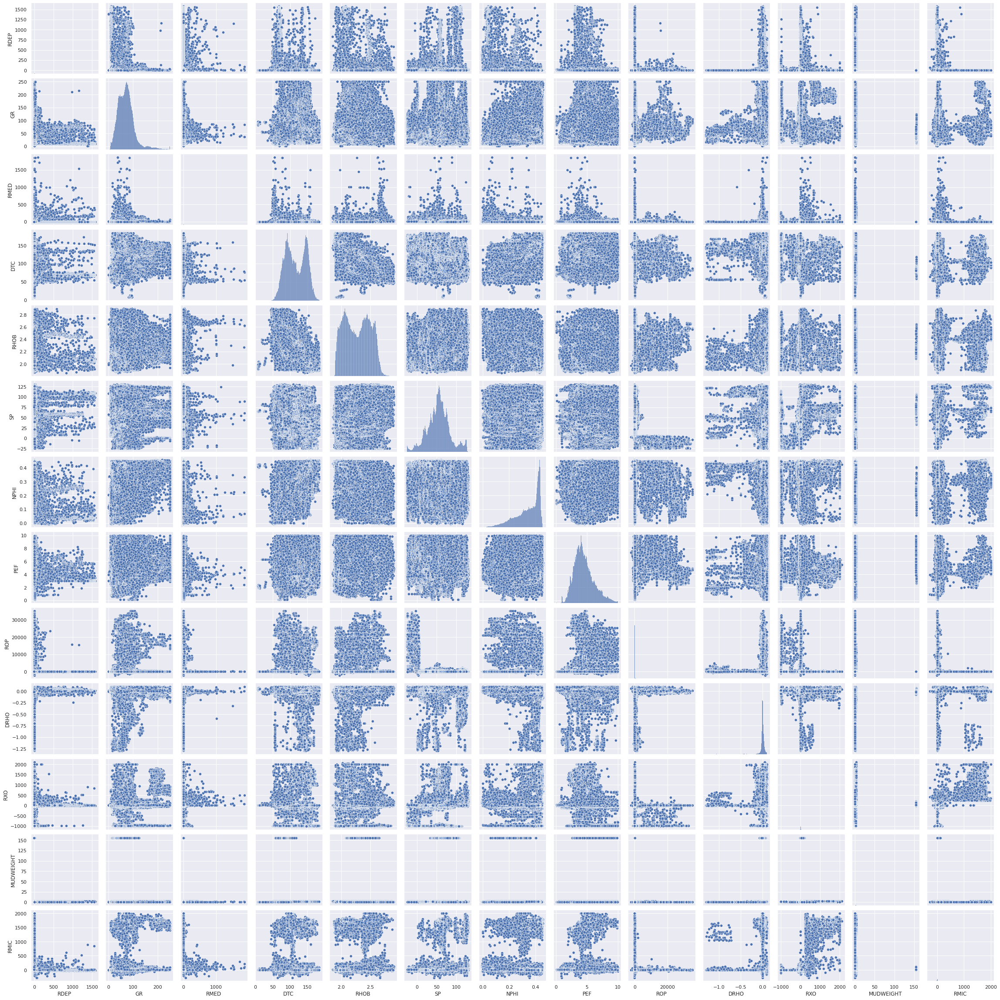

In [ ]:
%%time
import seaborn as sns
sns.set()
sns.pairplot(df1[['RDEP','GR','RMED','DTC','RHOB','SP','NPHI','PEF','ROP','DRHO','RXO','MUDWEIGHT','RMIC']], palette='husl')

##**RHOB vs DTC**

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


OUTLIERS :  12315 INLIERS :  603522 Isolation Forest


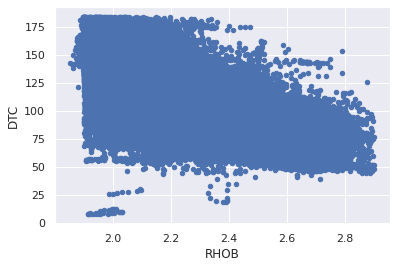

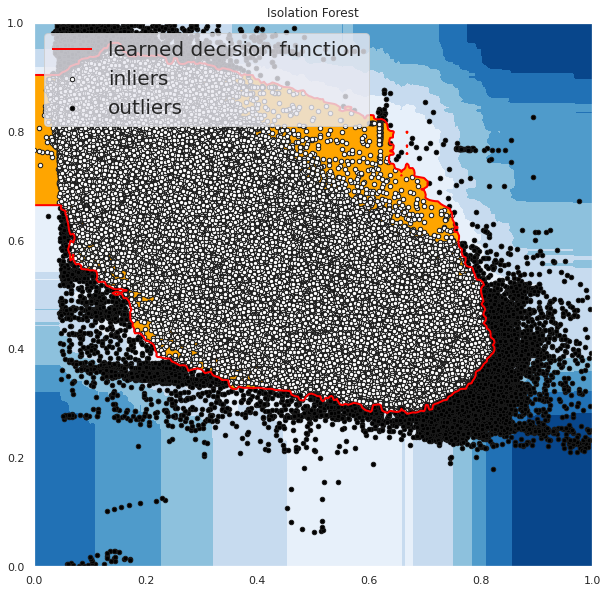

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.font_manager
import matplotlib.pyplot as plt

# Import models
from pyod.models.abod import ABOD
#from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.ocsvm import OCSVM
from pyod.models.sos import SOS
#from pyod.models.lscp import LSCP
from pyod.models.loda import LODA
from pyod.models.so_gaal import SO_GAAL
from scipy import stats

df1.plot.scatter('RHOB','DTC')

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0, 1))
df1[['RHOB','DTC']] = scaler.fit_transform(df1[['RHOB','DTC']])
df1[['RHOB','DTC']].head()

X1 = df1['RHOB'].values.reshape(-1,1)
X2 = df1['DTC'].values.reshape(-1,1)

X = np.concatenate((X1,X2),axis=1)
random_state = np.random.RandomState(42)
outliers_fraction = 0.02
# Define seven outlier detection tools to be compared
classifiers = {
        #'Cluster-based Local Outlier Factor (CBLOF)':CBLOF(contamination=outliers_fraction,check_estimator=False, random_state=random_state),
        'Isolation Forest': IForest(contamination=outliers_fraction,random_state=random_state),
        #'Angle-based Outlier Detector (ABOD)': ABOD(contamination=outliers_fraction),
        #'Single-Objective Generative Adversarial Active Learning (SO_GAAL)': SO_GAAL(contamination=outliers_fraction, epoch = 1),
        #'Average KNN': KNN(method='mean',contamination=outliers_fraction),
        #'K Nearest Neighbors (KNN)': KNN(contamination=outliers_fraction),
        #'Local Outlier Factor (LOF)': LOF(n_neighbors=35, contamination=outliers_fraction),
        #'LSCP: Locally Selective Combination of Parallel Outlier Ensembles': LSCP(contamination=outliers_fraction),
        #'Lightweight On-line Detector of Anomalies': LODA(contamination=outliers_fraction),
        #'Feature Bagging': FeatureBagging(LOF(n_neighbors=35),contamination=outliers_fraction,random_state=random_state),
        #'Histogram-base Outlier Detection (HBOS)': HBOS(contamination=outliers_fraction),
      
        #'One-class SVM (OCSVM)': OCSVM(contamination=outliers_fraction),
        #'Principal Component Analysis (PCA)': PCA(contamination=outliers_fraction, random_state=random_state)
        #'OCSVM': OCSVM(kernel='rbf', degree=3, gamma='auto', coef0=0.0, tol=0.001, nu=0.5, shrinking=True, cache_size=200, verbose=False, max_iter=- 1, contamination=0.1)
}

xx , yy = np.meshgrid(np.linspace(0,1 , 200), np.linspace(0, 1, 200))

for i, (clf_name, clf) in enumerate(classifiers.items()):
    clf.fit(X)
    # predict raw anomaly score
    scores_pred = clf.decision_function(X) * -1
        
    # prediction of a datapoint category outlier or inlier
    y_pred = clf.predict(X)
    n_inliers = len(y_pred) - np.count_nonzero(y_pred)
    n_outliers = np.count_nonzero(y_pred == 1)
    plt.figure(figsize=(10, 10))
    
    # copy of dataframe
    dfx = df1
    dfx['outlier'] = y_pred.tolist()
    
    # IX1 - inlier feature 1,  IX2 - inlier feature 2
    IX1 =  np.array(dfx['RHOB'][dfx['outlier'] == 0]).reshape(-1,1)
    IX2 =  np.array(dfx['DTC'][dfx['outlier'] == 0]).reshape(-1,1)
    
    # OX1 - outlier feature 1, OX2 - outlier feature 2
    OX1 =  dfx['RHOB'][dfx['outlier'] == 1].values.reshape(-1,1)
    OX2 =  dfx['DTC'][dfx['outlier'] == 1].values.reshape(-1,1)
         
    print('OUTLIERS : ',n_outliers,'INLIERS : ',n_inliers, clf_name)
        
    # threshold value to consider a datapoint inlier or outlier
    threshold = stats.scoreatpercentile(scores_pred,100 * outliers_fraction)
        
    # decision function calculates the raw anomaly score for every point
    Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
    Z = Z.reshape(xx.shape)
          
    # fill blue map colormap from minimum anomaly score to threshold value
    plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7),cmap=plt.cm.Blues_r)
        
    # draw red contour line where anomaly score is equal to thresold
    a = plt.contour(xx, yy, Z, levels=[threshold],linewidths=2, colors='red')
        
    # fill orange contour lines where range of anomaly score is from threshold to maximum anomaly score
    plt.contourf(xx, yy, Z, levels=[threshold, Z.max()],colors='orange')
        
    b = plt.scatter(IX1,IX2, c='white',s=20, edgecolor='k')
    
    c = plt.scatter(OX1,OX2, c='black',s=20, edgecolor='k')
       
    plt.axis('tight')  
    
    # loc=2 is used for the top left corner 
    plt.legend(
        [a.collections[0], b,c],
        ['learned decision function', 'inliers','outliers'],
        prop=matplotlib.font_manager.FontProperties(size=20),
        loc=2)
      
    plt.xlim((0, 1))
    plt.ylim((0, 1))
    plt.title(clf_name)
    plt.show()

In [ ]:
df1[['RHOB','DTC']] = scaler.inverse_transform(df1[['RHOB','DTC']])

In [ ]:
data = df1[df1.outlier == 0]

##**GR vs DTC**

In [ ]:
df1 = data.copy()

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


OUTLIERS :  12065 INLIERS :  591457 Isolation Forest


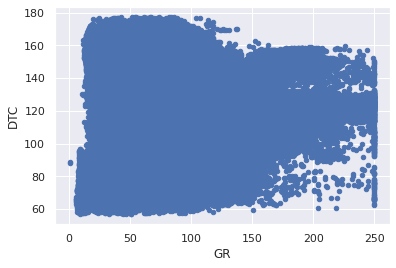

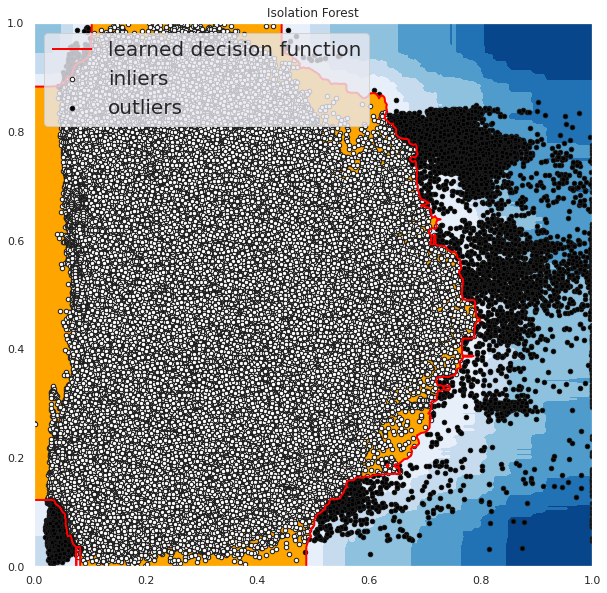

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.font_manager
import matplotlib.pyplot as plt

# Import models
from pyod.models.abod import ABOD
#from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.ocsvm import OCSVM
from pyod.models.sos import SOS
#from pyod.models.lscp import LSCP
from pyod.models.loda import LODA
from pyod.models.so_gaal import SO_GAAL
from scipy import stats

df1.plot.scatter('GR','DTC')

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0, 1))
df1[['GR','DTC']] = scaler.fit_transform(df1[['GR','DTC']])
df1[['GR','DTC']].head()

X1 = df1['GR'].values.reshape(-1,1)
X2 = df1['DTC'].values.reshape(-1,1)

X = np.concatenate((X1,X2),axis=1)
random_state = np.random.RandomState(42)
outliers_fraction = 0.02
# Define seven outlier detection tools to be compared
classifiers = {
        #'Cluster-based Local Outlier Factor (CBLOF)':CBLOF(contamination=outliers_fraction,check_estimator=False, random_state=random_state),
        'Isolation Forest': IForest(contamination=outliers_fraction,random_state=random_state),
        #'Angle-based Outlier Detector (ABOD)': ABOD(contamination=outliers_fraction),
        #'Single-Objective Generative Adversarial Active Learning (SO_GAAL)': SO_GAAL(contamination=outliers_fraction, epoch = 1),
        #'Average KNN': KNN(method='mean',contamination=outliers_fraction),
        #'K Nearest Neighbors (KNN)': KNN(contamination=outliers_fraction),
        #'Local Outlier Factor (LOF)': LOF(n_neighbors=35, contamination=outliers_fraction),
        #'LSCP: Locally Selective Combination of Parallel Outlier Ensembles': LSCP(contamination=outliers_fraction),
        #'Lightweight On-line Detector of Anomalies': LODA(contamination=outliers_fraction),
        #'Feature Bagging': FeatureBagging(LOF(n_neighbors=35),contamination=outliers_fraction,random_state=random_state),
        #'Histogram-base Outlier Detection (HBOS)': HBOS(contamination=outliers_fraction),
      
        #'One-class SVM (OCSVM)': OCSVM(contamination=outliers_fraction),
        #'Principal Component Analysis (PCA)': PCA(contamination=outliers_fraction, random_state=random_state)
        #'OCSVM': OCSVM(kernel='rbf', degree=3, gamma='auto', coef0=0.0, tol=0.001, nu=0.5, shrinking=True, cache_size=200, verbose=False, max_iter=- 1, contamination=0.1)
}

xx , yy = np.meshgrid(np.linspace(0,1 , 200), np.linspace(0, 1, 200))

for i, (clf_name, clf) in enumerate(classifiers.items()):
    clf.fit(X)
    # predict raw anomaly score
    scores_pred = clf.decision_function(X) * -1
        
    # prediction of a datapoint category outlier or inlier
    y_pred = clf.predict(X)
    n_inliers = len(y_pred) - np.count_nonzero(y_pred)
    n_outliers = np.count_nonzero(y_pred == 1)
    plt.figure(figsize=(10, 10))
    
    # copy of dataframe
    dfx = df1
    dfx['outlier'] = y_pred.tolist()
    
    # IX1 - inlier feature 1,  IX2 - inlier feature 2
    IX1 =  np.array(dfx['GR'][dfx['outlier'] == 0]).reshape(-1,1)
    IX2 =  np.array(dfx['DTC'][dfx['outlier'] == 0]).reshape(-1,1)
    
    # OX1 - outlier feature 1, OX2 - outlier feature 2
    OX1 =  dfx['GR'][dfx['outlier'] == 1].values.reshape(-1,1)
    OX2 =  dfx['DTC'][dfx['outlier'] == 1].values.reshape(-1,1)
         
    print('OUTLIERS : ',n_outliers,'INLIERS : ',n_inliers, clf_name)
        
    # threshold value to consider a datapoint inlier or outlier
    threshold = stats.scoreatpercentile(scores_pred,100 * outliers_fraction)
        
    # decision function calculates the raw anomaly score for every point
    Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
    Z = Z.reshape(xx.shape)
          
    # fill blue map colormap from minimum anomaly score to threshold value
    plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7),cmap=plt.cm.Blues_r)
        
    # draw red contour line where anomaly score is equal to thresold
    a = plt.contour(xx, yy, Z, levels=[threshold],linewidths=2, colors='red')
        
    # fill orange contour lines where range of anomaly score is from threshold to maximum anomaly score
    plt.contourf(xx, yy, Z, levels=[threshold, Z.max()],colors='orange')
        
    b = plt.scatter(IX1,IX2, c='white',s=20, edgecolor='k')
    
    c = plt.scatter(OX1,OX2, c='black',s=20, edgecolor='k')
       
    plt.axis('tight')  
    
    # loc=2 is used for the top left corner 
    plt.legend(
        [a.collections[0], b,c],
        ['learned decision function', 'inliers','outliers'],
        prop=matplotlib.font_manager.FontProperties(size=20),
        loc=2)
      
    plt.xlim((0, 1))
    plt.ylim((0, 1))
    plt.title(clf_name)
    plt.show()

In [ ]:
df1[['GR','DTC']] = scaler.inverse_transform(df1[['GR','DTC']])

In [ ]:
data = df1[df1.outlier == 0]

##**SP vs NPHI**

In [ ]:
df1 = data

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.font_manager
import matplotlib.pyplot as plt

# Import models
from pyod.models.abod import ABOD
#from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.ocsvm import OCSVM
from pyod.models.sos import SOS
#from pyod.models.lscp import LSCP
from pyod.models.loda import LODA
from pyod.models.so_gaal import SO_GAAL
from scipy import stats

df1.plot.scatter('SP','NPHI')

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0, 1))
df1[['SP','NPHI']] = scaler.fit_transform(df1[['SP','NPHI']])
df1[['SP','NPHI']].head()

X1 = df1['SP'].values.reshape(-1,1)
X2 = df1['NPHI'].values.reshape(-1,1)

X = np.concatenate((X1,X2),axis=1)
random_state = np.random.RandomState(42)
outliers_fraction = 0.005
# Define seven outlier detection tools to be compared
classifiers = {
        #'Cluster-based Local Outlier Factor (CBLOF)':CBLOF(contamination=outliers_fraction,check_estimator=False, random_state=random_state),
        'Isolation Forest': IForest(contamination=outliers_fraction,random_state=random_state),
        #'Angle-based Outlier Detector (ABOD)': ABOD(contamination=outliers_fraction),
        #'Single-Objective Generative Adversarial Active Learning (SO_GAAL)': SO_GAAL(contamination=outliers_fraction, epoch = 1),
        #'Average KNN': KNN(method='mean',contamination=outliers_fraction),
        #'K Nearest Neighbors (KNN)': KNN(contamination=outliers_fraction),
        #'Local Outlier Factor (LOF)': LOF(n_neighbors=35, contamination=outliers_fraction),
        #'LSCP: Locally Selective Combination of Parallel Outlier Ensembles': LSCP(contamination=outliers_fraction),
        #'Lightweight On-line Detector of Anomalies': LODA(contamination=outliers_fraction),
        #'Feature Bagging': FeatureBagging(LOF(n_neighbors=35),contamination=outliers_fraction,random_state=random_state),
        #'Histogram-base Outlier Detection (HBOS)': HBOS(contamination=outliers_fraction),
      
        #'One-class SVM (OCSVM)': OCSVM(contamination=outliers_fraction),
        #'Principal Component Analysis (PCA)': PCA(contamination=outliers_fraction, random_state=random_state)
        #'OCSVM': OCSVM(kernel='rbf', degree=3, gamma='auto', coef0=0.0, tol=0.001, nu=0.5, shrinking=True, cache_size=200, verbose=False, max_iter=- 1, contamination=0.1)
}

xx , yy = np.meshgrid(np.linspace(0,1 , 200), np.linspace(0, 1, 200))

for i, (clf_name, clf) in enumerate(classifiers.items()):
    clf.fit(X)
    # predict raw anomaly score
    scores_pred = clf.decision_function(X) * -1
        
    # prediction of a datapoint category outlier or inlier
    y_pred = clf.predict(X)
    n_inliers = len(y_pred) - np.count_nonzero(y_pred)
    n_outliers = np.count_nonzero(y_pred == 1)
    plt.figure(figsize=(10, 10))
    
    # copy of dataframe
    dfx = df1
    dfx['outlier'] = y_pred.tolist()
    
    # IX1 - inlier feature 1,  IX2 - inlier feature 2
    IX1 =  np.array(dfx['SP'][dfx['outlier'] == 0]).reshape(-1,1)
    IX2 =  np.array(dfx['NPHI'][dfx['outlier'] == 0]).reshape(-1,1)
    
    # OX1 - outlier feature 1, OX2 - outlier feature 2
    OX1 =  dfx['SP'][dfx['outlier'] == 1].values.reshape(-1,1)
    OX2 =  dfx['NPHI'][dfx['outlier'] == 1].values.reshape(-1,1)
         
    print('OUTLIERS : ',n_outliers,'INLIERS : ',n_inliers, clf_name)
        
    # threshold value to consider a datapoint inlier or outlier
    threshold = stats.scoreatpercentile(scores_pred,100 * outliers_fraction)
        
    # decision function calculates the raw anomaly score for every point
    Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
    Z = Z.reshape(xx.shape)
          
    # fill blue map colormap from minimum anomaly score to threshold value
    plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7),cmap=plt.cm.Blues_r)
        
    # draw red contour line where anomaly score is equal to thresold
    a = plt.contour(xx, yy, Z, levels=[threshold],linewidths=2, colors='red')
        
    # fill orange contour lines where range of anomaly score is from threshold to maximum anomaly score
    plt.contourf(xx, yy, Z, levels=[threshold, Z.max()],colors='orange')
        
    b = plt.scatter(IX1,IX2, c='white',s=20, edgecolor='k')
    
    c = plt.scatter(OX1,OX2, c='black',s=20, edgecolor='k')
       
    plt.axis('tight')  
    
    # loc=2 is used for the top left corner 
    plt.legend(
        [a.collections[0], b,c],
        ['learned decision function', 'inliers','outliers'],
        prop=matplotlib.font_manager.FontProperties(size=20),
        loc=2)
      
    plt.xlim((0, 1))
    plt.ylim((0, 1))
    plt.title(clf_name)
    plt.show()

In [ ]:
df1[['SP','NPHI']] = scaler.inverse_transform(df1[['SP','NPHI']])

In [ ]:
data = df1[df1.outlier == 0]

##**SP vs RDEP**

In [ ]:
df1 = data

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


OUTLIERS :  758 INLIERS :  587750 Average KNN


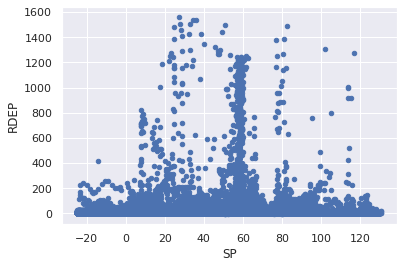

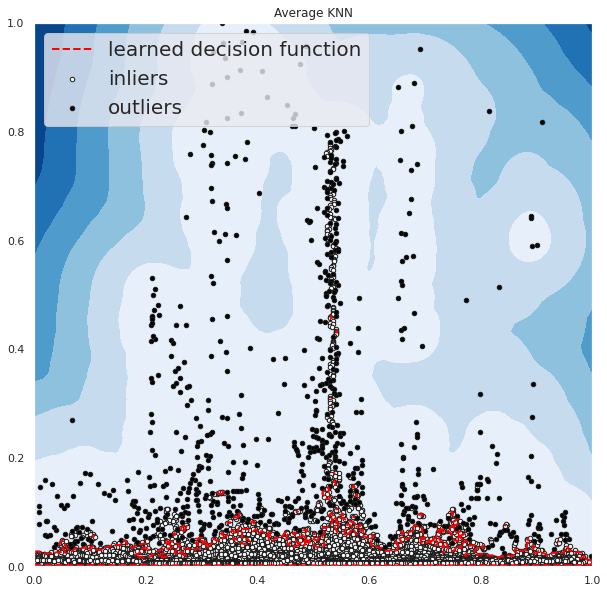

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.font_manager
import matplotlib.pyplot as plt

# Import models
from pyod.models.abod import ABOD
#from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.ocsvm import OCSVM
from pyod.models.sos import SOS
#from pyod.models.lscp import LSCP
from pyod.models.loda import LODA
from pyod.models.so_gaal import SO_GAAL
from scipy import stats

df1.plot.scatter('SP','RDEP')

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0, 1))
df1[['SP','RDEP']] = scaler.fit_transform(df1[['SP','RDEP']])
df1[['SP','RDEP']].head()

X1 = df1['SP'].values.reshape(-1,1)
X2 = df1['RDEP'].values.reshape(-1,1)

X = np.concatenate((X1,X2),axis=1)
random_state = np.random.RandomState(42)
outliers_fraction = 0.002
# Define seven outlier detection tools to be compared
classifiers = {
        #'Cluster-based Local Outlier Factor (CBLOF)':CBLOF(contamination=outliers_fraction,check_estimator=False, random_state=random_state),
        #'Isolation Forest': IForest(contamination=outliers_fraction,random_state=random_state),
        #'Angle-based Outlier Detector (ABOD)': ABOD(contamination=outliers_fraction),
        #'Single-Objective Generative Adversarial Active Learning (SO_GAAL)': SO_GAAL(contamination=outliers_fraction, epoch = 1),
        'Average KNN': KNN(method='mean',contamination=outliers_fraction),
        #'K Nearest Neighbors (KNN)': KNN(contamination=outliers_fraction),
        #'Local Outlier Factor (LOF)': LOF(n_neighbors=35, contamination=outliers_fraction),
        #'LSCP: Locally Selective Combination of Parallel Outlier Ensembles': LSCP(contamination=outliers_fraction),
        #'Lightweight On-line Detector of Anomalies': LODA(contamination=outliers_fraction),
        #'Feature Bagging': FeatureBagging(LOF(n_neighbors=35),contamination=outliers_fraction,random_state=random_state),
        #'Histogram-base Outlier Detection (HBOS)': HBOS(contamination=outliers_fraction),
      
        #'One-class SVM (OCSVM)': OCSVM(contamination=outliers_fraction),
        #'Principal Component Analysis (PCA)': PCA(contamination=outliers_fraction, random_state=random_state)
        #'OCSVM': OCSVM(kernel='rbf', degree=3, gamma='auto', coef0=0.0, tol=0.001, nu=0.5, shrinking=True, cache_size=200, verbose=False, max_iter=- 1, contamination=0.1)
}

xx , yy = np.meshgrid(np.linspace(0,1 , 200), np.linspace(0, 1, 200))

for i, (clf_name, clf) in enumerate(classifiers.items()):
    clf.fit(X)
    # predict raw anomaly score
    scores_pred = clf.decision_function(X) * -1
        
    # prediction of a datapoint category outlier or inlier
    y_pred = clf.predict(X)
    n_inliers = len(y_pred) - np.count_nonzero(y_pred)
    n_outliers = np.count_nonzero(y_pred == 1)
    plt.figure(figsize=(10, 10))
    
    # copy of dataframe
    dfx = df1
    dfx['outlier'] = y_pred.tolist()
    
    # IX1 - inlier feature 1,  IX2 - inlier feature 2
    IX1 =  np.array(dfx['SP'][dfx['outlier'] == 0]).reshape(-1,1)
    IX2 =  np.array(dfx['RDEP'][dfx['outlier'] == 0]).reshape(-1,1)
    
    # OX1 - outlier feature 1, OX2 - outlier feature 2
    OX1 =  dfx['SP'][dfx['outlier'] == 1].values.reshape(-1,1)
    OX2 =  dfx['RDEP'][dfx['outlier'] == 1].values.reshape(-1,1)
         
    print('OUTLIERS : ',n_outliers,'INLIERS : ',n_inliers, clf_name)
        
    # threshold value to consider a datapoint inlier or outlier
    threshold = stats.scoreatpercentile(scores_pred,100 * outliers_fraction)
        
    # decision function calculates the raw anomaly score for every point
    Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
    Z = Z.reshape(xx.shape)
          
    # fill blue map colormap from minimum anomaly score to threshold value
    plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7),cmap=plt.cm.Blues_r)
        
    # draw red contour line where anomaly score is equal to thresold
    a = plt.contour(xx, yy, Z, levels=[threshold],linewidths=2, colors='red')
        
    # fill orange contour lines where range of anomaly score is from threshold to maximum anomaly score
    plt.contourf(xx, yy, Z, levels=[threshold, Z.max()],colors='orange')
        
    b = plt.scatter(IX1,IX2, c='white',s=20, edgecolor='k')
    
    c = plt.scatter(OX1,OX2, c='black',s=20, edgecolor='k')
       
    plt.axis('tight')  
    
    # loc=2 is used for the top left corner 
    plt.legend(
        [a.collections[0], b,c],
        ['learned decision function', 'inliers','outliers'],
        prop=matplotlib.font_manager.FontProperties(size=20),
        loc=2)
      
    plt.xlim((0, 1))
    plt.ylim((0, 1))
    plt.title(clf_name)
    plt.show()

In [ ]:
df1[['SP','RDEP']] = scaler.inverse_transform(df1[['SP','RDEP']])

In [ ]:
data = df1[df1.outlier == 0]

##**RDEP vs RMED**

In [ ]:
df1 = data

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.font_manager
import matplotlib.pyplot as plt

# Import models
from pyod.models.abod import ABOD
#from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.ocsvm import OCSVM
from pyod.models.sos import SOS
#from pyod.models.lscp import LSCP
from pyod.models.loda import LODA
from pyod.models.so_gaal import SO_GAAL
from scipy import stats

df1.plot.scatter('RDEP','RMED')

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0, 1))
df1[['RDEP','RMED']] = scaler.fit_transform(df1[['RDEP','RMED']])
df1[['RDEP','RMED']].head()

X1 = df1['RDEP'].values.reshape(-1,1)
X2 = df1['RMED'].values.reshape(-1,1)

X = np.concatenate((X1,X2),axis=1)
random_state = np.random.RandomState(42)
outliers_fraction = 0.0001
# Define seven outlier detection tools to be compared
classifiers = {
        #'Cluster-based Local Outlier Factor (CBLOF)':CBLOF(contamination=outliers_fraction,check_estimator=False, random_state=random_state),
        #'Isolation Forest': IForest(contamination=outliers_fraction,random_state=random_state),
        #'Angle-based Outlier Detector (ABOD)': ABOD(contamination=outliers_fraction),
        #'Single-Objective Generative Adversarial Active Learning (SO_GAAL)': SO_GAAL(contamination=outliers_fraction, epoch = 1),
        'Average KNN': KNN(method='mean',contamination=outliers_fraction),
        #'K Nearest Neighbors (KNN)': KNN(contamination=outliers_fraction),
        #'Local Outlier Factor (LOF)': LOF(n_neighbors=35, contamination=outliers_fraction),
        #'LSCP: Locally Selective Combination of Parallel Outlier Ensembles': LSCP(contamination=outliers_fraction),
        #'Lightweight On-line Detector of Anomalies': LODA(contamination=outliers_fraction),
        #'Feature Bagging': FeatureBagging(LOF(n_neighbors=35),contamination=outliers_fraction,random_state=random_state),
        #'Histogram-base Outlier Detection (HBOS)': HBOS(contamination=outliers_fraction),
      
        #'One-class SVM (OCSVM)': OCSVM(contamination=outliers_fraction),
        #'Principal Component Analysis (PCA)': PCA(contamination=outliers_fraction, random_state=random_state)
        #'OCSVM': OCSVM(kernel='rbf', degree=3, gamma='auto', coef0=0.0, tol=0.001, nu=0.5, shrinking=True, cache_size=200, verbose=False, max_iter=- 1, contamination=0.1)
}

xx , yy = np.meshgrid(np.linspace(0,1 , 200), np.linspace(0, 1, 200))

for i, (clf_name, clf) in enumerate(classifiers.items()):
    clf.fit(X)
    # predict raw anomaly score
    scores_pred = clf.decision_function(X) * -1
        
    # prediction of a datapoint category outlier or inlier
    y_pred = clf.predict(X)
    n_inliers = len(y_pred) - np.count_nonzero(y_pred)
    n_outliers = np.count_nonzero(y_pred == 1)
    plt.figure(figsize=(10, 10))
    
    # copy of dataframe
    dfx = df1
    dfx['outlier'] = y_pred.tolist()
    
    # IX1 - inlier feature 1,  IX2 - inlier feature 2
    IX1 =  np.array(dfx['RDEP'][dfx['outlier'] == 0]).reshape(-1,1)
    IX2 =  np.array(dfx['RMED'][dfx['outlier'] == 0]).reshape(-1,1)
    
    # OX1 - outlier feature 1, OX2 - outlier feature 2
    OX1 =  dfx['RDEP'][dfx['outlier'] == 1].values.reshape(-1,1)
    OX2 =  dfx['RMED'][dfx['outlier'] == 1].values.reshape(-1,1)
         
    print('OUTLIERS : ',n_outliers,'INLIERS : ',n_inliers, clf_name)
        
    # threshold value to consider a datapoint inlier or outlier
    threshold = stats.scoreatpercentile(scores_pred,100 * outliers_fraction)
        
    # decision function calculates the raw anomaly score for every point
    Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
    Z = Z.reshape(xx.shape)
          
    # fill blue map colormap from minimum anomaly score to threshold value
    plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7),cmap=plt.cm.Blues_r)
        
    # draw red contour line where anomaly score is equal to thresold
    a = plt.contour(xx, yy, Z, levels=[threshold],linewidths=2, colors='red')
        
    # fill orange contour lines where range of anomaly score is from threshold to maximum anomaly score
    plt.contourf(xx, yy, Z, levels=[threshold, Z.max()],colors='orange')
        
    b = plt.scatter(IX1,IX2, c='white',s=20, edgecolor='k')
    
    c = plt.scatter(OX1,OX2, c='black',s=20, edgecolor='k')
       
    plt.axis('tight')  
    
    # loc=2 is used for the top left corner 
    plt.legend(
        [a.collections[0], b,c],
        ['learned decision function', 'inliers','outliers'],
        prop=matplotlib.font_manager.FontProperties(size=20),
        loc=2)
      
    plt.xlim((0, 1))
    plt.ylim((0, 1))
    plt.title(clf_name)
    plt.show()

In [ ]:
df1[['RDEP','RMED']] = scaler.inverse_transform(df1[['RDEP','RMED']])

In [ ]:
data = df1[df1.outlier == 0]

## **RMED vs PEF**

In [ ]:
df1 = data

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.font_manager
import matplotlib.pyplot as plt

# Import models
from pyod.models.abod import ABOD
#from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.ocsvm import OCSVM
from pyod.models.sos import SOS
#from pyod.models.lscp import LSCP
from pyod.models.loda import LODA
from pyod.models.so_gaal import SO_GAAL
from scipy import stats

df1.plot.scatter('RMED','PEF')

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0, 1))
df1[['RMED','PEF']] = scaler.fit_transform(df1[['RMED','PEF']])
df1[['RMED','PEF']].head()

X1 = df1['RMED'].values.reshape(-1,1)
X2 = df1['PEF'].values.reshape(-1,1)

X = np.concatenate((X1,X2),axis=1)
random_state = np.random.RandomState(42)
outliers_fraction = 0.003
# Define seven outlier detection tools to be compared
classifiers = {
        #'Cluster-based Local Outlier Factor (CBLOF)':CBLOF(contamination=outliers_fraction,check_estimator=False, random_state=random_state),
        #'Isolation Forest': IForest(contamination=outliers_fraction,random_state=random_state),
        #'Angle-based Outlier Detector (ABOD)': ABOD(contamination=outliers_fraction),
        #'Single-Objective Generative Adversarial Active Learning (SO_GAAL)': SO_GAAL(contamination=outliers_fraction, epoch = 1),
        'Average KNN': KNN(method='mean',contamination=outliers_fraction),
        #'K Nearest Neighbors (KNN)': KNN(contamination=outliers_fraction),
        #'Local Outlier Factor (LOF)': LOF(n_neighbors=35, contamination=outliers_fraction),
        #'LSCP: Locally Selective Combination of Parallel Outlier Ensembles': LSCP(contamination=outliers_fraction),
        #'Lightweight On-line Detector of Anomalies': LODA(contamination=outliers_fraction),
        #'Feature Bagging': FeatureBagging(LOF(n_neighbors=35),contamination=outliers_fraction,random_state=random_state),
        #'Histogram-base Outlier Detection (HBOS)': HBOS(contamination=outliers_fraction),
      
        #'One-class SVM (OCSVM)': OCSVM(contamination=outliers_fraction),
        #'Principal Component Analysis (PCA)': PCA(contamination=outliers_fraction, random_state=random_state)
        #'OCSVM': OCSVM(kernel='rbf', degree=3, gamma='auto', coef0=0.0, tol=0.001, nu=0.5, shrinking=True, cache_size=200, verbose=False, max_iter=- 1, contamination=0.1)
}

xx , yy = np.meshgrid(np.linspace(0,1 , 200), np.linspace(0, 1, 200))

for i, (clf_name, clf) in enumerate(classifiers.items()):
    clf.fit(X)
    # predict raw anomaly score
    scores_pred = clf.decision_function(X) * -1
        
    # prediction of a datapoint category outlier or inlier
    y_pred = clf.predict(X)
    n_inliers = len(y_pred) - np.count_nonzero(y_pred)
    n_outliers = np.count_nonzero(y_pred == 1)
    plt.figure(figsize=(10, 10))
    
    # copy of dataframe
    dfx = df1
    dfx['outlier'] = y_pred.tolist()
    
    # IX1 - inlier feature 1,  IX2 - inlier feature 2
    IX1 =  np.array(dfx['RMED'][dfx['outlier'] == 0]).reshape(-1,1)
    IX2 =  np.array(dfx['PEF'][dfx['outlier'] == 0]).reshape(-1,1)
    
    # OX1 - outlier feature 1, OX2 - outlier feature 2
    OX1 =  dfx['RMED'][dfx['outlier'] == 1].values.reshape(-1,1)
    OX2 =  dfx['PEF'][dfx['outlier'] == 1].values.reshape(-1,1)
         
    print('OUTLIERS : ',n_outliers,'INLIERS : ',n_inliers, clf_name)
        
    # threshold value to consider a datapoint inlier or outlier
    threshold = stats.scoreatpercentile(scores_pred,100 * outliers_fraction)
        
    # decision function calculates the raw anomaly score for every point
    Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
    Z = Z.reshape(xx.shape)
          
    # fill blue map colormap from minimum anomaly score to threshold value
    plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7),cmap=plt.cm.Blues_r)
        
    # draw red contour line where anomaly score is equal to thresold
    a = plt.contour(xx, yy, Z, levels=[threshold],linewidths=2, colors='red')
        
    # fill orange contour lines where range of anomaly score is from threshold to maximum anomaly score
    plt.contourf(xx, yy, Z, levels=[threshold, Z.max()],colors='orange')
        
    b = plt.scatter(IX1,IX2, c='white',s=20, edgecolor='k')
    
    c = plt.scatter(OX1,OX2, c='black',s=20, edgecolor='k')
       
    plt.axis('tight')  
    
    # loc=2 is used for the top left corner 
    plt.legend(
        [a.collections[0], b,c],
        ['learned decision function', 'inliers','outliers'],
        prop=matplotlib.font_manager.FontProperties(size=20),
        loc=2)
      
    plt.xlim((0, 1))
    plt.ylim((0, 1))
    plt.title(clf_name)
    plt.show()

In [ ]:
df1[['RMED','PEF']] = scaler.inverse_transform(df1[['RMED','PEF']])

In [ ]:
data = df1[df1.outlier == 0]

## **RDEP vs GR**

In [ ]:
df1 = data

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.font_manager
import matplotlib.pyplot as plt

# Import models
from pyod.models.abod import ABOD
#from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.ocsvm import OCSVM
from pyod.models.sos import SOS
#from pyod.models.lscp import LSCP
from pyod.models.loda import LODA
from pyod.models.so_gaal import SO_GAAL
from scipy import stats

df1.plot.scatter('RDEP','GR')

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0, 1))
df1[['RDEP','GR']] = scaler.fit_transform(df1[['RDEP','GR']])
df1[['RDEP','GR']].head()

X1 = df1['RDEP'].values.reshape(-1,1)
X2 = df1['GR'].values.reshape(-1,1)

X = np.concatenate((X1,X2),axis=1)
random_state = np.random.RandomState(42)
outliers_fraction = 0.002
# Define seven outlier detection tools to be compared
classifiers = {
        #'Cluster-based Local Outlier Factor (CBLOF)':CBLOF(contamination=outliers_fraction,check_estimator=False, random_state=random_state),
        #'Isolation Forest': IForest(contamination=outliers_fraction,random_state=random_state),
        #'Angle-based Outlier Detector (ABOD)': ABOD(contamination=outliers_fraction),
        #'Single-Objective Generative Adversarial Active Learning (SO_GAAL)': SO_GAAL(contamination=outliers_fraction, epoch = 1),
        'Average KNN': KNN(method='mean',contamination=outliers_fraction),
        #'K Nearest Neighbors (KNN)': KNN(contamination=outliers_fraction),
        #'Local Outlier Factor (LOF)': LOF(n_neighbors=35, contamination=outliers_fraction),
        #'LSCP: Locally Selective Combination of Parallel Outlier Ensembles': LSCP(contamination=outliers_fraction),
        #'Lightweight On-line Detector of Anomalies': LODA(contamination=outliers_fraction),
        #'Feature Bagging': FeatureBagging(LOF(n_neighbors=35),contamination=outliers_fraction,random_state=random_state),
        #'Histogram-base Outlier Detection (HBOS)': HBOS(contamination=outliers_fraction),
      
        #'One-class SVM (OCSVM)': OCSVM(contamination=outliers_fraction),
        #'Principal Component Analysis (PCA)': PCA(contamination=outliers_fraction, random_state=random_state)
        #'OCSVM': OCSVM(kernel='rbf', degree=3, gamma='auto', coef0=0.0, tol=0.001, nu=0.5, shrinking=True, cache_size=200, verbose=False, max_iter=- 1, contamination=0.1)
}

xx , yy = np.meshgrid(np.linspace(0,1 , 200), np.linspace(0, 1, 200))

for i, (clf_name, clf) in enumerate(classifiers.items()):
    clf.fit(X)
    # predict raw anomaly score
    scores_pred = clf.decision_function(X) * -1
        
    # prediction of a datapoint category outlier or inlier
    y_pred = clf.predict(X)
    n_inliers = len(y_pred) - np.count_nonzero(y_pred)
    n_outliers = np.count_nonzero(y_pred == 1)
    plt.figure(figsize=(10, 10))
    
    # copy of dataframe
    dfx = df1
    dfx['outlier'] = y_pred.tolist()
    
    # IX1 - inlier feature 1,  IX2 - inlier feature 2
    IX1 =  np.array(dfx['RDEP'][dfx['outlier'] == 0]).reshape(-1,1)
    IX2 =  np.array(dfx['GR'][dfx['outlier'] == 0]).reshape(-1,1)
    
    # OX1 - outlier feature 1, OX2 - outlier feature 2
    OX1 =  dfx['RDEP'][dfx['outlier'] == 1].values.reshape(-1,1)
    OX2 =  dfx['GR'][dfx['outlier'] == 1].values.reshape(-1,1)
         
    print('OUTLIERS : ',n_outliers,'INLIERS : ',n_inliers, clf_name)
        
    # threshold value to consider a datapoint inlier or outlier
    threshold = stats.scoreatpercentile(scores_pred,100 * outliers_fraction)
        
    # decision function calculates the raw anomaly score for every point
    Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
    Z = Z.reshape(xx.shape)
          
    # fill blue map colormap from minimum anomaly score to threshold value
    plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7),cmap=plt.cm.Blues_r)
        
    # draw red contour line where anomaly score is equal to thresold
    a = plt.contour(xx, yy, Z, levels=[threshold],linewidths=2, colors='red')
        
    # fill orange contour lines where range of anomaly score is from threshold to maximum anomaly score
    plt.contourf(xx, yy, Z, levels=[threshold, Z.max()],colors='orange')
        
    b = plt.scatter(IX1,IX2, c='white',s=20, edgecolor='k')
    
    c = plt.scatter(OX1,OX2, c='black',s=20, edgecolor='k')
       
    plt.axis('tight')  
    
    # loc=2 is used for the top left corner 
    plt.legend(
        [a.collections[0], b,c],
        ['learned decision function', 'inliers','outliers'],
        prop=matplotlib.font_manager.FontProperties(size=20),
        loc=2)
      
    plt.xlim((0, 1))
    plt.ylim((0, 1))
    plt.title(clf_name)
    plt.show()

In [ ]:
df1[['RDEP','GR']] = scaler.inverse_transform(df1[['RDEP','GR']])

In [ ]:
data = df1[df1.outlier == 0]

In [ ]:
data.to_csv('/content/drive/My Drive/Colab Notebooks/outlier_removed_dataset')

## **DRHO vs ROP**

In [ ]:
df1 = data

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


OUTLIERS :  7789 INLIERS :  578105 Average KNN


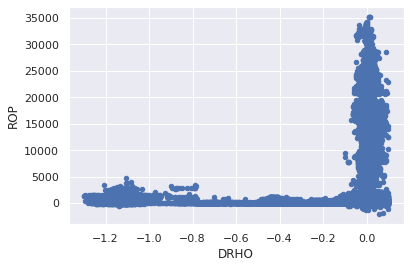

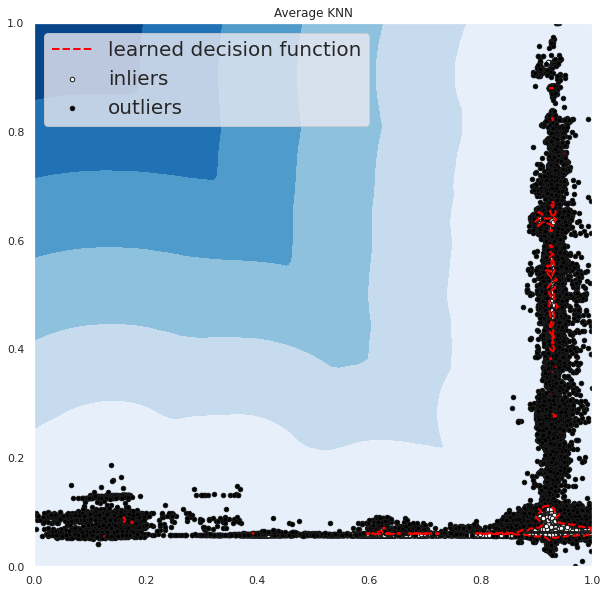

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.font_manager
import matplotlib.pyplot as plt

# Import models
from pyod.models.abod import ABOD
#from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.ocsvm import OCSVM
from pyod.models.sos import SOS
#from pyod.models.lscp import LSCP
from pyod.models.loda import LODA
from pyod.models.so_gaal import SO_GAAL
from scipy import stats

df1.plot.scatter('DRHO','ROP')

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0, 1))
df1[['DRHO','ROP']] = scaler.fit_transform(df1[['DRHO','ROP']])
df1[['DRHO','ROP']].head()

X1 = df1['DRHO'].values.reshape(-1,1)
X2 = df1['ROP'].values.reshape(-1,1)

X = np.concatenate((X1,X2),axis=1)
random_state = np.random.RandomState(42)
outliers_fraction = 0.02
# Define seven outlier detection tools to be compared
classifiers = {
        #'Cluster-based Local Outlier Factor (CBLOF)':CBLOF(contamination=outliers_fraction,check_estimator=False, random_state=random_state),
        #'Isolation Forest': IForest(contamination=outliers_fraction,random_state=random_state),
        #'Angle-based Outlier Detector (ABOD)': ABOD(contamination=outliers_fraction),
        #'Single-Objective Generative Adversarial Active Learning (SO_GAAL)': SO_GAAL(contamination=outliers_fraction, epoch = 1),
        'Average KNN': KNN(method='mean',contamination=outliers_fraction),
        #'K Nearest Neighbors (KNN)': KNN(contamination=outliers_fraction),
        #'Local Outlier Factor (LOF)': LOF(n_neighbors=35, contamination=outliers_fraction),
        #'LSCP: Locally Selective Combination of Parallel Outlier Ensembles': LSCP(contamination=outliers_fraction),
        #'Lightweight On-line Detector of Anomalies': LODA(contamination=outliers_fraction),
        #'Feature Bagging': FeatureBagging(LOF(n_neighbors=35),contamination=outliers_fraction,random_state=random_state),
        #'Histogram-base Outlier Detection (HBOS)': HBOS(contamination=outliers_fraction),
      
        #'One-class SVM (OCSVM)': OCSVM(contamination=outliers_fraction),
        #'Principal Component Analysis (PCA)': PCA(contamination=outliers_fraction, random_state=random_state)
        #'OCSVM': OCSVM(kernel='rbf', degree=3, gamma='auto', coef0=0.0, tol=0.001, nu=0.5, shrinking=True, cache_size=200, verbose=False, max_iter=- 1, contamination=0.1)
}

xx , yy = np.meshgrid(np.linspace(0,1 , 200), np.linspace(0, 1, 200))

for i, (clf_name, clf) in enumerate(classifiers.items()):
    clf.fit(X)
    # predict raw anomaly score
    scores_pred = clf.decision_function(X) * -1
        
    # prediction of a datapoint category outlier or inlier
    y_pred = clf.predict(X)
    n_inliers = len(y_pred) - np.count_nonzero(y_pred)
    n_outliers = np.count_nonzero(y_pred == 1)
    plt.figure(figsize=(10, 10))
    
    # copy of dataframe
    dfx = df1
    dfx['outlier'] = y_pred.tolist()
    
    # IX1 - inlier feature 1,  IX2 - inlier feature 2
    IX1 =  np.array(dfx['DRHO'][dfx['outlier'] == 0]).reshape(-1,1)
    IX2 =  np.array(dfx['ROP'][dfx['outlier'] == 0]).reshape(-1,1)
    
    # OX1 - outlier feature 1, OX2 - outlier feature 2
    OX1 =  dfx['DRHO'][dfx['outlier'] == 1].values.reshape(-1,1)
    OX2 =  dfx['ROP'][dfx['outlier'] == 1].values.reshape(-1,1)
         
    print('OUTLIERS : ',n_outliers,'INLIERS : ',n_inliers, clf_name)
        
    # threshold value to consider a datapoint inlier or outlier
    threshold = stats.scoreatpercentile(scores_pred,100 * outliers_fraction)
        
    # decision function calculates the raw anomaly score for every point
    Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
    Z = Z.reshape(xx.shape)
          
    # fill blue map colormap from minimum anomaly score to threshold value
    plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7),cmap=plt.cm.Blues_r)
        
    # draw red contour line where anomaly score is equal to thresold
    a = plt.contour(xx, yy, Z, levels=[threshold],linewidths=2, colors='red')
        
    # fill orange contour lines where range of anomaly score is from threshold to maximum anomaly score
    plt.contourf(xx, yy, Z, levels=[threshold, Z.max()],colors='orange')
        
    b = plt.scatter(IX1,IX2, c='white',s=20, edgecolor='k')
    
    c = plt.scatter(OX1,OX2, c='black',s=20, edgecolor='k')
       
    plt.axis('tight')  
    
    # loc=2 is used for the top left corner 
    plt.legend(
        [a.collections[0], b,c],
        ['learned decision function', 'inliers','outliers'],
        prop=matplotlib.font_manager.FontProperties(size=20),
        loc=2)
      
    plt.xlim((0, 1))
    plt.ylim((0, 1))
    plt.title(clf_name)
    plt.show()

In [ ]:
df1[['DRHO','ROP']] = scaler.inverse_transform(df1[['DRHO','ROP']])

In [ ]:
data = df1[df1.outlier == 0]

## **RMIC vs MUDWEIGHT**

In [ ]:
df1 = data

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


OUTLIERS :  8105 INLIERS :  570000 Average KNN


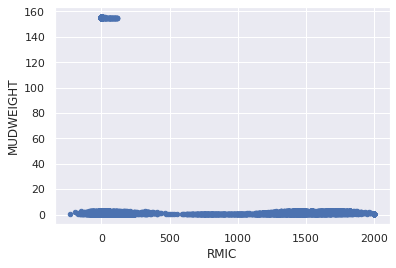

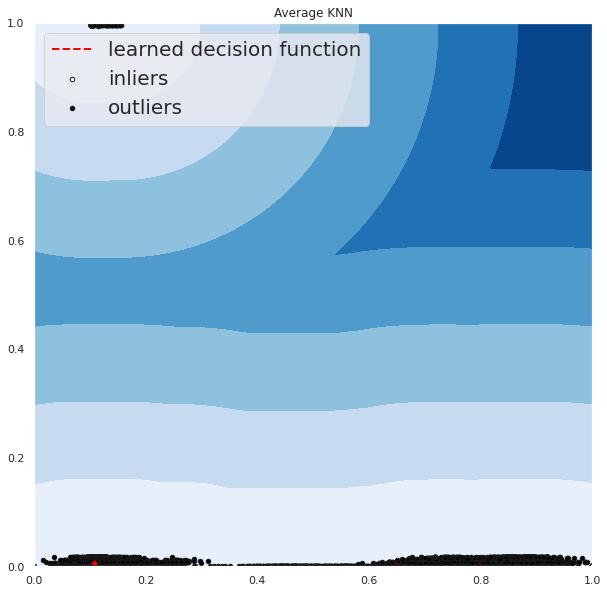

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.font_manager
import matplotlib.pyplot as plt

# Import models
from pyod.models.abod import ABOD
#from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.ocsvm import OCSVM
from pyod.models.sos import SOS
#from pyod.models.lscp import LSCP
from pyod.models.loda import LODA
from pyod.models.so_gaal import SO_GAAL
from scipy import stats

df1.plot.scatter('RMIC','MUDWEIGHT')

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0, 1))
df1[['RMIC','MUDWEIGHT']] = scaler.fit_transform(df1[['RMIC','MUDWEIGHT']])
df1[['RMIC','MUDWEIGHT']].head()

X1 = df1['RMIC'].values.reshape(-1,1)
X2 = df1['MUDWEIGHT'].values.reshape(-1,1)

X = np.concatenate((X1,X2),axis=1)
random_state = np.random.RandomState(42)
outliers_fraction = 0.02
# Define seven outlier detection tools to be compared
classifiers = {
        #'Cluster-based Local Outlier Factor (CBLOF)':CBLOF(contamination=outliers_fraction,check_estimator=False, random_state=random_state),
        #'Isolation Forest': IForest(contamination=outliers_fraction,random_state=random_state),
        #'Angle-based Outlier Detector (ABOD)': ABOD(contamination=outliers_fraction),
        #'Single-Objective Generative Adversarial Active Learning (SO_GAAL)': SO_GAAL(contamination=outliers_fraction, epoch = 1),
        'Average KNN': KNN(method='mean',contamination=outliers_fraction),
        #'K Nearest Neighbors (KNN)': KNN(contamination=outliers_fraction),
        #'Local Outlier Factor (LOF)': LOF(n_neighbors=35, contamination=outliers_fraction),
        #'LSCP: Locally Selective Combination of Parallel Outlier Ensembles': LSCP(contamination=outliers_fraction),
        #'Lightweight On-line Detector of Anomalies': LODA(contamination=outliers_fraction),
        #'Feature Bagging': FeatureBagging(LOF(n_neighbors=35),contamination=outliers_fraction,random_state=random_state),
        #'Histogram-base Outlier Detection (HBOS)': HBOS(contamination=outliers_fraction),
      
        #'One-class SVM (OCSVM)': OCSVM(contamination=outliers_fraction),
        #'Principal Component Analysis (PCA)': PCA(contamination=outliers_fraction, random_state=random_state)
        #'OCSVM': OCSVM(kernel='rbf', degree=3, gamma='auto', coef0=0.0, tol=0.001, nu=0.5, shrinking=True, cache_size=200, verbose=False, max_iter=- 1, contamination=0.1)
}

xx , yy = np.meshgrid(np.linspace(0,1 , 200), np.linspace(0, 1, 200))

for i, (clf_name, clf) in enumerate(classifiers.items()):
    clf.fit(X)
    # predict raw anomaly score
    scores_pred = clf.decision_function(X) * -1
        
    # prediction of a datapoint category outlier or inlier
    y_pred = clf.predict(X)
    n_inliers = len(y_pred) - np.count_nonzero(y_pred)
    n_outliers = np.count_nonzero(y_pred == 1)
    plt.figure(figsize=(10, 10))
    
    # copy of dataframe
    dfx = df1
    dfx['outlier'] = y_pred.tolist()
    
    # IX1 - inlier feature 1,  IX2 - inlier feature 2
    IX1 =  np.array(dfx['RMIC'][dfx['outlier'] == 0]).reshape(-1,1)
    IX2 =  np.array(dfx['MUDWEIGHT'][dfx['outlier'] == 0]).reshape(-1,1)
    
    # OX1 - outlier feature 1, OX2 - outlier feature 2
    OX1 =  dfx['RMIC'][dfx['outlier'] == 1].values.reshape(-1,1)
    OX2 =  dfx['MUDWEIGHT'][dfx['outlier'] == 1].values.reshape(-1,1)
         
    print('OUTLIERS : ',n_outliers,'INLIERS : ',n_inliers, clf_name)
        
    # threshold value to consider a datapoint inlier or outlier
    threshold = stats.scoreatpercentile(scores_pred,100 * outliers_fraction)
        
    # decision function calculates the raw anomaly score for every point
    Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
    Z = Z.reshape(xx.shape)
          
    # fill blue map colormap from minimum anomaly score to threshold value
    plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7),cmap=plt.cm.Blues_r)
        
    # draw red contour line where anomaly score is equal to thresold
    a = plt.contour(xx, yy, Z, levels=[threshold],linewidths=2, colors='red')
        
    # fill orange contour lines where range of anomaly score is from threshold to maximum anomaly score
    plt.contourf(xx, yy, Z, levels=[threshold, Z.max()],colors='orange')
        
    b = plt.scatter(IX1,IX2, c='white',s=20, edgecolor='k')
    
    c = plt.scatter(OX1,OX2, c='black',s=20, edgecolor='k')
       
    plt.axis('tight')  
    
    # loc=2 is used for the top left corner 
    plt.legend(
        [a.collections[0], b,c],
        ['learned decision function', 'inliers','outliers'],
        prop=matplotlib.font_manager.FontProperties(size=20),
        loc=2)
      
    plt.xlim((0, 1))
    plt.ylim((0, 1))
    plt.title(clf_name)
    plt.show()

In [ ]:
df1[['RMIC','MUDWEIGHT']] = scaler.inverse_transform(df1[['RMIC','MUDWEIGHT']])

In [ ]:
data = df1[df1.outlier == 0]

In [ ]:
#data.to_csv('/content/drive/My Drive/Colab Notebooks/outlier_removed_dataset')

##**After OD**

In [ ]:
data = pd.read_csv('/content/drive/My Drive/Colab Notebooks/outlier_removed_dataset')

CPU times: user 2min 22s, sys: 2.65 s, total: 2min 24s
Wall time: 2min 24s


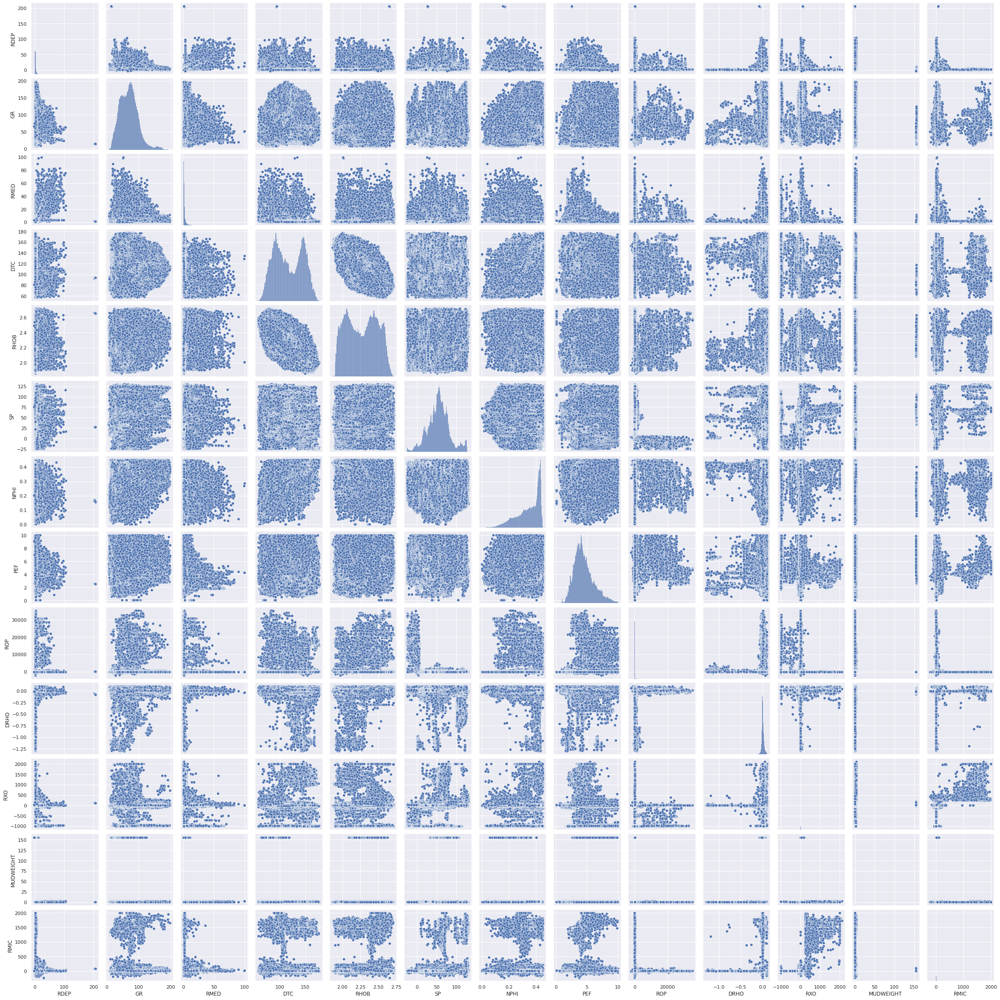

In [ ]:
%%time
import seaborn as sns
sns.set()
sns.pairplot(data[['RDEP','GR','RMED','DTC','RHOB','SP','NPHI','PEF','ROP','DRHO','RXO','MUDWEIGHT','RMIC']], palette='husl')

# **Feature Engineering**

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/Colab Notebooks/outlier_removed_dataset')

In [ ]:
data1 = data1.drop(columns = ['SGR','ROPA','DTS','RSHA'])

## **Features for addressing Interpolation**


This features will be added to the dataset and will be engineered accordingly with other features to address any resampling

In [ ]:
df1  = data1[['RDEP','GR','RMED','DTC','RHOB','SP','NPHI','PEF','ROP','DRHO','RXO','MUDWEIGHT','RMIC']]

In [ ]:
# Calculate the gradients of input logs
# Interpolated well logs should have similar gradients
for i in df1.keys():
    df1[i+'grad']=np.gradient(df1[i].values)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df1

,RDEP,GR,RMED,DTC,RHOB,SP,NPHI,PEF,ROP,DRHO,RXO,MUDWEIGHT,RMIC,RDEPgrad,GRgrad,RMEDgrad,DTCgrad,RHOBgrad,SPgrad,NPHIgrad,PEFgrad,ROPgrad,DRHOgrad,RXOgrad,MUDWEIGHTgrad,RMICgrad
0,1.828166,66.860718,1.537338,159.920029,2.113136,25.633387,0.4101,9.699265,28.368063,-0.594198,-3.2462,1.0639,2.9378,0.001388,2.719978,-0.021492,0.078552,-0.118282,-0.714262,0.01050,-4.915124,-0.200636,0.163350,3.74850,-0.77990,-0.13170
1,1.829554,69.580696,1.515846,159.998581,1.994854,24.919125,0.4206,4.784140,28.167427,-0.430848,0.5023,0.2840,2.8061,0.002662,2.540947,-0.021494,-0.061119,-0.037318,-0.527634,0.00475,-2.931059,-0.200649,0.186711,1.72455,-0.38355,0.58920
2,1.833491,71.942612,1.494350,159.797791,2.038500,24.578119,0.4196,3.837146,27.966764,-0.220775,0.2029,0.2968,4.1162,0.003077,1.881897,-0.021470,-0.222984,0.017023,-0.181562,-0.00090,-0.605664,-0.202683,0.167506,-0.16110,0.01010,0.47820
3,1.835708,73.344490,1.472905,159.552612,2.028900,24.556000,0.4188,3.572812,27.762060,-0.095836,0.1801,0.3042,3.7625,-0.012463,-0.012959,-0.024041,-0.160980,-0.011150,-0.117759,0.00000,-0.121726,-0.196216,0.096921,0.07740,0.00240,1.42625
4,1.808564,71.916695,1.446267,159.475830,2.016200,24.342602,0.4196,3.593694,27.574333,-0.026934,0.3577,0.3016,6.9687,-0.059516,-1.227165,-0.038816,-0.031113,-0.008100,-0.045904,0.00100,-0.230509,-0.165030,0.043072,0.08880,-0.01215,0.34815
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
585889,1.864500,36.017857,2.901400,76.128300,2.398901,91.629300,0.1458,5.362520,27.373590,0.048230,169.4907,0.1590,154.0678,2.110942,0.267258,1.076703,-7.102750,0.027141,0.321500,-0.00665,-0.540827,-0.443532,-0.000547,-58.90495,-0.00505,-48.16695
585890,5.103300,40.103462,2.945100,81.837500,2.434939,86.960400,0.1608,4.536005,27.219160,0.031453,74.9046,0.1654,41.6558,-0.933400,13.274668,0.081550,4.792800,0.039501,-5.947850,0.02605,-0.733397,0.006635,-0.023793,-11.00985,77.49630,-29.58975
585891,-0.002300,62.567192,3.064500,85.713900,2.477902,79.733600,0.1979,3.895726,27.386860,0.000644,147.4710,155.1516,94.8883,-3.706050,17.630238,0.068800,0.112800,0.051337,-3.486450,0.02420,1.241926,0.402589,-0.019527,-20.65790,77.48340,-16.38250
585892,-2.308800,75.363937,3.082700,82.063100,2.537613,79.987500,0.2092,7.019858,28.024338,-0.007600,33.5888,155.1322,8.8908,-1.642050,1.942825,-0.007300,-2.220700,0.006979,-1.843100,0.00125,2.577028,0.352211,-0.009470,-56.86345,-0.01235,-42.55305


In [ ]:
data = pd.concat((data1,df1.iloc[:,13:]),axis =1)

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning:

invalid value encountered in log

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning:

divide by zero encountered in log



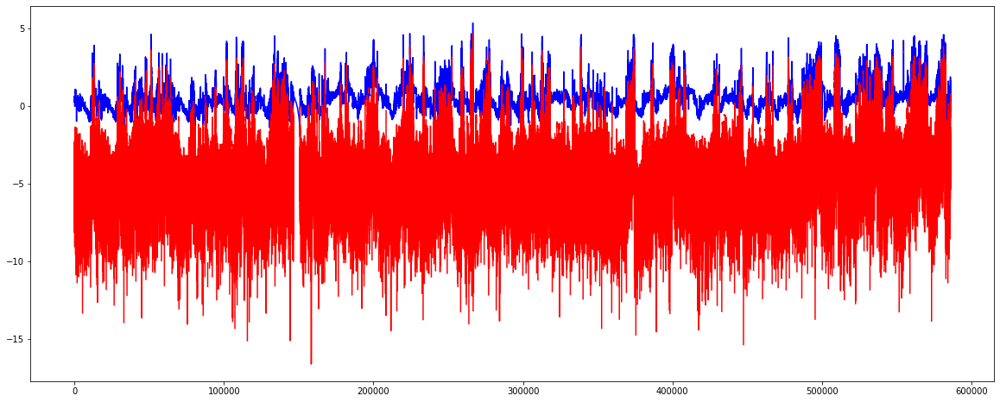

In [ ]:
%matplotlib inline

import matplotlib.pyplot as plt
# plt.xkcd()
# plt.style.use('ggplot')
%matplotlib inline

import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (20, 8)

plt.plot(np.log(df1.RDEP), 'b')
plt.plot(np.log(df1.RDEPgrad),'r')

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning:

divide by zero encountered in log

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning:

invalid value encountered in log



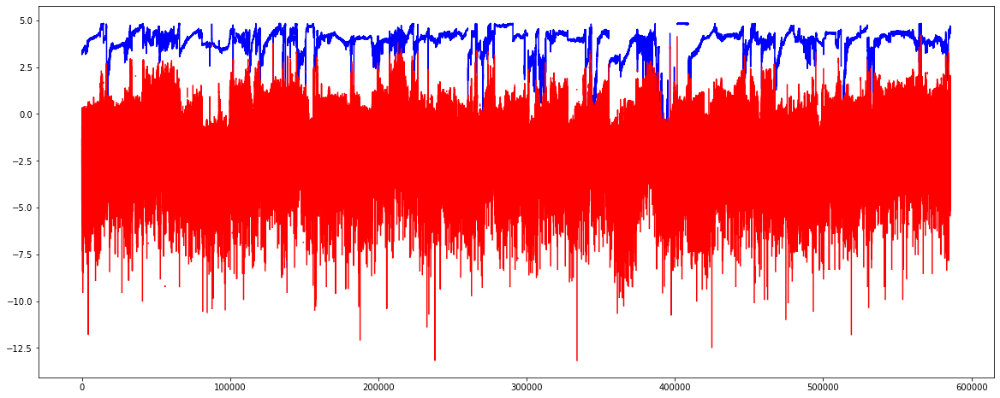

In [ ]:
plt.plot(np.log(df1.SP), 'b')
plt.plot(np.log(df1.SPgrad),'r')

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning:

divide by zero encountered in log

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning:

invalid value encountered in log



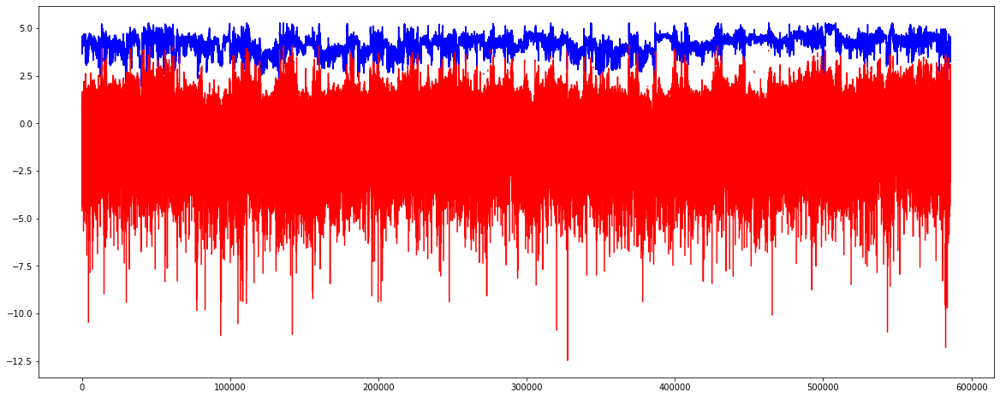

In [ ]:
plt.plot(np.log(df1.GR), 'b')
plt.plot(np.log(df1.GRgrad),'r')

CPU times: user 2min 20s, sys: 2.99 s, total: 2min 23s
Wall time: 2min 23s


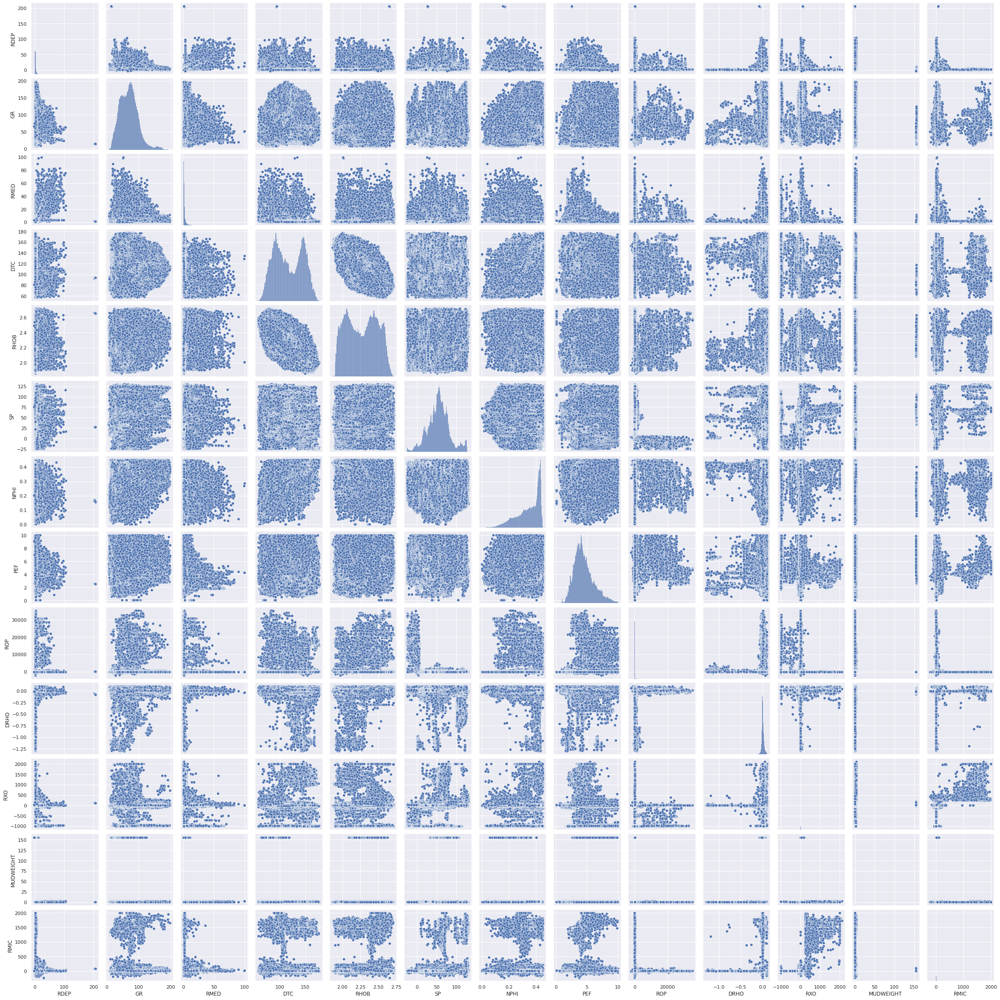

In [ ]:
%%time
import seaborn as sns
sns.set()
sns.pairplot(df1[['RDEP','GR','RMED','DTC','RHOB','SP','NPHI','PEF','ROP','DRHO','RXO','MUDWEIGHT','RMIC']], palette='husl')

In [ ]:
data.to_csv('/content/drive/My Drive/Colab Notebooks/Interpolated_dataset')

## **Logarithmic Transformation**

In [ ]:
data = pd.read_csv('/content/drive/My Drive/Colab Notebooks/Interpolated_dataset')

In [ ]:
#Perform logrithmic transformation to resistivity logs to avoid large weight on resisitivity logs
data['RMED_log']=np.log(data.RMED.values)
data['RDEP_log']=np.log(data.RDEP.values)
data = data.dropna(subset = ['RMED_log','RDEP_log'])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: RuntimeWarning:

invalid value encountered in log



In [ ]:
data = data.iloc[:,4:]
data

,WELL,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,GROUP,FORMATION,CALI,RMED,RDEP,RHOB,GR,NPHI,PEF,DTC,SP,BS,ROP,DCAL,DRHO,MUDWEIGHT,RMIC,RXO,FORCE_2020_LITHOFACIES_LITHOLOGY,FORCE_2020_LITHOFACIES_CONFIDENCE,LITHOLOGY,LITH_LABEL,LITH_LABEL1,plot_size,cluster1_prob,cluster2_prob,cluster3_prob,outlier,RDEPgrad,GRgrad,RMEDgrad,DTCgrad,RHOBgrad,SPgrad,NPHIgrad,PEFgrad,ROPgrad,DRHOgrad,RXOgrad,MUDWEIGHTgrad,RMICgrad,RMED_log,RDEP_log
0,15/9-13,501.3680,437642.000,6470972.5,-476.341675,NORDLAND GP.,ZECHSTEIN GP,19.421772,1.537338,1.828166,2.113136,66.860718,0.4101,9.699265,159.920029,25.633387,NaN,28.368063,NaN,-0.594198,1.0639,2.9378,-3.2462,65000,high,Shale,2,2,75.0,0.0,1.0,0.0,0,0.001388,2.719978,-0.021492,0.078552,-0.118282,-0.714262,0.01050,-4.915124,-0.200636,0.163350,3.74850,-0.77990,-0.13170,0.430052,0.603313
1,15/9-13,501.5200,437642.000,6470972.5,-476.493652,NORDLAND GP.,ZECHSTEIN GP,19.545425,1.515846,1.829554,1.994854,69.580696,0.4206,4.784140,159.998581,24.919125,NaN,28.167427,NaN,-0.430848,0.2840,2.8061,0.5023,65000,high,Shale,2,2,75.0,0.0,1.0,0.0,0,0.002662,2.540947,-0.021494,-0.061119,-0.037318,-0.527634,0.00475,-2.931059,-0.200649,0.186711,1.72455,-0.38355,0.58920,0.415973,0.604072
2,15/9-13,501.6720,437642.000,6470972.5,-476.645660,NORDLAND GP.,ZECHSTEIN GP,19.702278,1.494350,1.833491,2.038500,71.942612,0.4196,3.837146,159.797791,24.578119,NaN,27.966764,NaN,-0.220775,0.2968,4.1162,0.2029,65000,high,Shale,2,2,75.0,0.0,1.0,0.0,0,0.003077,1.881897,-0.021470,-0.222984,0.017023,-0.181562,-0.00090,-0.605664,-0.202683,0.167506,-0.16110,0.01010,0.47820,0.401691,0.606222
3,15/9-13,501.8240,437642.000,6470972.5,-476.797668,NORDLAND GP.,ZECHSTEIN GP,20.016970,1.472905,1.835708,2.028900,73.344490,0.4188,3.572812,159.552612,24.556000,NaN,27.762060,NaN,-0.095836,0.3042,3.7625,0.1801,65000,high,Shale,2,2,75.0,0.0,1.0,0.0,0,-0.012463,-0.012959,-0.024041,-0.160980,-0.011150,-0.117759,0.00000,-0.121726,-0.196216,0.096921,0.07740,0.00240,1.42625,0.387236,0.607431
4,15/9-13,501.9760,437642.000,6470972.5,-476.949676,NORDLAND GP.,ZECHSTEIN GP,21.002375,1.446267,1.808564,2.016200,71.916695,0.4196,3.593694,159.475830,24.342602,NaN,27.574333,NaN,-0.026934,0.3016,6.9687,0.3577,65000,high,Shale,2,2,75.0,0.0,1.0,0.0,0,-0.059516,-1.227165,-0.038816,-0.031113,-0.008100,-0.045904,0.00100,-0.230509,-0.165030,0.043072,0.08880,-0.01215,0.34815,0.368986,0.592533
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
585886,7/1-2 S,3168.4004,444920.375,6421578.5,-3107.540771,VESTLAND GP.,BRYNE FM,8.391429,0.834281,0.897263,2.397462,63.249226,0.2300,6.232712,91.765800,87.408800,8.5,29.017000,NaN,-0.007074,0.1854,46.6135,81.5198,65030,medium,Sandstone/Shale,1,1,75.0,0.0,1.0,0.0,0,-0.054801,-6.859999,-0.112253,3.875600,-0.012307,-0.583950,-0.00080,-0.385886,-0.165834,0.013762,55.57755,-0.01050,48.73140,-0.181185,-0.108406
585887,7/1-2 S,3168.5524,444920.375,6421578.5,-3107.692871,VESTLAND GP.,BRYNE FM,8.395998,0.835755,0.875619,2.383679,49.717674,0.2002,5.864515,95.803900,89.168100,8.5,28.653328,NaN,0.007387,0.1669,138.9196,192.2349,65030,medium,Sandstone/Shale,1,1,75.0,0.0,1.0,0.0,0,-0.007923,-11.840139,-0.021294,2.138600,-0.008403,-0.545700,-0.02795,-0.307526,-0.455388,0.019811,55.59735,-0.00495,45.68810,-0.179420,-0.132824
585888,7/1-2 S,3168.7044,444920.375,6421578.0,-3107.844727,VESTLAND GP.,BRYNE FM,8.388196,0.791694,0.881417,2.380656,39.568947,0.1741,5.617660,96.043000,86.317400,8.5,28.106224,NaN,0.032547,0.1755,137.9897,192.7145,30000,medium,Sandstone,0,0,75.0,0.0,1.0,0.0,0,0.494441,-6.849909,1.032823,-9.837800,0.007611,1.230600,-0.02720,-0.250997,-0.639869,0.020422,-11.37210,-0.00395,7.57410,-0.233580,-0.126225
585889,7/1-2 S,3168.8564,NaN,NaN,NaN,VESTLAND GP.,BRYNE FM,8.405681,2.901400,1.864500,2.398901,36.017857,0.1458,5.362520,76.128300,91.629300,8.5,27.373590,NaN,0.048230,0.1590,154.0678,169.4907,30000,medium,Sandstone

##**Noise Filtering**

In [ ]:
X = data[['RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF',
       'DTC','SP','ROP','DRHO','RXO','MUDWEIGHT','RMIC','RDEPgrad', 'GRgrad', 'RMEDgrad', 'DTCgrad',
       'RHOBgrad', 'SPgrad', 'NPHIgrad', 'PEFgrad', 'RMED_log', 'RDEP_log','ROPgrad',
       'DRHOgrad','RXOgrad','MUDWEIGHTgrad','RMICgrad']]

In [ ]:
X.isna().sum()

RMED             0
RDEP             0
RHOB             0
GR               0
NPHI             0
PEF              0
DTC              0
SP               0
ROP              0
DRHO             0
RXO              0
MUDWEIGHT        0
RMIC             0
RDEPgrad         0
GRgrad           0
RMEDgrad         0
DTCgrad          0
RHOBgrad         0
SPgrad           0
NPHIgrad         0
PEFgrad          0
RMED_log         0
RDEP_log         0
ROPgrad          0
DRHOgrad         0
RXOgrad          0
MUDWEIGHTgrad    0
RMICgrad         0
dtype: int64

In [ ]:
df = X.copy()

In [ ]:
# To remove the noise, preserve the relative magnitude of the signals, we use median filter to preprocessing the input features.
from scipy.ndimage import median_filter
for i in X.keys():
  X[i]=median_filter(df[i].values,21,mode='nearest')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
X.isna().sum()

RMED             0
RDEP             0
RHOB             0
GR               0
NPHI             0
PEF              0
DTC              0
SP               0
ROP              0
DRHO             0
RXO              0
MUDWEIGHT        0
RMIC             0
RDEPgrad         0
GRgrad           0
RMEDgrad         0
DTCgrad          0
RHOBgrad         0
SPgrad           0
NPHIgrad         0
PEFgrad          0
RMED_log         0
RDEP_log         0
ROPgrad          0
DRHOgrad         0
RXOgrad          0
MUDWEIGHTgrad    0
RMICgrad         0
dtype: int64

In [ ]:
X = pd.concat((X, data[['WELL','DEPTH_MD','GROUP','FORMATION','plot_size','cluster1_prob', 
                        'cluster2_prob','cluster3_prob','LITHOLOGY', 'LITH_LABEL','FORCE_2020_LITHOFACIES_CONFIDENCE']]),axis = 1)

In [ ]:
X.isna().sum()

RMED                                 0
RDEP                                 0
RHOB                                 0
GR                                   0
NPHI                                 0
PEF                                  0
DTC                                  0
SP                                   0
ROP                                  0
DRHO                                 0
RXO                                  0
MUDWEIGHT                            0
RMIC                                 0
RDEPgrad                             0
GRgrad                               0
RMEDgrad                             0
DTCgrad                              0
RHOBgrad                             0
SPgrad                               0
NPHIgrad                             0
PEFgrad                              0
RMED_log                             0
RDEP_log                             0
ROPgrad                              0
DRHOgrad                             0
RXOgrad                  

##**Adding Shale Volume Feature**

###**Gamma Ray**

Current, Regular Steiber Model https://geoloil.com/VshModels.php
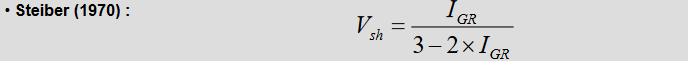

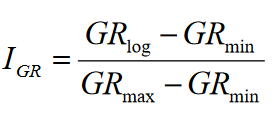

In future, generalized Steiber Model

In [ ]:
X['IGR'] = (X['GR'] - min(X['GR']))/(max(X['GR'] - min(X['GR'])))

In [ ]:
X['Vsh'] = X['IGR']/(3 - 2*X['IGR'])

# **Adding Carbon Index**

In [ ]:
X['Carbon_Index'] = ((154.97/X.RHOB.values)-57.261)

In [ ]:
X.to_csv('/content/drive/My Drive/Colab Notebooks/Feature_Engineered_dataset')

# **Dimensionality Reduction**

In [ ]:
X = pd.read_csv('/content/drive/My Drive/Colab Notebooks/Feature_Engineered_dataset')

## **Removing Features with high collinearity**

In [ ]:
df = X[['DEPTH_MD','RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP','ROP','DRHO','RXO','MUDWEIGHT','RMIC',
       'RDEPgrad', 'GRgrad', 'RMEDgrad', 'DTCgrad', 'RHOBgrad', 'SPgrad','NPHIgrad', 'PEFgrad','ROPgrad','DRHOgrad',
        'RXOgrad','MUDWEIGHTgrad','RMICgrad','RMED_log', 'RDEP_log','IGR', 'Vsh','Carbon_Index','plot_size', 
        'cluster1_prob', 'cluster2_prob','cluster3_prob','LITH_LABEL']]

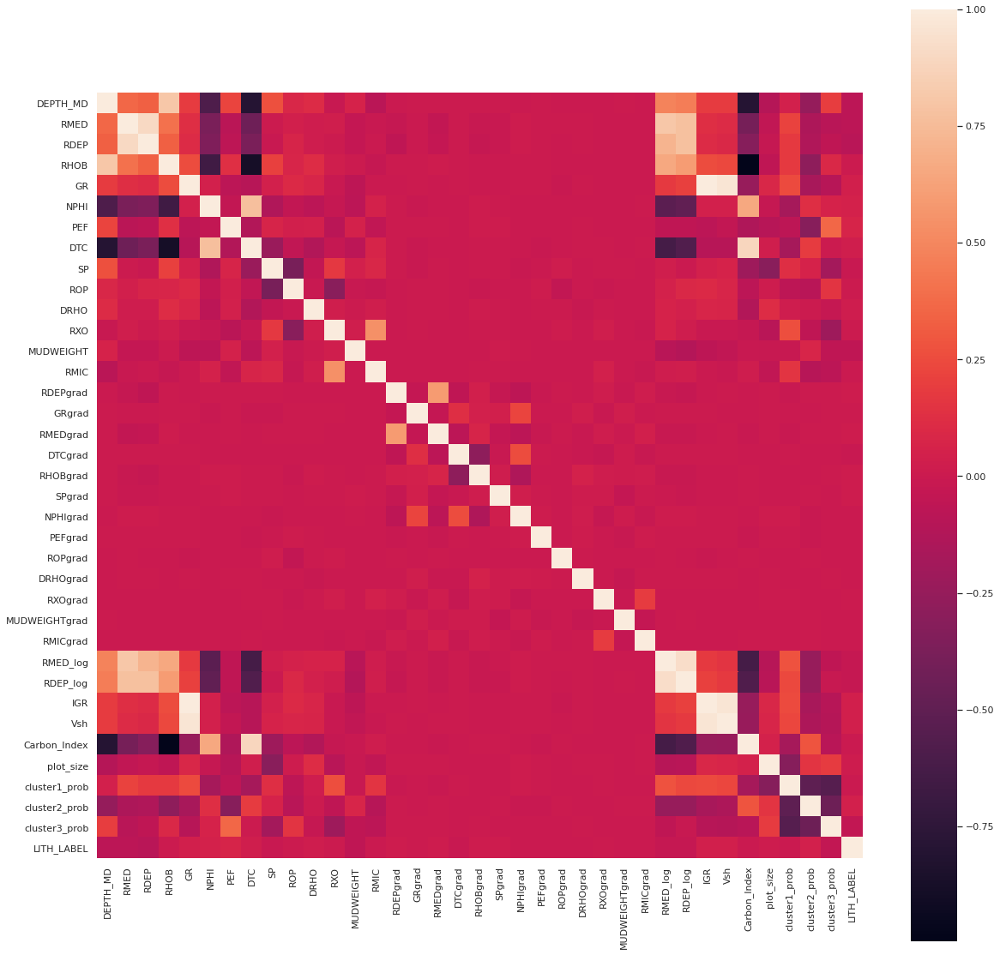

In [ ]:
# Heat Map
C_mat = df.corr()
fig = plt.figure(figsize = (20,20))
sns.heatmap(C_mat, square = True)
plt.show()

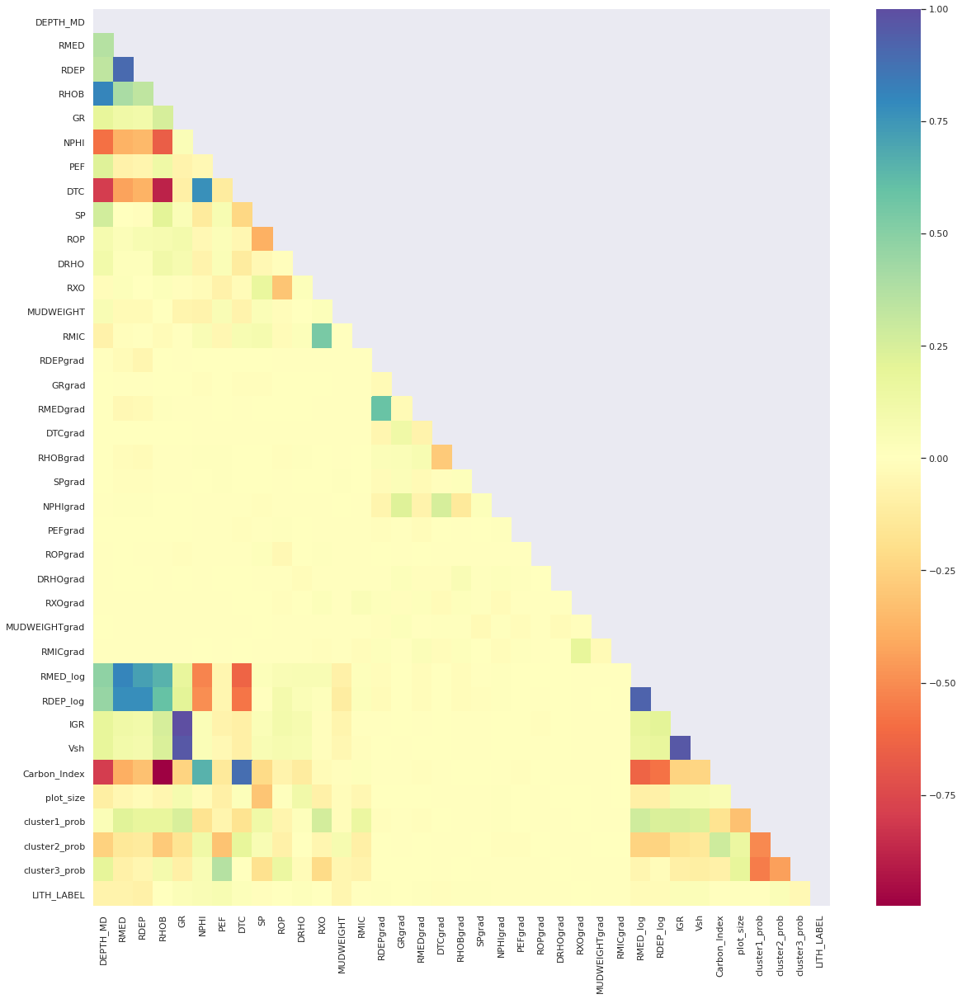

In [ ]:
mask_ut=np.triu(np.ones(C_mat.shape)).astype(np.bool)
fig = plt.figure(figsize = (20,20))
sns.heatmap(C_mat, mask = mask_ut,cmap="Spectral")
plt.show()

In [ ]:
upper_tri = C_mat.where(np.triu(np.ones(C_mat.shape),k=1).astype(np.bool))
to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.90)]
print(to_drop)

['RDEP', 'RDEP_log', 'IGR', 'Vsh']


In [ ]:
df = df.drop(columns = ['RDEP', 'RDEP_log', 'IGR', 'Vsh'])

## **Selecting columns based on p-value**

This is what we are doing in the above code block:

1. We assume to null hypothesis to be “The selected combination of dependent variables do not have any effect on the independent variable”.
2. Then we build a small regression model and calculate the p values.
3. If the p values is higher than the threshold, we   discard that combination of features

https://towardsdatascience.com/feature-selection-correlation-and-p-value-da8921bfb3cf

In [ ]:
selected_columns = df.columns[:-1].values
selected_columns

array(['DEPTH_MD', 'RMED', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP',
       'ROP', 'DRHO', 'RXO', 'MUDWEIGHT', 'RMIC', 'RDEPgrad', 'GRgrad',
       'RMEDgrad', 'DTCgrad', 'RHOBgrad', 'SPgrad', 'NPHIgrad', 'PEFgrad',
       'ROPgrad', 'DRHOgrad', 'RXOgrad', 'MUDWEIGHTgrad', 'RMICgrad',
       'RMED_log', 'Carbon_Index', 'plot_size', 'cluster1_prob',
       'cluster2_prob', 'cluster3_prob'], dtype=object)

In [ ]:
selected_columns = df.columns[:-1].values

import statsmodels.api as sm
def backwardElimination(x, Y, sl, columns):
    numVars = len(x[0])
    for i in range(0, numVars):
        regressor_OLS = sm.OLS(Y, x).fit()
        maxVar = max(regressor_OLS.pvalues).astype(float)
        if maxVar > sl:
            for j in range(0, numVars - i):
                if (regressor_OLS.pvalues[j].astype(float) == maxVar):
                    x = np.delete(x, j, 1)
                    columns = np.delete(columns, j)
                    
    regressor_OLS.summary()
    return x, columns
    
SL = 0.05
x = np.array(df.iloc[:,:-1], dtype=float)
data_modeled, selected_columns = backwardElimination(x, df.iloc[:,-1].values, SL, selected_columns)

In [ ]:
data = pd.DataFrame(data = data_modeled, columns = selected_columns)

In [ ]:
data = pd.concat((data, X[['LITHOLOGY','LITH_LABEL']]), axis =1)
data

,DEPTH_MD,RMED,RHOB,GR,NPHI,PEF,DTC,SP,ROP,DRHO,RXO,MUDWEIGHT,RMIC,RDEPgrad,GRgrad,DTCgrad,RHOBgrad,SPgrad,RXOgrad,RMICgrad,RMED_log,Carbon_Index,plot_size,cluster1_prob,cluster2_prob,cluster3_prob,LITHOLOGY,LITH_LABEL
0,501.3680,1.537338,2.113136,66.860718,0.4101,9.699265,159.920029,25.633387,28.368063,-0.594198,-3.2462,1.0639,2.9378,0.001388,2.719978,0.078552,-0.118282,-0.714262,3.74850,-0.13170,0.430052,16.075491,75.0,0.0,1.0,0.0,Shale,2
1,501.5200,1.515846,2.038500,69.580696,0.4161,4.784140,159.920029,24.919125,28.167427,-0.430848,-1.0006,0.3042,2.9378,0.001388,2.540947,0.007080,-0.037318,-0.527634,1.72455,-0.13170,0.415973,18.760584,75.0,0.0,1.0,0.0,Shale,2
2,501.6720,1.494350,2.028900,70.754158,0.4162,3.837146,159.797791,24.625406,27.966764,-0.220775,-0.6090,0.3016,2.9378,0.001388,1.881897,0.006927,-0.011150,-0.218932,0.34340,-0.13170,0.401691,19.120290,75.0,0.0,1.0,0.0,Shale,2
3,501.8240,1.472905,2.016200,70.754158,0.4163,3.593694,159.552612,24.625406,27.762060,-0.095836,-0.4624,0.2968,2.9378,0.001388,1.138313,0.004654,-0.009350,-0.202389,0.33575,-0.13170,0.387236,19.601414,75.0,0.0,1.0,0.0,Shale,2
4,501.9760,1.446267,2.013600,70.890160,0.4188,3.572812,159.490387,24.619265,27.574333,-0.026934,-0.3480,0.2840,2.9378,0.001388,0.874813,0.004364,-0.008100,-0.202389,0.21910,-0.13170,0.368986,19.700661,75.0,0.0,1.0,0.0,Shale,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
585880,3168.4004,1.251716,2.397462,40.103462,0.1792,5.725667,88.148200,86.960400,27.269981,0.007387,88.7805,0.1755,44.7402,-0.081968,7.463852,1.808800,0.026993,-0.583950,-6.01835,-11.40680,0.224515,7.378186,75.0,0.0,1.0,0.0,Sandstone/Shale,1
585881,3168.5524,1.373446,2.398901,40.103462,0.1747,5.617660,88.052700,86.960400,27.269981,0.008683,87.4106,0.1679,44.7402,-0.081968,7.689165,2.138600,0.027141,-0.735600,-11.00985,-26.53410,0.317323,7.339428,75.0,0.0,1.0,0.0,Sandstone/Shale,1
585882,3168.7044,1.526007,2.408293,40.103462,0.1741,5.617660,87.189300,86.960400,27.269981,0.031453,81.5198,0.1669,44.7402,-0.090185,7.689165,3.875600,0.032616,-3.827900,-11.00985,-28.97130,0.422654,7.087495,75.0,0.0,1.0,0.0,Sandstone,0
585883,3168.8564,2.901400,2.417872,40.103462,0.1608,5.362520,81.837500,86.960400,27.269981,0.031453,81.0798,0.1654,41.6558,-0.120838,11.044750,4.516200,0.034643,-4.372000,-11.00985,-29.58975,1.065193,6.832558,75.0,0.0,1.0,0.0,Sandstone,0


## **Selecting columns based on mutual information**

Mutual information (MI) between two random variables is a non-negative value, which measures the dependency between the variables. It is equal to zero if and only if two random variables are independent, and higher values mean higher dependency.

https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.mutual_info_classif.html

In [ ]:
import sklearn
from sklearn import feature_selection
sklearn.feature_selection.mutual_info_classif(data.iloc[:,:-2].values, data.iloc[:,-2:-1].values, discrete_features='auto', n_neighbors = 12, copy=True, random_state=None)

array([0.10218418, 0.24375688, 0.23612797, 0.29143362, 0.23055991,
       0.21533068, 0.25745269, 0.26223301, 0.32239275, 0.18714684,
       0.28171089, 0.21116015, 0.21984808, 0.23681387, 0.20365655,
       0.19742076, 0.16383088, 0.20202353, 0.17343072, 0.13677522,
       0.24382753, 0.23581243, 0.18877656, 0.02496515, 0.04760865,
       0.03881259])

## **Low Variance Features**

In [ ]:
from sklearn.feature_selection import VarianceThreshold
sel = VarianceThreshold(threshold = 0.005)
sel.fit(data.iloc[:,:-2])

VarianceThreshold(threshold=0.005)

In [ ]:
df = data.iloc[:,:-2].copy()

In [ ]:
df = df.iloc[:, sel.variances_ > 0.005]

In [ ]:
# Cluster Variables have least impact, still keeping them
data = pd.concat((df, X[['WELL','GROUP','FORMATION','FORCE_2020_LITHOFACIES_CONFIDENCE','LITHOLOGY']]), axis = 1)
data

,DEPTH_MD,RMED,RHOB,GR,NPHI,PEF,DTC,SP,ROP,DRHO,RXO,MUDWEIGHT,RMIC,RDEPgrad,GRgrad,DTCgrad,SPgrad,RXOgrad,RMICgrad,RMED_log,Carbon_Index,plot_size,cluster1_prob,cluster2_prob,cluster3_prob,WELL,GROUP,FORMATION,FORCE_2020_LITHOFACIES_CONFIDENCE,LITHOLOGY
0,501.3680,1.537338,2.113136,66.860718,0.4101,9.699265,159.920029,25.633387,28.368063,-0.594198,-3.2462,1.0639,2.9378,0.001388,2.719978,0.078552,-0.714262,3.74850,-0.13170,0.430052,16.075491,75.0,0.0,1.0,0.0,15/9-13,NORDLAND GP.,ZECHSTEIN GP,high,Shale
1,501.5200,1.515846,2.038500,69.580696,0.4161,4.784140,159.920029,24.919125,28.167427,-0.430848,-1.0006,0.3042,2.9378,0.001388,2.540947,0.007080,-0.527634,1.72455,-0.13170,0.415973,18.760584,75.0,0.0,1.0,0.0,15/9-13,NORDLAND GP.,ZECHSTEIN GP,high,Shale
2,501.6720,1.494350,2.028900,70.754158,0.4162,3.837146,159.797791,24.625406,27.966764,-0.220775,-0.6090,0.3016,2.9378,0.001388,1.881897,0.006927,-0.218932,0.34340,-0.13170,0.401691,19.120290,75.0,0.0,1.0,0.0,15/9-13,NORDLAND GP.,ZECHSTEIN GP,high,Shale
3,501.8240,1.472905,2.016200,70.754158,0.4163,3.593694,159.552612,24.625406,27.762060,-0.095836,-0.4624,0.2968,2.9378,0.001388,1.138313,0.004654,-0.202389,0.33575,-0.13170,0.387236,19.601414,75.0,0.0,1.0,0.0,15/9-13,NORDLAND GP.,ZECHSTEIN GP,high,Shale
4,501.9760,1.446267,2.013600,70.890160,0.4188,3.572812,159.490387,24.619265,27.574333,-0.026934,-0.3480,0.2840,2.9378,0.001388,0.874813,0.004364,-0.202389,0.21910,-0.13170,0.368986,19.700661,75.0,0.0,1.0,0.0,15/9-13,NORDLAND GP.,ZECHSTEIN GP,high,Shale
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
585880,3168.4004,1.251716,2.397462,40.103462,0.1792,5.725667,88.148200,86.960400,27.269981,0.007387,88.7805,0.1755,44.7402,-0.081968,7.463852,1.808800,-0.583950,-6.01835,-11.40680,0.224515,7.378186,75.0,0.0,1.0,0.0,7/1-2 S,VESTLAND GP.,BRYNE FM,medium,Sandstone/Shale
585881,3168.5524,1.373446,2.398901,40.103462,0.1747,5.617660,88.052700,86.960400,27.269981,0.008683,87.4106,0.1679,44.7402,-0.081968,7.689165,2.138600,-0.735600,-11.00985,-26.53410,0.317323,7.339428,75.0,0.0,1.0,0.0,7/1-2 S,VESTLAND GP.,BRYNE FM,medium,Sandstone/Shale
585882,3168.7044,1.526007,2.408293,40.103462,0.1741,5.617660,87.189300,86.960400,27.269981,0.031453,81.5198,0.1669,44.7402,-0.090185,7.689165,3.875600,-3.827900,-11.00985,-28.97130,0.422654,7.087495,75.0,0.0,1.0,0.0,7/1-2 S,VESTLAND GP.,BRYNE FM,medium,Sandstone
585883,3168.8564,2.901400,2.417872,40.103462,0.1608,5.362520,81.837500,86.960400,27.269981,0.031453,81.0798,0.1654,41.6558,-0.120838,11.044750,4.516200,-4.372000,-11.00985,-29.58975,1.065193,6.832558,75.0,0.0,1.0,0.0,7/1-2 S,VESTLAND GP.,BRYNE FM,medium,Sandstone


In [ ]:
data.to_csv('/content/drive/My Drive/Colab Notebooks/Dimensionally_Reduced_dataset')

# **Addressing Target Imbalance**

## **Scoring Function**

In [ ]:
A = np.load('/content/drive/My Drive/Colab Notebooks/penalty_matrix.npy')

In [ ]:
def score(y_true, y_pred):
    S = 0.0
    y_true = y_true.astype(int)
    y_pred = y_pred.astype(int)
    for i in range(0, y_true.shape[0]):
        S -= A[y_true[i], y_pred[i]]
    return S/y_true.shape[0]

# **Final Classification Model**

In [ ]:
!pip install pycaret==2.2

     |████████████████████████████████| 256kB 7.1MB/s 
     |████████████████████████████████| 1.6MB 16.3MB/s 
     |████████████████████████████████| 148.9MB 68kB/s 
     |████████████████████████████████| 66.3MB 58kB/s 
     |████████████████████████████████| 266kB 53.1MB/s 
     |████████████████████████████████| 102kB 8.7MB/s 
     |████████████████████████████████| 276kB 48.1MB/s 
     |████████████████████████████████| 6.8MB 46.9MB/s 
     |████████████████████████████████| 13.9MB 269kB/s 
     |████████████████████████████████| 1.8MB 48.4MB/s 
     |████████████████████████████████| 174kB 55.3MB/s 
     |████████████████████████████████| 71kB 9.1MB/s 
     |████████████████████████████████| 3.1MB 44.5MB/s 
     |████████████████████████████████| 604kB 47.8MB/s 
     |████████████████████████████████| 71kB 10.3MB/s 
     |████████████████████████████████| 2.1MB 45.6MB/s 
     |████████████████████████████████| 337kB 42.0MB/s 
     |████████████████████████████████| 81kB 11.8MB/s 

In [ ]:
data = pd.read_csv('/content/drive/My Drive/Colab Notebooks/Dimensionally_Reduced_dataset')
data = data.drop(columns = ['Unnamed: 0'])

In [ ]:
blind_wells = ['30/3-3','30/6-5','31/2-9','15/9-13','16/10-1','33/9-1','34/10-35']

In [ ]:
blind_data = data.loc[data['WELL'].isin(blind_wells)]

In [ ]:
train_data = data.loc[data['WELL'].isin(blind_wells) == False]

In [ ]:
train_data.to_csv('/content/drive/My Drive/Colab Notebooks/final_training_dataset')

In [ ]:
blind_data.to_csv('/content/drive/My Drive/Colab Notebooks/blind_dataset')

In [ ]:
from pycaret.classification import *
exp_reg = setup(data = train_data.drop(columns=['WELL']), ordinal_features = { 'FORCE_2020_LITHOFACIES_CONFIDENCE' : ['low', 'medium', 'high'] }, target = 'LITHOLOGY', data_split_stratify = True, normalize = True#,fix_imbalance = True,bin_numeric_features = ['DEPTH_MD']
                )

,Description,Value
0,session_id,8892
1,Target,LITHOLOGY
2,Target Type,Multiclass
3,Label Encoded,"Anhydrite: 0, Chalk: 1, Coal: 2, Dolomite: 3, ..."
4,Original Data,"(495788, 29)"
5,Missing Values,False
6,Numeric Features,25
7,Categorical Features,3
8,Ordinal Features,True
9,High Cardinality Features,False


In [ ]:
models()

,Name,Reference,Turbo
ID,,,
lr,Logistic Regression,sklearn.linear_model._logistic.LogisticRegression,True
knn,K Neighbors Classifier,sklearn.neighbors._classification.KNeighborsCl...,True
nb,Naive Bayes,sklearn.naive_bayes.GaussianNB,True
dt,Decision Tree Classifier,sklearn.tree._classes.DecisionTreeClassifier,True
svm,SVM - Linear Kernel,sklearn.linear_model._stochastic_gradient.SGDC...,True
rbfsvm,SVM - Radial Kernel,sklearn.svm._classes.SVC,False
gpc,Gaussian Process Classifier,sklearn.gaussian_process._gpc.GaussianProcessC...,False
mlp,MLP Classifier,pycaret.internal.tunable.TunableMLPClassifier,False
ridge,Ridge Classifier,sklearn.linear_model._ridge.RidgeClassifier,True


In [ ]:
%%time
et = create_model('et', class_weight = 'balanced', criterion = 'entropy', fold = 30)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9645,0.9976,0.9059,0.9641,0.9642,0.9367,0.9367
1,0.9630,0.9977,0.8900,0.9628,0.9627,0.9341,0.9341
2,0.9626,0.9968,0.9089,0.9623,0.9623,0.9335,0.9335
3,0.9634,0.9976,0.9074,0.9631,0.9632,0.9349,0.9350
4,0.9652,0.9971,0.8214,0.9648,0.9649,0.9380,0.9380
5,0.9617,0.9965,0.7964,0.9613,0.9614,0.9318,0.9318
6,0.9627,0.9973,0.8032,0.9625,0.9625,0.9338,0.9338
7,0.9602,0.9968,0.9171,0.9600,0.9600,0.9292,0.9292
8,0.9604,0.9970,0.9107,0.9601,0.9602,0.9296,0.9296
9,0.9618,0.9972,0.7946,0.9613,0.9614,0.9319,0.9320


CPU times: user 2min 52s, sys: 2.04 s, total: 2min 54s
Wall time: 47min 21s


In [ ]:
%%time
dt = create_model('dt', class_weight = 'balanced', criterion = 'entropy', fold = 30, n_estimators = 200)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9447,0.9522,0.7919,0.9447,0.9446,0.9016,0.9016
1,0.9432,0.9532,0.8835,0.9432,0.9432,0.8993,0.8993
2,0.9442,0.9546,0.7703,0.9444,0.9442,0.9011,0.9011
3,0.9448,0.9544,0.8901,0.9452,0.9449,0.9021,0.9021
4,0.9415,0.9507,0.8852,0.9413,0.9414,0.8961,0.8961
5,0.9441,0.9527,0.8813,0.9440,0.9440,0.9007,0.9007
6,0.9433,0.9529,0.8961,0.9431,0.9432,0.8994,0.8994
7,0.9425,0.9518,0.7706,0.9423,0.9424,0.8979,0.8979
8,0.9398,0.9502,0.8716,0.9398,0.9398,0.8933,0.8933
9,0.9429,0.9519,0.7782,0.9428,0.9428,0.8984,0.8985


CPU times: user 36 s, sys: 528 ms, total: 36.5 s
Wall time: 13min 29s


In [ ]:
rf = create_model('rf', class_weight = 'balanced', criterion = 'entropy',fold = 30)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9605,0.0000,0.8657,0.9601,0.9600,0.9293,0.9295
1,0.9589,0.0000,0.8119,0.9581,0.9580,0.9263,0.9265
2,0.9613,0.0000,0.8430,0.9610,0.9606,0.9307,0.9309
3,0.9557,0.0000,0.8535,0.9552,0.9550,0.9206,0.9207
4,0.9573,0.0000,0.8489,0.9569,0.9567,0.9238,0.9239
5,0.9634,0.9973,0.8829,0.9632,0.9629,0.9345,0.9347
6,0.9579,0.9967,0.7739,0.9574,0.9573,0.9248,0.9249
7,0.9569,0.9970,0.8737,0.9563,0.9561,0.9228,0.9229
8,0.9559,0.9961,0.7786,0.9554,0.9553,0.9212,0.9213
9,0.9604,0.9970,0.7850,0.9597,0.9598,0.9291,0.9293


In [ ]:
blended = blend_models(estimator_list = [dt,et], method = 'soft', fold = 30)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9448,0.9966,0.7919,0.9448,0.9447,0.9017,0.9017
1,0.9434,0.9966,0.8836,0.9434,0.9433,0.8996,0.8996
2,0.9443,0.9969,0.7708,0.9446,0.9444,0.9014,0.9014
3,0.9449,0.9967,0.8915,0.9454,0.9451,0.9024,0.9025
4,0.9417,0.9963,0.8853,0.9415,0.9415,0.8964,0.8964
5,0.9443,0.9967,0.8815,0.9443,0.9443,0.9011,0.9012
6,0.9437,0.9964,0.8965,0.9436,0.9436,0.9002,0.9002
7,0.9430,0.9957,0.7711,0.9427,0.9428,0.8987,0.8987
8,0.9401,0.9962,0.8718,0.9400,0.9400,0.8938,0.8938
9,0.9431,0.9967,0.7784,0.9431,0.9431,0.8989,0.8989


In [ ]:
save_model(et,'et_model_final')

Transformation Pipeline and Model Succesfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[], target='LITHOLOGY',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_st...
                  ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0,
                                       class_weight='balanced',
                                       criterion='entropy', max_depth=None,
                                       max_features='auto', max

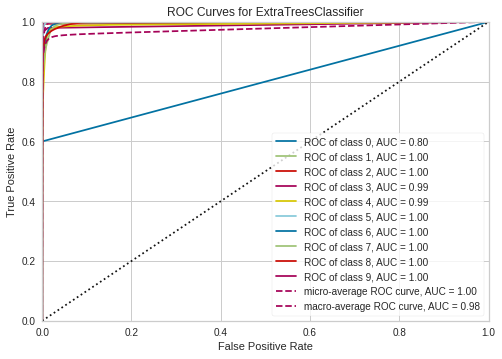

In [ ]:
plot_model(et)

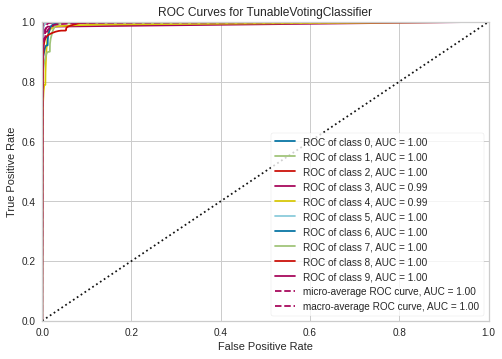

In [ ]:
plot_model(blended)

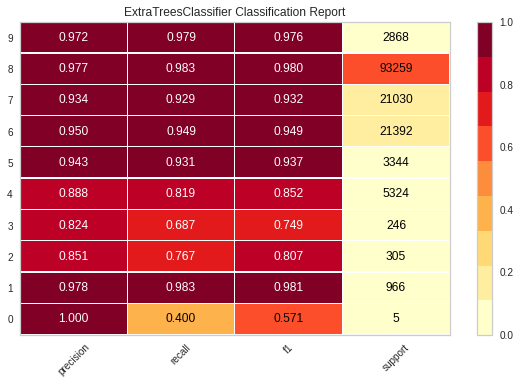

In [ ]:
plot_model(et, plot = 'class_report')

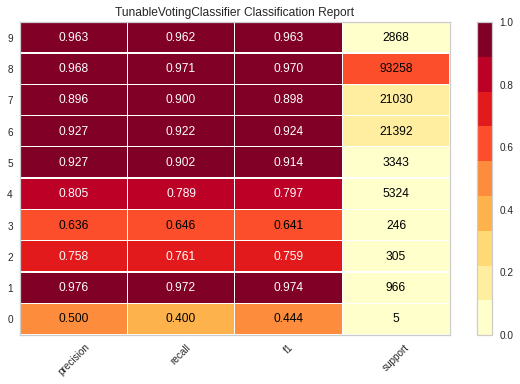

In [ ]:
plot_model(blended, plot = 'class_report')

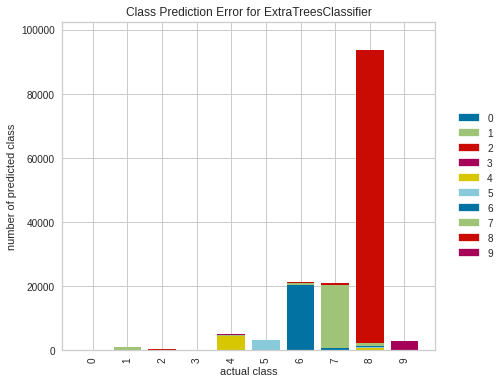

In [ ]:
plot_model(et, plot = 'error')

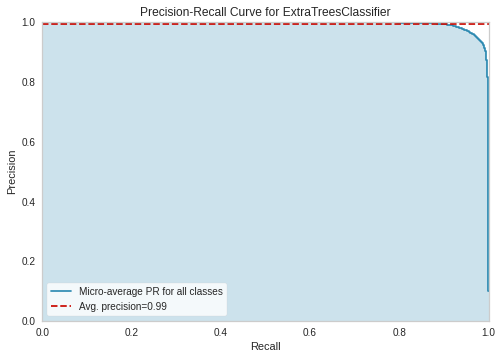

In [ ]:
plot_model(et, plot = 'pr')

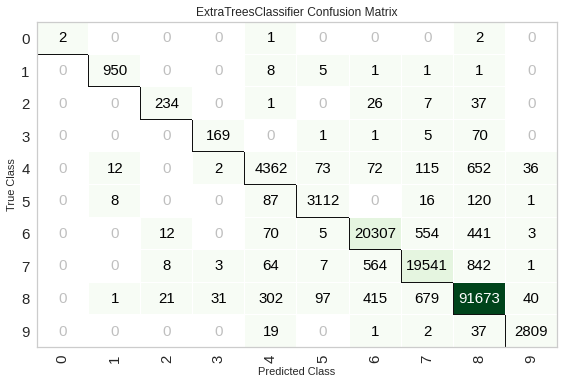

In [ ]:
plot_model(et, plot = 'confusion_matrix')

In [ ]:
save_model(et,'final_et_model')

Transformation Pipeline and Model Succesfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[], target='LITHOLOGY',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_st...
                  ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0,
                                       class_weight='balanced',
                                       criterion='entropy', max_depth=None,
                                       max_features='auto', max

In [ ]:
save_model(rf,'final_rf_model')

Transformation Pipeline and Model Succesfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[], target='LITHOLOGY',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_st...
                  RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                         class_weight='balanced',
                                         criterion='gini', max_depth=None,
                                         max_features='auto',

In [ ]:
final_et_model = load_model('/content/final_et_model')

Transformation Pipeline and Model Successfully Loaded


In [ ]:
final_rf_model = load_model('/content/final_rf_model')

Transformation Pipeline and Model Successfully Loaded


In [ ]:
blind_data = blind_data.reset_index()

In [ ]:
predicted_lithology = predict_model(et, data = blind_data.drop(columns=['index','WELL','LITHOLOGY']))

In [ ]:
predicted_lithology = predict_model(blended, data = blind_data.drop(columns=['index','WELL','LITHOLOGY']))

In [ ]:
predicted_lithology = predict_model(rf, data = blind_data.drop(columns=['index','WELL','LITHOLOGY']))

In [ ]:
predicted_lithology = predict_model(dt, data = blind_data.drop(columns=['index','WELL','LITHOLOGY']))

In [ ]:
predicted_lithology = pd.concat((predicted_lithology,blind_data.WELL),axis=1)

In [ ]:
y = blind_data['LITHOLOGY']
lithology_numbers = {'Sandstone': 0,
                  'Sandstone/Shale': 1,
                  'Shale': 2,
                  'Marl': 3,
                  'Dolomite': 4,
                  'Limestone': 5,
                  'Chalk': 6,
                  'Halite': 7,
                  'Anhydrite': 8,
                  'Tuff': 9,
                  'Coal': 10,
                  'Basement': 11}
y = y.map(lithology_numbers)

In [ ]:
y_pred = predicted_lithology['Label'].map(lithology_numbers)

In [ ]:
score(y.values, y_pred)

-0.7840813234624904

In [ ]:
#predicted_lithology[['DEPTH_MD','WELL','Label']].to_csv('/content/drive/My Drive/Colab Notebooks/Predicted_Lithology (Blind Data)')

#**Visual (Actual Facies vs Predicted)**

https://github.com/brendonhall/FORCE-2020-Lithology/blob/master/notebooks/01-Log-Plot-MPL.ipynb


In [ ]:
blind_data = pd.read_csv('/content/drive/My Drive/Colab Notebooks/blind_dataset')

In [ ]:
Predicted_Lithology = pd.read_csv('/content/drive/My Drive/Colab Notebooks/Predicted_Lithology (Blind Data)')
Actual_Lithology = blind_data[['WELL','DEPTH_MD','RHOB', 'NPHI', 'PEF', 'DTC', 'SP','GR','Vsh','Carbon_Index'
                               , 'DRHO', 'MUDWEIGHT', 'RMIC','LITHOLOGY']]

In [ ]:
Predicted_Lithology = Predicted_Lithology.drop(columns=['Unnamed: 0'])
Predicted_Lithology = Predicted_Lithology.rename(columns={"Label":"LITHOLOGY"})

In [ ]:
# map of lithology codes to integer label for ML
lithology_numbers = {'Sandstone': 0,
                  'Sandstone/Shale': 1,
                  'Shale': 2,
                  'Marl': 3,
                  'Dolomite': 4,
                  'Limestone': 5,
                  'Chalk': 6,
                  'Halite': 7,
                  'Anhydrite': 8,
                  'Tuff': 9,
                  'Coal': 10,
                  'Basement': 11}

def map_lith_key(lith_map, row):
    
    lith_key = row['LITHOLOGY']
    
    if lith_key in lith_map:
        return lith_map[lith_key]
    else:
        print('Warning: Key {} not found in map'.format(lith_key))
        return np.nan

Actual_Lithology['LITH_LABEL'] = Actual_Lithology.apply (lambda row: map_lith_key(lithology_numbers, row), axis=1)
Predicted_Lithology['LITH_LABEL'] = Predicted_Lithology.apply (lambda row: map_lith_key(lithology_numbers, row), axis=1)

In [ ]:
facies_color_map = { 'Sandstone': '#F4D03F',
                     'Sandstone/Shale': '#7ccc19',
                     'Shale': '#196F3D',
                     'Marl': '#160599',
                     'Dolomite': '#2756c4',
                     'Limestone': '#3891f0',
                     'Chalk': '#80d4ff',
                     'Halite': '#87039e',
                     'Anhydrite': '#ec90fc',
                     'Tuff': '#FF4500',
                     'Coal': '#000000',
                     'Basement': '#DC7633'}

# get a list of the color codes.
facies_colors = [facies_color_map[mykey] for mykey in facies_color_map.keys()]

Text(0.5, 0, 'Predicted Facies')

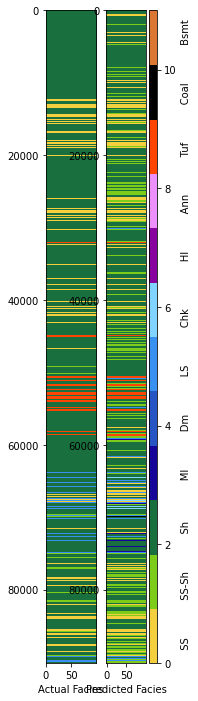

In [ ]:
num_curves = 0

cmap_facies = colors.ListedColormap(facies_colors[0:len(facies_colors)], 'indexed')
logs = Predicted_Lithology.sort_values(by='DEPTH_MD')
logs_1 = Actual_Lithology.sort_values(by='DEPTH_MD')
cluster=np.repeat(np.expand_dims(logs['LITH_LABEL'].values,1), 100, 1)
cluster_1=np.repeat(np.expand_dims(logs_1['LITH_LABEL'].values,1), 100, 1)

f, ax = plt.subplots(nrows=1, ncols=num_curves+2, figsize=(2, 12))

im=ax[num_curves+1].imshow(cluster_1, interpolation='none', aspect='auto',
                    cmap=cmap_facies,vmin=0,vmax=11)
im=ax[num_curves].imshow(cluster, interpolation='none', aspect='auto',
                    cmap=cmap_facies,vmin=0,vmax=11)

divider = make_axes_locatable(ax[num_curves+1])
cax = divider.append_axes("right", size="20%", pad=0.05)
cbar=plt.colorbar(im, cax=cax)
cbar.set_label((12*' ').join(['  SS', 'SS-Sh', 'Sh', 
                                ' Ml', 'Dm', 'LS', 'Chk ', 
                                '  Hl', 'Ann', 'Tuf', 'Coal', 'Bsmt']))
#cbar.set_ticks(range(0,1)); cbar.set_ticklabels('')

ax[num_curves].set_xlabel('Actual Facies')
ax[num_curves+1].set_xlabel('Predicted Facies')

In [ ]:
def make_facies_log_plot(log_df, predicted, curves, facies_colors):
    
    #make sure logs are sorted by depth
    logs = log_df.sort_values(by='DEPTH_MD')
    logs_1 = predicted.sort_values(by='DEPTH_MD')
    cmap_facies = colors.ListedColormap(
            facies_colors[0:len(facies_colors)], 'indexed')
    
    ztop=logs.DEPTH_MD.min(); zbot=logs.DEPTH_MD.max()
    
    cluster=np.repeat(np.expand_dims(logs['LITH_LABEL'].values,1), 100, 1)
    cluster_1=np.repeat(np.expand_dims(logs_1['LITH_LABEL'].values,1), 100, 1)
    
    num_curves = len(curves)
    f, ax = plt.subplots(nrows=1, ncols=num_curves+2, figsize=(num_curves*2, 12))
    
    for ic, col in enumerate(curves):
        
        # if the curve doesn't exist, make it zeros
        if np.all(np.isnan(logs[col])):
            curve = np.empty(logs[col].values.shape)
            curve[:] = np.nan
            
        else:
            curve = logs[col]
            
        ax[ic].plot(curve, logs['DEPTH_MD'])
        ax[ic].set_xlabel(col)
        ax[ic].set_yticklabels([]);

    # make the lithfacies column
    im=ax[num_curves].imshow(cluster, interpolation='none', aspect='auto',
                    cmap=cmap_facies,vmin=0,vmax=11)
    im=ax[num_curves+1].imshow(cluster_1, interpolation='none', aspect='auto',
                    cmap=cmap_facies,vmin=0,vmax=11)
    
    divider = make_axes_locatable(ax[num_curves+1])
    cax = divider.append_axes("right", size="20%", pad=0.05)
    cbar=plt.colorbar(im, cax=cax)
    cbar.set_label((12*' ').join(['  SS', 'SS-Sh', 'Sh', 
                                ' Ml', 'Dm', 'LS', 'Chk ', 
                                '  Hl', 'Ann', 'Tuf', 'Coal', 'Bsmt']))
    cbar.set_ticks(range(0,1)); cbar.set_ticklabels('')
    
    for i in range(len(ax)-2):
        ax[i].set_ylim(ztop,zbot)
        ax[i].invert_yaxis()
        ax[i].grid()
        ax[i].locator_params(axis='x')

    ax[num_curves].set_xlabel('Actual Facies')
    ax[num_curves+1].set_xlabel('Predicted Facies')
    ax[num_curves].set_yticklabels([])
    ax[num_curves].set_xticklabels([])
    
    f.suptitle('Well: %s'%logs.iloc[0]['WELL'], fontsize=14,y=0.94)
    
    plt.show()

In [ ]:
import ipywidgets as widgets
from ipywidgets import interactive, interact

columns = ['RHOB', 'NPHI', 'PEF', 'DTC', 'SP','GR','Vsh','Carbon_Index'
                               , 'DRHO', 'MUDWEIGHT', 'RMIC']

plot_output = widgets.Output()

dropdown_well = widgets.Dropdown(options = Actual_Lithology['WELL'].unique(), description='Well:', value='16/10-1')

select_curves = widgets.SelectMultiple(
    options=columns,
    value=columns,
    #rows=10,
    description='Curves:',
    disabled=False
)

plot_button = widgets.Button(
    description='Show well plot',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='Click to plot well.'
)
        
def on_button_clicked(b):
    plot_output.clear_output()
    with plot_output:
        make_facies_log_plot(
            Actual_Lithology[Actual_Lithology['WELL'] == dropdown_well.value],
            Predicted_Lithology[Predicted_Lithology['WELL'] == dropdown_well.value], 
            select_curves.value,
            facies_colors)
        
plot_button.on_click(on_button_clicked)

display(dropdown_well)
display(select_curves)
display(plot_button)
display(plot_output)

Dropdown(description='Well:', index=1, options=('15/9-13', '16/10-1', '30/3-3', '30/6-5', '31/2-9', '33/9-1', …

SelectMultiple(description='Curves:', index=(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10), options=('RHOB', 'NPHI', 'PEF'…

Button(description='Show well plot', style=ButtonStyle(), tooltip='Click to plot well.')

Output()